In [4]:
import pandas as pd
from matplotlib import pyplot as plt
import numpy as np
from scipy.io import mmread
import sys
from anndata import AnnData
import scanpy as sc
import importlib
from collections import defaultdict, Counter
import json
import seaborn as sns
from scipy.stats import chisquare, spearmanr, pearsonr
from statsmodels.stats.multitest import multipletests
import warnings
import os
from os.path import join

sys.path.append('..')
sys.path.append('../../spatialcorr')

import spatialcorr

RESULTS_ROOT = './results'

warnings.simplefilter(action='ignore', category=FutureWarning)

In [2]:
def plot_gene(gene, ad, log=False, cmap='viridis', ax=None, figure=None, title=None, dsize=10):
    if log:
        expr = np.log(ad.obs_vector(gene))
    else:
        expr = ad.obs_vector(gene)
    llrtp.plot_slide(
        ad.obs, 
        expr, 
        cmap=cmap, 
        title=title,
        dsize=dsize,
        ax=ax,
        figure=figure
    )
    plt.title(gene)
    plt.show()
    
def plot_cluster_scatter(g1, g2, clust, col_vals=None, cmap=None, color=None, xlim=None, ylim=None):
    fig, ax = plt.subplots(1,1, figsize=(3, 3)) 
    ct_to_inds = defaultdict(lambda: [])
    for ind, ct in enumerate(adata.obs['BayesSpace_11']):
        ct_to_inds[ct].append(ind)
    expr_1 = adata.obs_vector(g1)[ct_to_inds[clust]]
    expr_2 = adata.obs_vector(g2)[ct_to_inds[clust]]
    if col_vals is not None:
        scatter_kws = {
            'color': None,
            'c': col_vals[ct_to_inds[clust]],
            'cmap': cmap,
            'alpha': 1.0
        }
        sns.regplot(expr_1, expr_2, scatter_kws=scatter_kws)        
    elif color is not None:
        scatter_kws = {
            'color': color,
            's': 5
        }
        sns.regplot(expr_1, expr_2, scatter_kws=scatter_kws, ax=ax) 
        #sns.kdeplot(expr_1, expr_2, scatter_kws=scatter_kws, ax=ax) 
    else:
        sns.regplot(expr_1, expr_2)#, s=4)
    #plt.show()
    plt.xlabel(f'{g1} Expression')
    plt.ylabel(f'{g2} Expression')
    
    if xlim:
        plt.xlim(xlim)
    if ylim:
        plt.ylim(ylim)


    
def plot_cluster_mvn(g1, g2, clust, col_vals=None, cmap=None, xlim=None, ylim=None):
    
    
    ct_to_inds = defaultdict(lambda: [])
    for ind, ct in enumerate(adata.obs['BayesSpace_11']):
        ct_to_inds[ct].append(ind)
    expr_1 = adata.obs_vector(g1)[ct_to_inds[clust]]
    expr_2 = adata.obs_vector(g2)[ct_to_inds[clust]]
    X = np.array([expr_1, expr_2])
    mean = np.mean(X, axis=1)
    cov = np.cov(X)
    
    fig, ax = plt.subplots(1,1, figsize=(5,5))

    v, w = np.linalg.eigh(cov)
    v = 2. * np.sqrt(2.) * np.sqrt(v)
    u = w[0] / np.linalg.norm(w[0])

    ax.scatter(X[0, :], X[1, :], .8, color='black')
    #ax.scatter([the_x[0]], [the_x[1]], 5., color='red')
    # Plot an ellipse to show the Gaussian component
    angle = np.arctan(u[1] / u[0])
    angle = 180. * angle / np.pi  # convert to degrees
    ell = mpl.patches.Ellipse(mean, v[0], v[1], 180. + angle, color='blue')
    ell.set_clip_box(ax.bbox)
    ell.set_alpha(0.2)
    ax.add_artist(ell)
    
    plt.xlabel(f'{g1} Expression')
    plt.ylabel(f'{g2} Expression')
    
    if xlim:
        plt.xlim(xlim)
    if ylim:
        plt.ylim(ylim)

######### TODO MOVE THIS INTO THE SPATIALCORR PACKAGE
def _map_row_col_to_barcode(df):
    """
    Map each row, column pair to its barcode.
    """
    row_to_col_to_bc = defaultdict(lambda: {})
    for ri, row in df.iterrows():
        r = row['row']
        c = row['col']
        b = row.name
        row_to_col_to_bc[r][c] = b
    return row_to_col_to_bc

def compute_spotwise_significance(df, spot_p_vals):
    df = df.copy()
    df['tissue'] = [1 for i in range(df.shape[0])]

    row_col_to_barcode = _map_row_col_to_barcode(df)
    
    print('Mapping each barcode to its neighbors...')
    bc_to_neighs, bc_to_above_neighs, bc_to_below_neighs = map_neighbors._map_coords_to_neighbors(
        df, 
        row_col_to_barcode,
        row_key='row',
        col_key='col'
    )
    print('done.')
    
    bc_to_plot_index = {
        bc: index
        for index, bc in enumerate(df.index)
    }
    cs_pvals = []
    for bc_i, bc in enumerate(df.index):
        neighs = bc_to_neighs[bc]
        neigh_inds = [bc_to_plot_index[neigh] for neigh in neighs]
        neigh_p_vals = np.array(spot_p_vals)[neigh_inds]
        intervals = [0.25, 0.5, 0.75, 1.0]
        interval_counts = [0,0,0,0]
        for p_val in neigh_p_vals:
            for int_i in range(len(intervals)):
                if p_val <= intervals[int_i]:
                    interval_counts[int_i] += 1
                    break
        _, cs_pval = chisquare(interval_counts)
        cs_pvals.append(cs_pval)
    return cs_pvals


In [5]:
df_meta = pd.read_csv('~/Development/spatial_transcriptomics/GSE144239/GSM4284317_P2_rep2_data/row_data.csv', index_col=0)
#df_meta.columns = ['barcode', 'tissue', 'row', 'col', 'imgrow', 'imgcol']
#df_meta = df_meta.set_index('barcode')
df_meta['tissue'] = np.full(df_meta.shape[0], 1)
df_meta

,row,col,tissue
10x16,16,10,1
10x18,18,10,1
10x20,20,10,1
10x22,22,10,1
10x24,24,10,1
...,...,...,...
9x29,29,9,1
9x31,31,9,1
9x33,33,9,1
9x35,35,9,1


In [6]:
df_counts = pd.read_csv('~/Development/spatial_transcriptomics/GSE144239/GSM4284317_P2_rep2_data/GSM4284317_P2_ST_rep2_stdata.filtered.tsv', index_col=0, sep='\t')
df_counts

,RP11-34P13.7,FO538757.1,AP006222.2,RP4-669L17.10,RP11-206L10.9,SAMD11,NOC2L,KLHL17,PLEKHN1,PERM1,...,PRORY,DAZ1,DAZ2,AC012005.2,AC012005.1,DAZ3,DAZ4,AC006386.1,LINC00266-4P,AC006328.1
10x16,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,2.0,0.0,0.0,1.0,0.0,0.0
10x18,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,3.0,0.0,0.0,2.0,0.0,0.0
10x20,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,2.0,0.0,0.0,1.0,0.0,0.0
10x22,0.0,3.0,0.0,0.0,0.0,0.0,2.0,2.0,1.0,0.0,...,0.0,0.0,0.0,0.0,9.0,0.0,0.0,5.0,0.0,0.0
10x24,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,3.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9x29,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
9x31,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
9x33,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9x35,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


### Filter tissue spots

In [7]:
total_counts = np.sum(df_counts, axis=1)
df_meta['total_umi_count'] = total_counts
df_meta = df_meta.loc[df_meta['total_umi_count'] > 100]
df_counts = df_counts.loc[df_meta.index]

assert df_counts.shape[0] == df_meta.shape[0]

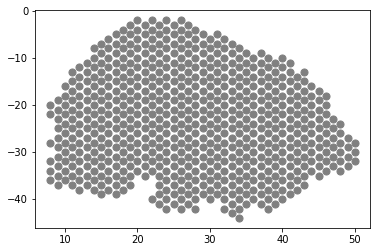

In [8]:
y = -1 * np.array(df_meta['row'])
x = df_meta['col']
fig = plt.gcf()
plt.scatter(x,y,c='grey', s=50)
plt.show()

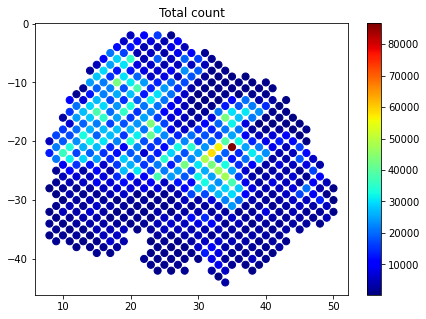

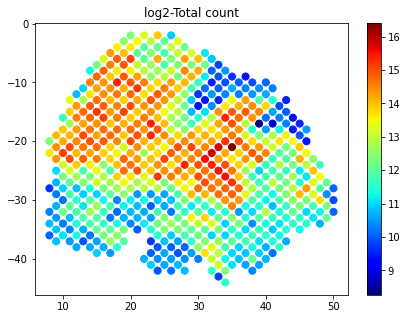

In [9]:
total_counts = np.sum(df_counts, axis=1)
spatialcorr.plot_slide(
    df_meta, 
    total_counts, 
    cmap='jet',
    colorbar=True,
    title="Total count",
    dsize=50
)

spatialcorr.plot_slide(
    df_meta, 
    np.log2(total_counts), 
    cmap='jet',
    colorbar=True,
    title="log2-Total count",
    dsize=50
)

In [10]:
df_dino = pd.read_csv('~/Development/spatial_transcriptomics/GSE144239/GSM4284317_P2_rep2_data/GSM4284317_P2_ST_rep2_stdata.filtered.dino.tsv.gz', sep='\t', index_col=0)
df_dino = df_dino.transpose()
df_dino.index = [x[1:] for x in df_dino.index]
df_dino = df_dino.loc[df_meta.index]
df_dino

,RP11.34P13.7,FO538757.1,AP006222.2,RP4.669L17.10,RP11.206L10.9,SAMD11,NOC2L,KLHL17,PLEKHN1,PERM1,...,PRORY,DAZ1,DAZ2,AC012005.2,AC012005.1,DAZ3,DAZ4,AC006386.1,LINC00266.4P,AC006328.1
10x16,0.0,0.558,0.0,0.0,0.0,0.000,0.208,0.070,0.038,0.0,...,0.0,0.0,0.0,0.0,2.453,0.0,0.0,1.972,0.0,0.0
10x18,0.0,0.346,0.0,0.0,0.0,0.112,0.486,0.000,0.102,0.0,...,0.0,0.0,0.0,0.0,0.988,0.0,0.0,0.814,0.0,0.0
10x20,0.0,0.135,0.0,0.0,0.0,0.025,0.199,0.091,0.008,0.0,...,0.0,0.0,0.0,0.0,0.625,0.0,0.0,0.427,0.0,0.0
10x22,0.0,0.406,0.0,0.0,0.0,0.023,0.243,0.270,0.207,0.0,...,0.0,0.0,0.0,0.0,1.381,0.0,0.0,0.685,0.0,0.0
10x24,0.0,0.295,0.0,0.0,0.0,0.036,0.330,0.039,0.092,0.0,...,0.0,0.0,0.0,0.0,0.626,0.0,0.0,1.603,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9x29,0.0,0.246,0.0,0.0,0.0,0.008,0.407,0.120,0.000,0.0,...,0.0,0.0,0.0,0.0,2.484,0.0,0.0,0.613,0.0,0.0
9x31,0.0,0.178,0.0,0.0,0.0,0.035,0.309,0.080,0.951,0.0,...,0.0,0.0,0.0,0.0,2.107,0.0,0.0,1.373,0.0,0.0
9x33,0.0,0.173,0.0,0.0,0.0,0.026,0.278,0.139,0.285,0.0,...,0.0,0.0,0.0,0.0,1.144,0.0,0.0,0.369,0.0,0.0
9x35,0.0,0.438,0.0,0.0,0.0,0.000,0.374,0.117,0.197,0.0,...,0.0,0.0,0.0,0.0,0.257,0.0,0.0,1.760,0.0,0.0


In [15]:
df_bayes_11 = pd.read_csv('~/Development/spatial_transcriptomics/GSE144239/GSM4284317_P2_rep2_data/BayesSpace_output.8_clusts.tsv', sep='\t', index_col=0)
df_bayes_11 = df_bayes_11.loc[df_meta.index]
#df_meta['BayesSpace_11'] = [str(x) for x in df_bayes_11['spatial.cluster']]
new_clusts = []
for clust in df_bayes_11['spatial.cluster']:
    if clust == 11:
        new_clusts.append(10)
    else:
        new_clusts.append(clust)
df_meta['BayesSpace'] = new_clusts
df_bayes_11

/Users/matthewbernstein/Development/python3_dev/lib/python3.7/site-packages/ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.


,row,col,sizeFactor,cluster.init,spatial.cluster
10x16,16,10,0.296356,4,2
10x18,18,10,1.430728,2,2
10x20,20,10,1.681463,2,2
10x22,22,10,3.316219,2,2
10x24,24,10,0.838016,5,5
...,...,...,...,...,...
9x29,29,9,0.110342,3,3
9x31,31,9,0.152613,3,3
9x33,33,9,0.131885,1,3
9x35,35,9,0.170174,3,3


In [12]:
adata = AnnData(df_dino)
adata.obs = df_meta
adata

AnnData object with n_obs × n_vars = 645 × 17344
    obs: 'row', 'col', 'tissue', 'total_umi_count', 'BayesSpace_11'

### GO term analysis results

BHR-Test
['GO_POSITIVE_REGULATION_OF_RELEASE_OF_SEQUESTERED_CALCIUM_ION_INTO_CYTOSOL', 0.0001, 0.00308421052631579]
['GO_POSITIVE_REGULATION_OF_CALCIUM_ION_TRANSMEMBRANE_TRANSPORT', 0.0001, 0.00308421052631579]
['GO_POSITIVE_REGULATION_OF_CALCIUM_ION_TRANSPORT_INTO_CYTOSOL', 0.0001, 0.00308421052631579]
['GO_REGULATION_OF_RELEASE_OF_SEQUESTERED_CALCIUM_ION_INTO_CYTOSOL', 0.0001, 0.00308421052631579]
['GO_REGULATION_OF_CELL_DEATH', 0.0001, 0.00308421052631579]
['GO_REGULATION_OF_EPIDERMIS_DEVELOPMENT', 0.0001, 0.00308421052631579]
['GO_POSITIVE_REGULATION_OF_EPIDERMIS_DEVELOPMENT', 0.0001, 0.00308421052631579]
['GO_EPIDERMIS_DEVELOPMENT', 0.0001, 0.00308421052631579]
['GO_EPITHELIAL_CELL_DEVELOPMENT', 0.0001, 0.00308421052631579]
['GO_EPITHELIAL_CELL_DIFFERENTIATION', 0.0001, 0.00308421052631579]
['GO_POSITIVE_REGULATION_OF_CELL_CELL_ADHESION', 0.0001, 0.00308421052631579]
['GO_HOMOTYPIC_CELL_CELL_ADHESION', 0.0001, 0.00308421052631579]
['GO_CELL_CELL_ADHESION_VIA_PLASMA_MEMBRANE_ADHESI

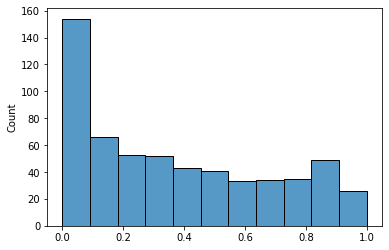

In [9]:
with open(join(RESULTS_ROOT, 'ANGIOGENESIS.BHR.json'), 'r') as f:
    j_angiogenesis_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'APOPTOSIS.BHR.json'), 'r') as f:
    j_apoptosis_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'B_CELL.BHR.json'), 'r') as f:
    j_b_cell_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'CALCIUM.BHR.json'), 'r') as f:
    j_calcium_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'CELL_DEATH.BHR.json'), 'r') as f:
    j_cell_death_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'CELL_CYCLE.BHR.json'), 'r') as f:
    j_cell_cycle_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'CELL_DIVISION.BHR.json'), 'r') as f:
    j_cell_division_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'DNA_REPAIR.BHR.json'), 'r') as f:
    j_dna_repair_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'DNA_REPLICATION.BHR.json'), 'r') as f:
    j_dna_replication_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'EPIDERMIS_DEVELOPMENT.BHR.json'), 'r') as f:
    j_epidermis_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'EPITHELIAL.BHR.json'), 'r') as f:
    j_epithelial_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'FIBROBLAST.BHR.json'), 'r') as f:
    j_fibroblast_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'CELL_CELL_ADHESION.BHR.json'), 'r') as f:
    j_cell_cell_adhesion_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'KERATINOCYTE.BHR.json'), 'r') as f:
    j_keratinocyte_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'HYPOXIA.BHR.json'), 'r') as f:
    j_hypoxia_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'INTERFERON.BHR.json'), 'r') as f:
    j_interferon_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'INTERLEUKIN_RELATED.BHR.json'), 'r') as f:
    j_interleukin_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'MATRIX.BHR.json'), 'r') as f:
    j_matrix_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'MIGRATION.BHR.json'), 'r') as f:
    j_migration_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'T_CELL.BHR.json'), 'r') as f:
    j_t_cell_bhr = json.load(f)
    
res_l = [
    j_angiogenesis_bhr,
    j_apoptosis_bhr,
    j_b_cell_bhr,
    j_calcium_bhr,
    j_cell_cycle_bhr,
    j_cell_death_bhr,
    j_cell_division_bhr,
    j_dna_repair_bhr,
    j_dna_replication_bhr,
    j_epidermis_bhr,
    j_epithelial_bhr,
    j_fibroblast_bhr,
    j_cell_cell_adhesion_bhr,
    j_keratinocyte_bhr,
    j_hypoxia_bhr,
    j_interferon_bhr,
    j_interleukin_bhr,
    j_matrix_bhr,
    j_migration_bhr,
    j_t_cell_bhr
]
bhr_results = []
for res in res_l:
    bhr_results += res['gene_set_to_pval'].items()
    
print("BHR-Test")
gs_bhr_p_vals = [x[1] for x in bhr_results]
gs_bhr_p_vals_fdr, gs_bhr_p_vals_adj, _, _ = multipletests(
    gs_bhr_p_vals, 
    method='fdr_bh',
    alpha=0.05
)
bhr_results = [list(x) for x in bhr_results]
for adj, res in zip(gs_bhr_p_vals_adj, bhr_results):
    res.append(adj)
print('\n'.join(map(str, sorted(bhr_results, key=lambda x: x[1])[:50])))
print(Counter(gs_bhr_p_vals_fdr))
sns.histplot(gs_bhr_p_vals)
plt.show()

WHR-Test
['GO_REGULATION_OF_EPIDERMIS_DEVELOPMENT', 0.0001, 0.01172]
['GO_EPIDERMIS_DEVELOPMENT', 0.0001, 0.01172]
['GO_EPITHELIAL_CELL_DIFFERENTIATION', 0.0001, 0.01172]
['GO_CELL_CELL_ADHESION', 0.0001, 0.01172]
['GO_KERATINOCYTE_DIFFERENTIATION', 0.0001, 0.01172]
['GO_AMEBOIDAL_TYPE_CELL_MIGRATION', 0.0002, 0.019533333333333337]
['GO_KERATINOCYTE_DEVELOPMENT', 0.0005, 0.036625]
['GO_TISSUE_MIGRATION', 0.0005, 0.036625]
['GO_REGULATION_OF_ENDOTHELIAL_CELL_MIGRATION', 0.0012, 0.07813333333333333]
['GO_POSITIVE_REGULATION_OF_CALCIUM_ION_IMPORT', 0.01238390092879257, 0.6362303892296836]
['GO_REGULATION_OF_EPITHELIAL_CELL_MIGRATION', 0.01287001287001287, 0.6362303892296836]
['GO_REGULATION_OF_CALCIUM_ION_IMPORT', 0.013175230566534914, 0.6362303892296836]
['GO_MYELOID_LEUKOCYTE_MIGRATION', 0.014114326040931546, 0.6362303892296836]
['GO_REGULATION_OF_EPITHELIAL_CELL_MIGRATION', 0.01892147587511826, 0.791998918772807]
['GO_APOPTOTIC_SIGNALING_PATHWAY', 0.02336448598130841, 0.912772585669781

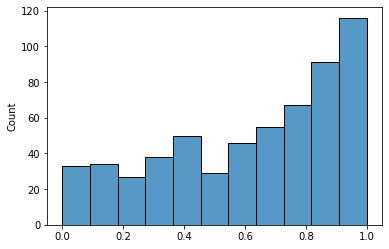

In [12]:
with open(join(RESULTS_ROOT, 'ANGIOGENESIS.WHR.json'), 'r') as f:
    j_angiogenesis_whr = json.load(f)
with open(join(RESULTS_ROOT, 'APOPTOSIS.WHR.json'), 'r') as f:
    j_apoptosis_whr = json.load(f)
with open(join(RESULTS_ROOT, 'B_CELL.WHR.json'), 'r') as f:
    j_b_cell_whr = json.load(f)
with open(join(RESULTS_ROOT, 'CALCIUM.WHR.json'), 'r') as f:
    j_calcium_whr = json.load(f)
with open(join(RESULTS_ROOT, 'CELL_CYCLE.WHR.json'), 'r') as f:
    j_cell_cycle_whr = json.load(f)
with open(join(RESULTS_ROOT, 'CELL_DEATH.WHR.json'), 'r') as f:
    j_cell_death_whr = json.load(f)
with open(join(RESULTS_ROOT, 'CELL_DIVISION.WHR.json'), 'r') as f:
    j_cell_division_whr = json.load(f)
with open(join(RESULTS_ROOT, 'DNA_REPAIR.WHR.json'), 'r') as f:
    j_dna_repair_whr = json.load(f)
with open(join(RESULTS_ROOT, 'DNA_REPLICATION.WHR.json'), 'r') as f:
    j_dna_replication_whr = json.load(f)
with open(join(RESULTS_ROOT, 'EPIDERMIS_DEVELOPMENT.WHR.json'), 'r') as f:
    j_epidermis_whr = json.load(f)
with open(join(RESULTS_ROOT, 'EPITHELIAL.WHR.json'), 'r') as f:
    j_epithelial_whr = json.load(f)
with open(join(RESULTS_ROOT, 'FIBROBLAST.WHR.json'), 'r') as f:
    j_fibroblast_whr = json.load(f)
with open(join(RESULTS_ROOT, 'CELL_CELL_ADHESION.WHR.json'), 'r') as f:
    j_cell_cell_adhesion_whr = json.load(f)
with open(join(RESULTS_ROOT, 'KERATINOCYTE.WHR.json'), 'r') as f:
    j_keratinocyte_whr = json.load(f)
with open(join(RESULTS_ROOT, 'HYPOXIA.WHR.json'), 'r') as f:
    j_hypoxia_whr = json.load(f)
with open(join(RESULTS_ROOT, 'INTERFERON.WHR.json'), 'r') as f:
    j_interferon_whr = json.load(f)
with open(join(RESULTS_ROOT, 'INTERLEUKIN_RELATED.WHR.json'), 'r') as f:
    j_interleukin_whr = json.load(f)
with open(join(RESULTS_ROOT, 'MATRIX.WHR.json'), 'r') as f:
    j_matrix_whr = json.load(f)
with open(join(RESULTS_ROOT, 'MIGRATION.WHR.json'), 'r') as f:
    j_migration_whr = json.load(f)
with open(join(RESULTS_ROOT, 'T_CELL.WHR.json'), 'r') as f:
    j_t_cell_whr = json.load(f)
    
res_l = [
    j_angiogenesis_whr,
    j_apoptosis_whr,
    j_b_cell_whr,
    j_calcium_whr,
    j_cell_cycle_whr,
    j_cell_death_whr,
    j_cell_division_whr,
    j_dna_repair_whr,
    j_dna_replication_whr,
    j_epidermis_whr,
    j_epithelial_whr,
    j_fibroblast_whr,
    j_cell_cell_adhesion_whr,
    j_keratinocyte_whr,
    j_hypoxia_whr,
    j_interferon_whr,
    j_interleukin_whr,
    j_matrix_whr,
    j_migration_whr,
    j_t_cell_whr
]
whr_results = []
for res in res_l:
    whr_results += res['gene_set_to_pval'].items()
    
gs_to_genes = {}
for res in res_l:
    gs_to_genes.update(res['gene_set_to_genes'])
    
print("WHR-Test")
gs_whr_p_vals = [x[1] for x in whr_results]

gs_whr_p_vals_fdr, gs_whr_p_vals_adj, _, _ = multipletests(
    gs_whr_p_vals, 
    method='fdr_bh',
    alpha=0.05
)
whr_results = [list(x) for x in whr_results]
for adj, res in zip(gs_whr_p_vals_adj, whr_results):
    res.append(adj)

print('\n'.join(map(str, sorted(whr_results, key=lambda x: x[1])[:20])))
print(Counter(gs_whr_p_vals_fdr))
sns.histplot(gs_whr_p_vals)
plt.show()

In [21]:
print(', '.join(gs_to_genes['GO_KERATINOCYTE_DIFFERENTIATION']))
print(', '.join(gs_to_genes['GO_POSITIVE_REGULATION_OF_CALCIUM_ION_TRANSMEMBRANE_TRANSPORT']))
print(', '.join(gs_to_genes['GO_REGULATION_OF_CELL_DEATH']))
print(', '.join(gs_to_genes['GO_POSITIVE_REGULATION_OF_CELL_CELL_ADHESION']))
print(', '.join(gs_to_genes['GO_CELL_MATRIX_ADHESION']))

CSTA, JUP, KRT1, KRT10, KRT14, KRT16, KRT17, KRT5, KRT6A, KRT6B, KRT6C, PERP, S100A7, SFN, SPRR1B
ABL1, ATP1B1, CALM1, CALM2, CALM3, CXCL10, CXCL9, G6PD, GSTO1, HSPA2, HTT, SRI, STIM1, SUMO1, THY1
CFL1, ENO1, GSTP1, LDHA, PERP, RACK1, RPL11, RPS27A, RPS3, RPS6, S100A8, S100A9, SFN, TPT1, UBA52
CSTA, FABP5, KRT1, KRT10, KRT14, KRT16, KRT17, KRT5, KRT6A, KRT6B, KRT6C, PERP, S100A7, SFN, SPRR1B
ACTN1, CD44, CD63, COL17A1, COL3A1, CTNNB1, FN1, ITGA6, ITGB5, JUP, LYPD3, RAC1, RHOA, S100A10, THY1


In [23]:
print(', '.join(gs_to_genes['GO_KERATINOCYTE_DIFFERENTIATION']))
print(', '.join(gs_to_genes['GO_CELL_CELL_ADHESION']))
print(', '.join(gs_to_genes['GO_REGULATION_OF_EPIDERMIS_DEVELOPMENT']))
print(', '.join(gs_to_genes['GO_EPIDERMIS_DEVELOPMENT']))
print(', '.join(gs_to_genes['GO_EPITHELIAL_CELL_DIFFERENTIATION']))

CSTA, JUP, KRT1, KRT10, KRT14, KRT16, KRT17, KRT5, KRT6A, KRT6B, KRT6C, PERP, S100A7, SFN, SPRR1B
ACTB, ACTG1, ANXA1, ANXA2, CD74, CSTA, DSP, GNAS, JUP, LGALS7B, PERP, RPS3, S100A11, S100A8, S100A9
AQP3, CDH3, CDSN, CTNNB1, CTSK, HES1, KRT10, KRT17, KRT2, RUNX1, SERPINB13, SFN, SPINK5, TP63, ZFP36L1
CSTA, FABP5, KRT1, KRT10, KRT14, KRT16, KRT17, KRT5, KRT6A, KRT6B, KRT6C, PERP, S100A7, SFN, SPRR1B
CSTA, JUP, KRT1, KRT10, KRT14, KRT16, KRT17, KRT5, KRT6A, KRT6B, KRT6C, PERP, S100A7, SFN, SPRR1B


### Create plots

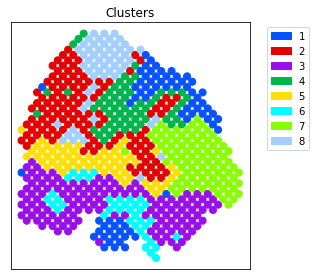

In [18]:
fig, ax = plt.subplots(1,1, figsize=(4.5, 4))
spatialcorr.plot_slide(
    adata.obs, 
    adata.obs['BayesSpace'], 
    cmap='categorical', 
    title="Clusters",
    dsize=50,
    colorbar=True,
    ticks=False,
    figure=fig,
    ax=ax
)

plt.tight_layout()
fig.savefig('./figures/P2_clusters.pdf', format='pdf')

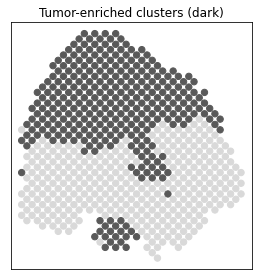

In [18]:
fig, ax = plt.subplots(1,1, figsize=(3.7, 4))
spatialcorr.plot_slide(
    adata.obs, 
    [x in set([1,2,4,8]) for x in adata.obs['BayesSpace_11']], 
    cmap='categorical', 
    title="Tumor-enriched clusters (dark)",
    dsize=40,
    ticks=False,
    figure=fig,
    ax=ax,
    cat_palette=['#d9d9d9', '#595959']
)

plt.tight_layout()
fig.savefig('./figures_V2/P2_tumor_region.pdf', format='pdf')

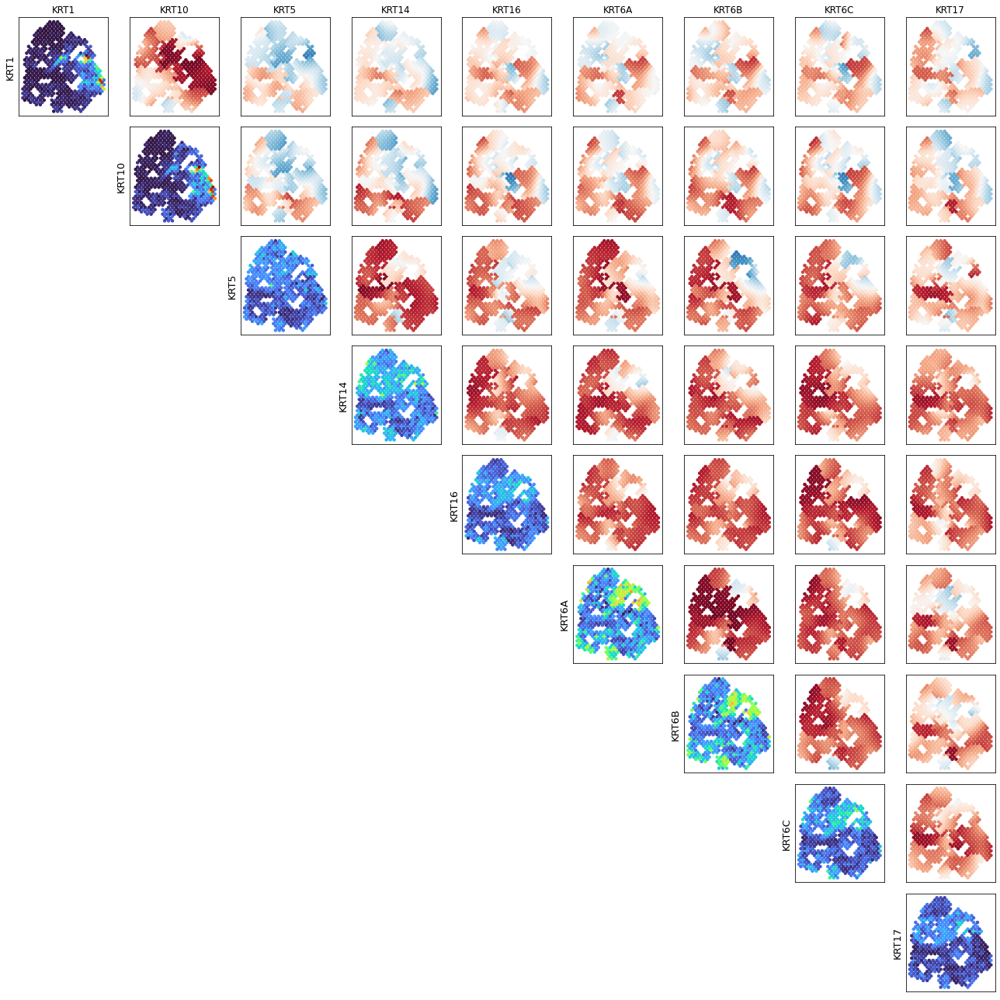

In [14]:
spatialcorr.plot.mult_genes_plot_correlation(
    [
        "KRT1",
        "KRT10",
        "KRT5",
        "KRT14",
        "KRT16",
        "KRT6A",
        "KRT6B",
        "KRT6C",
        "KRT17"
    ],
    adata,
    'BayesSpace_11',
    dsize=12,
    estimate_type='local',
    fig_path='./figures_V2/P2_keratin_corr_heatmaps.pdf',
    fig_format='pdf'
)

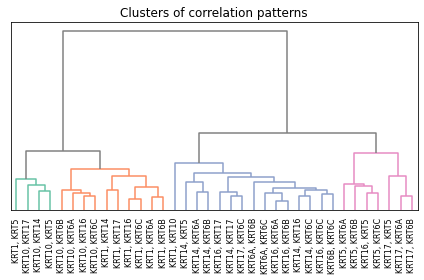

<Figure size 432x288 with 0 Axes>

In [13]:
spatialcorr.plot.cluster_pairwise_correlations(
    [
        "KRT1",
        "KRT10",
        "KRT14",
        "KRT16",
        "KRT17",
        "KRT5",
        "KRT6A",
        "KRT6B",
        "KRT6C"
    ],
    adata,
    'BayesSpace_11',
    color_thresh=14,
    remove_y_ticks=True,
    title='Clusters of correlation patterns',
    fig_path='./figures_V2/P2_keratin_pairwise_cluster.pdf',
    fig_format='pdf'
)

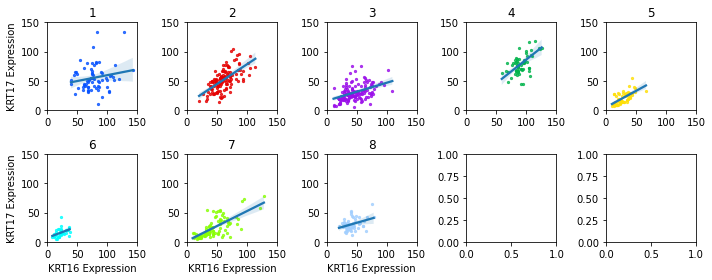

In [13]:
spatialcorr.plot.cluster_pairwise_scatterplots(
    'KRT16',
    'KRT17',
    adata,
    'BayesSpace_11',
    sigma=5,
    row_key='row',
    col_key='col',
    xlim=(0,150),
    ylim=(0,150)
)

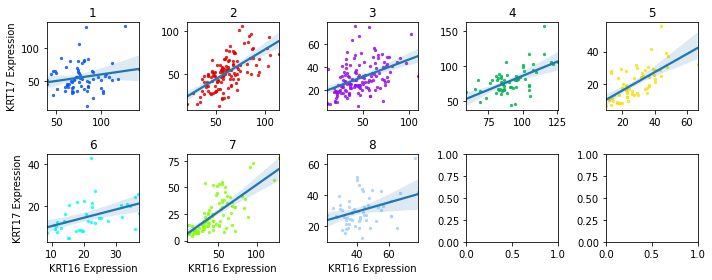

In [25]:
spatialcorr.plot.cluster_pairwise_scatterplots(
    'KRT16',
    'KRT17',
    adata,
    'BayesSpace_11',
    sigma=5,
    row_key='row',
    col_key='col'
)

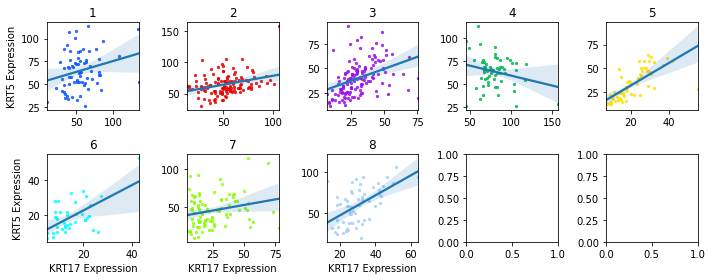

In [26]:
spatialcorr.plot.cluster_pairwise_scatterplots(
    'KRT17',
    'KRT5',
    adata,
    'BayesSpace_11',
    sigma=5,
    row_key='row',
    col_key='col'
)

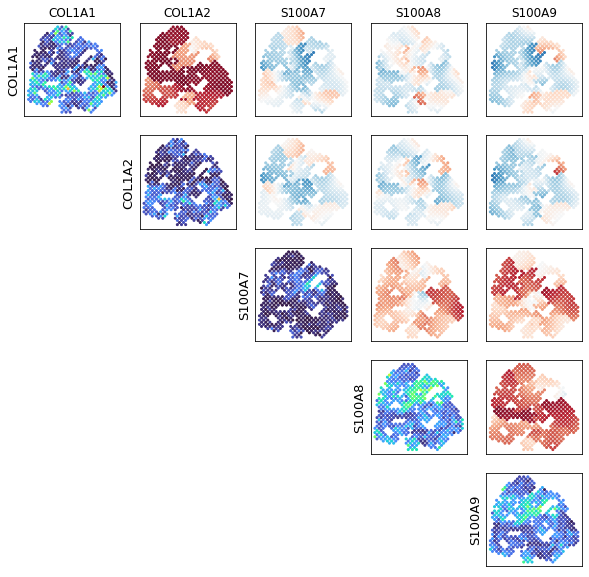

In [14]:
spatialcorr.plot.mult_genes_plot_correlation(
    [
        "COL1A1",
        "COL1A2",
        "S100A7",
        "S100A8",
        "S100A9"
    ],
    adata,
    'BayesSpace_11',
    dsize=4,
    estimate_type='local'
)

Kept 553/645 spots.


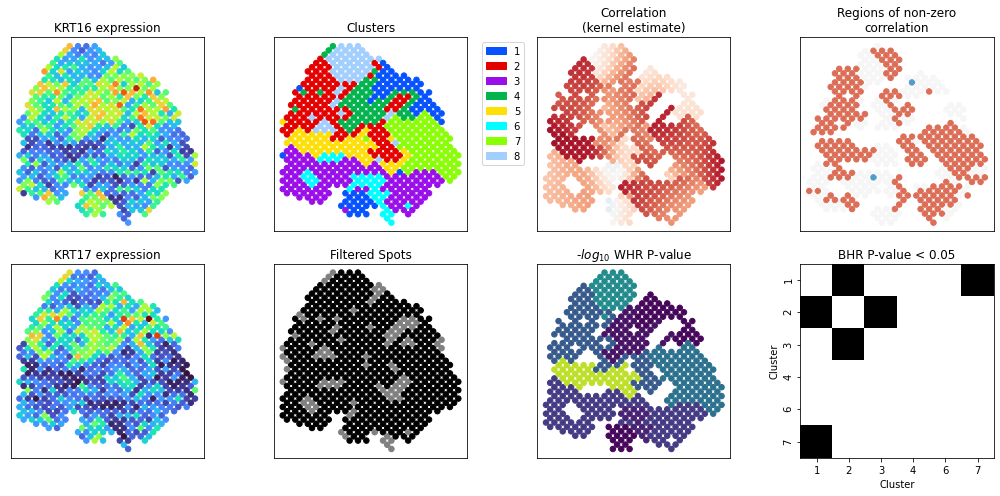

In [15]:
spatialcorr.analysis_pipeline_pair(
    'KRT16',            
    'KRT17',            
    adata,              
    bandwidth=5,        
    cond_key='BayesSpace_11', 
    max_perms=1000,      
    dsize=30,           
    verbose=0
)

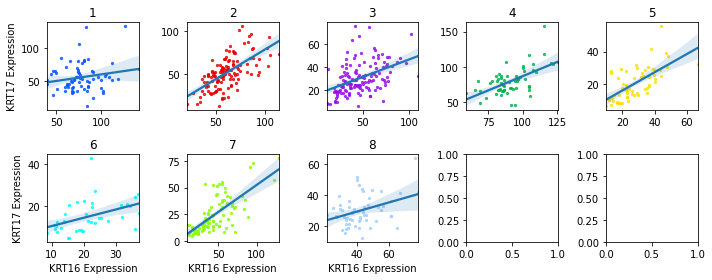

In [21]:
spatialcorr.plot.cluster_pairwise_scatterplots(
    'KRT16',
    'KRT17',
    adata,
    'BayesSpace_11',
    sigma=5,
    row_key='row',
    col_key='col'
)

Kept 553/645 spots.


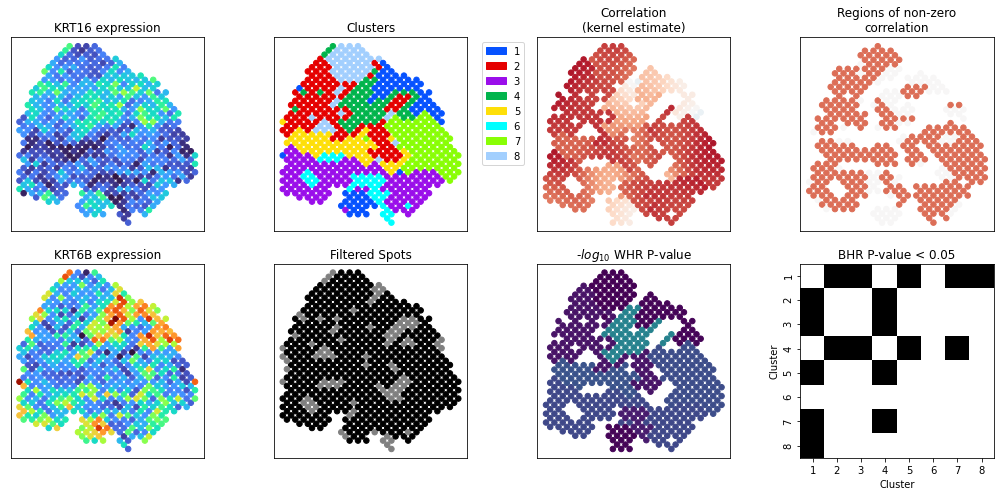

In [16]:
spatialcorr.analysis_pipeline_pair(
    'KRT16',            
    'KRT6B',            
    adata,              
    bandwidth=5,        
    cond_key='BayesSpace_11', 
    max_perms=100,      
    dsize=30,           
    verbose=0
)

Kept 553/645 spots.


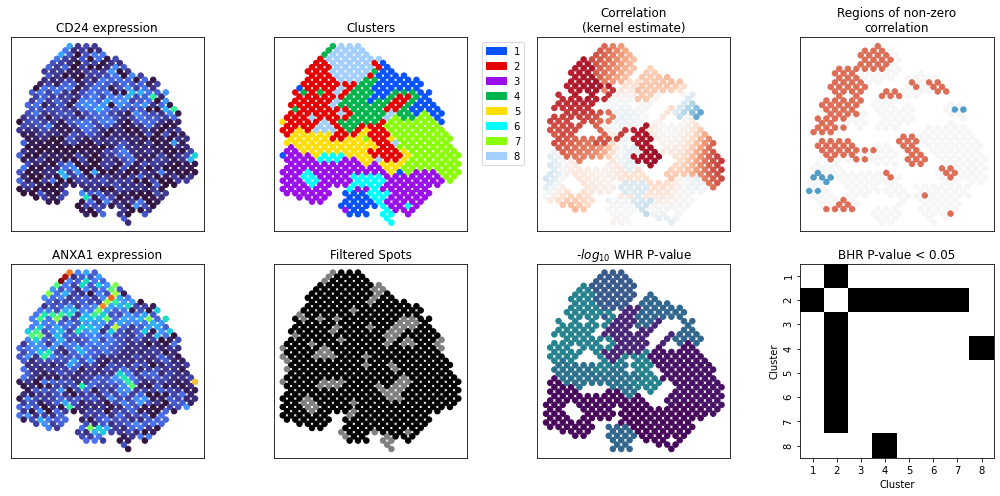

In [15]:
spatialcorr.analysis_pipeline_pair(
    'CD24',            
    'ANXA1',            
    adata,              
    bandwidth=5,        
    cond_key='BayesSpace_11', 
    max_perms=100,      
    dsize=30,           
    verbose=0
)

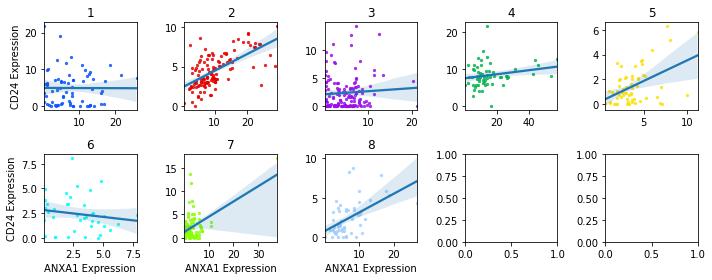

In [11]:
spatialcorr.plot.cluster_pairwise_scatterplots(
    'ANXA1',
    'CD24',
    adata,
    'BayesSpace_11',
    sigma=5,
    row_key='row',
    col_key='col'
)

Kept 553/645 spots.


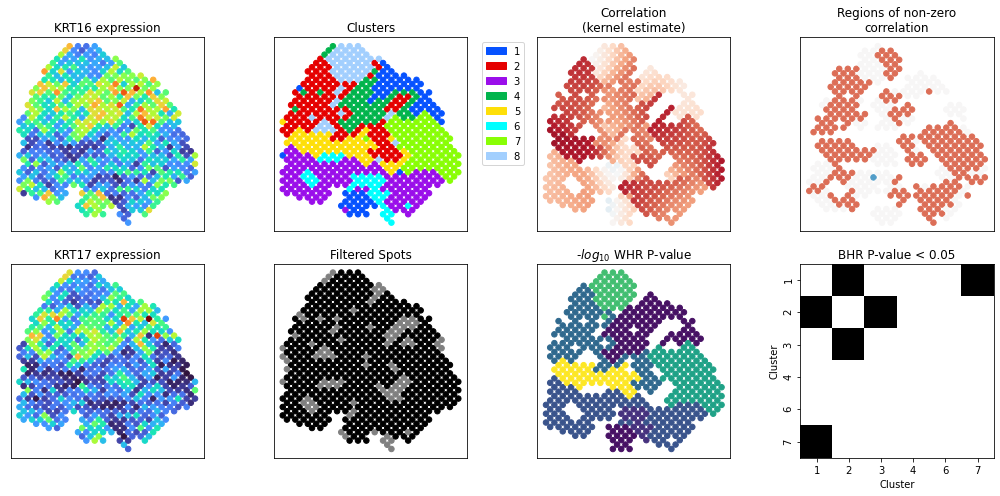

In [20]:
spatialcorr.analysis_pipeline_pair(
    'KRT16',            
    'KRT17',            
    adata,              
    bandwidth=5,        
    cond_key='BayesSpace_11', 
    max_perms=100,      
    dsize=30,           
    verbose=0
)

Kept 553/645 spots.


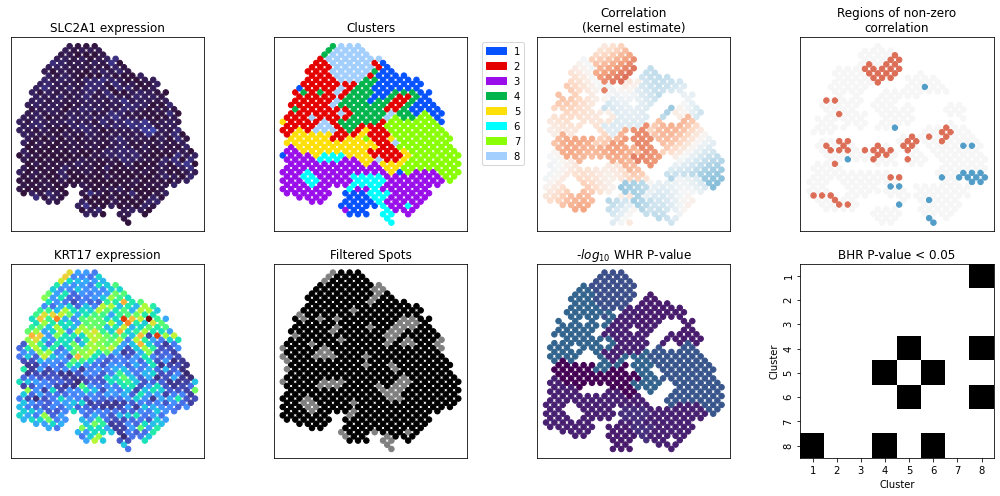

In [29]:
spatialcorr.analysis_pipeline_pair(
    'SLC2A1',            
    'KRT17',            
    adata,              
    bandwidth=5,        
    cond_key='BayesSpace_11', 
    max_perms=100,      
    dsize=30,           
    verbose=0
)

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attrib

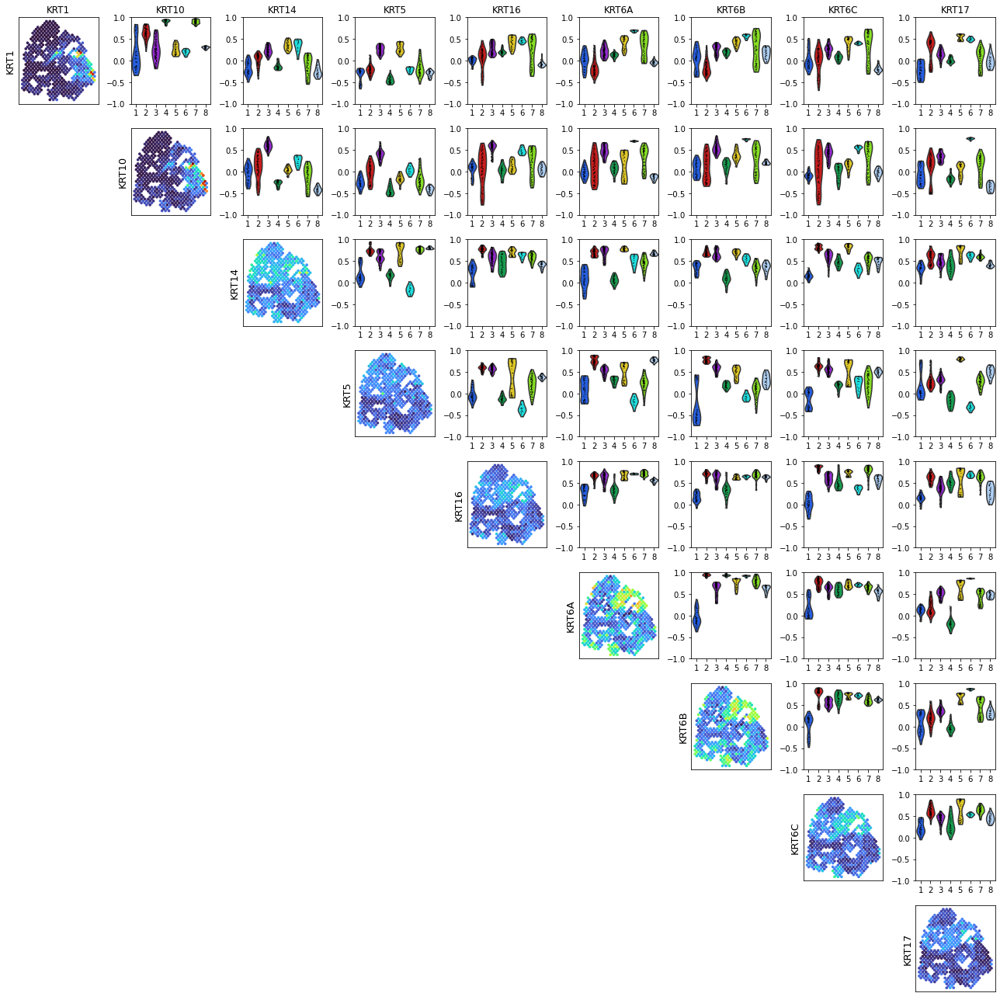

In [19]:

def draw_violin_corrs(g1, g2, ax, ylabel='', title=''):
    cust_pal = np.array(spatialcorr.plot.PALETTE_MANY)[
        [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11]
    ]
    
    adata_keep = adata.copy()
    corrs, keep_inds = spatialcorr.utils.compute_local_correlation(
        adata, 
        g1, g2,
        kernel_matrix=None, 
        row_key='row', 
        col_key='col', 
        condition='BayesSpace', 
        sigma=5,
        contrib_thresh=10
    )
    adata_keep = adata_keep[keep_inds,:]
    adata_keep.obs[f'Correlation {g1} & {g2}'] = corrs

    
    sc.pl.violin(
        adata_keep, 
        f'Correlation {g1} & {g2}', 
        groupby='BayesSpace', 
        palette=cust_pal, 
        ax=ax, 
        show=False
    )
    ax.set_ylim((-1,1))

    if ylabel is not None:
        ax.set_ylabel(ylabel)
    if title is not None:
        ax.set_title(title)
    ax.set_xlabel('')


def plot_pairwise_violins(
        plot_genes,
        cond_key,
        bandwidth=5,
        precomputed_kernel=None,
        contrib_thresh=10,
        estimate_type='local',
        row_key='row',
        col_key='col',
        dsize=7,
        fig_path=None,
        fig_format='png',
        fig_dpi=150
    ):
    condition = cond_key is not None
    kernel_matrix = spatialcorr.statistical_test._compute_kernel_matrix(
        adata.obs,
        sigma=bandwidth,
        cell_type_key=cond_key,
        condition_on_cell_type=condition,
        y_col=row_key,
        x_col=col_key
    )
    
    # Compute kept indices
    corrs, keep_inds = spatialcorr.utils.compute_local_correlation(
        adata,
        plot_genes[0], plot_genes[1],
        kernel_matrix=kernel_matrix,
        row_key=row_key,
        col_key=col_key,
        condition=cond_key,
        sigma=bandwidth,
        contrib_thresh=contrib_thresh
    )

    # Filter kernel matrix, if it's provided
    kernel_matrix = kernel_matrix[keep_inds,:]
    kernel_matrix = kernel_matrix[:,keep_inds]

    
    # Get range of expression values for colormap
    # of expression
    all_expr = []
    for gene in plot_genes:
        expr = adata[keep_inds,:].obs_vector(gene)
        all_expr += list(expr)
    min_expr = min(all_expr)
    max_expr = max(all_expr)
    
    fig, axarr = plt.subplots(
        len(plot_genes),
        len(plot_genes),
        figsize=(2*len(plot_genes),2*len(plot_genes))
    )

    for row, ax_row in enumerate(axarr):
        for col, ax in enumerate(ax_row):
            gene_1 = plot_genes[row]
            gene_2 = plot_genes[col]

            if row == 0:
                title = gene_2
            else:
                title = None

            if col == row:
                spatialcorr.plot.plot_slide(
                    adata[keep_inds,:].obs,
                    adata[keep_inds,:].obs_vector(gene_1),
                    cmap='turbo',
                    title=title,
                    dsize=dsize,
                    ax=ax,
                    figure=fig,
                    ticks=False,
                    vmin=min_expr,
                    vmax=max_expr,
                    row_key=row_key,
                    col_key=col_key
                )
                ax.set_ylabel(gene_1, fontsize=13)
            elif col > row:
                ylabel=''
                if col == 0:
                    ylabel = gene_1
                title = ''
                if row == 0:
                    title = gene_2
                draw_violin_corrs(gene_1, gene_2, ax, ylabel=ylabel, title=title)
            else:
                ax.set_visible(False)

    plt.tight_layout()
    fig.savefig('./figures/P2_pairwise_corr_distr_violin_matrix.pdf', bbox_layout='tight', format='pdf')
    fig.savefig('./figures/P2_pairwise_corr_distr_violin_matrix.png', bbox_layout='tight', format='png', dpi=150)
    
plot_genes = ['KRT1', 'KRT10', 'KRT14', 'KRT5', 'KRT16', 'KRT6A', 'KRT6B', 'KRT6C', 'KRT17']
plot_pairwise_violins(plot_genes, cond_key='BayesSpace')

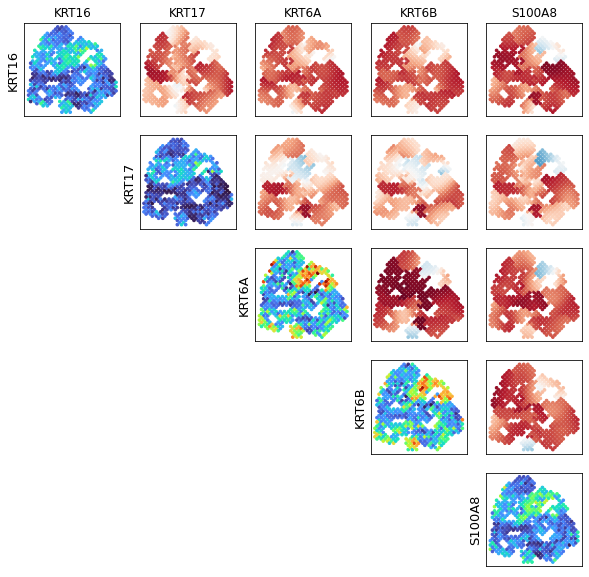

In [19]:
spatialcorr.plot.mult_genes_plot_correlation(
    ['KRT16', 'KRT17', 'KRT6A', 'KRT6B', 'S100A8'],
    adata,
    'BayesSpace_11',
    estimate_type='local'
)

In [15]:
def plot_within(g1, g2, condition='BayesSpace_11', sigma=5, dsize=10, ax=None, figure=None):
    plot_gene(g1, adata, cmap='turbo')
    plot_gene(g2, adata, cmap='turbo')
    corrs, kept_inds, _ = spatialcorr.plot_correlation(
        adata,
        g1, g2,
        sigma=sigma,
        contrib_thresh=10,
        kernel_matrix=None,
        row_key='row',
        col_key='col',
        condition=condition,
        cmap='RdBu_r',
        colorbar=True,
        ticks=True,
        ax=ax,
        figure=figure,
        estimate='local',
        dsize=dsize
    )
    #plt.show()
    return corrs, kept_inds

def plot_between(g1, g2, condition='BayesSpace_11'):
    plot_gene(g1, adata, cmap='turbo')
    plot_gene(g2, adata, cmap='turbo')
    corrs, kept_inds = spatialcorr.plot_correlation(
        adata,
        g1, g2,
        kernel_matrix=None,
        row_key='row',
        col_key='col',
        condition=condition,
        cmap='RdBu_r',
        colorbar=True,
        ticks=True,
        ax=None,
        figure=None,
        estimate='regional'
    )
    plt.show()
    return corrs, kept_inds

def run_full_analysis_pairwise(
        g1, 
        g2, 
        sigma=5, 
        max_perms=500, 
        n_procs=5, 
        test_between=False, 
        spot_to_neighbors=None, 
        spot_to_neighbors_clust=None
    ):
    plot_within(g1, g2, sigma=sigma);
    plt.show()

    p_val, t_obs, t_nulls, kept_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
        adata,
        [g1, g2],
        sigma,
        cond_key='BayesSpace_11',
        contrib_thresh=10,
        row_key='row',
        col_key='col',
        verbose=1,
        n_procs=n_procs,
        test_between_conds=test_between,
        compute_spotwise_pvals=True,
        max_perms=max_perms,
        mc_pvals=False,
        spot_to_neighbors=spot_to_neighbors_clust
    )
    print("P-value: ", p_val)
    
    n_sig_0_05 = len([x for x in spot_p_vals if x < 0.05])
    print("Number of spotwise p-values < 0.05: ", n_sig_0_05)
    
    max_val = np.quantile([abs(x) for x in obs_spot_lls], 0.8)
    llrtp.plot_slide(
        adata.obs.iloc[kept_inds], 
        obs_spot_lls, 
        cmap='PRGn',
        colorbar=True,
        dsize=13,
        vmin=-1*np.log(2),
        vmax=np.log(2),
        title='Log-likelihood ratios'
    )
    plt.show()
    
    #print("Mean p-value: ", np.mean(spot_p_vals))
    #sns.histplot(-1 * np.log10(spot_p_vals))
    #plt.show()
    
    #llrtp.plot_slide(
    #    adata.obs.iloc[kept_inds], 
    #    spot_p_vals, 
    #    cmap='viridis_r',
    #    colorbar=True,
    #    #vmin=0,
    #    #vmax=-1 * np.log10(1/max_perms),
    #    dsize=13,
    #    title='p-value'
    #)
    #plt.show()
    
    llrtp.plot_slide(
        adata.obs.iloc[kept_inds], 
        -1 * np.log10(spot_p_vals), 
        cmap='viridis',
        colorbar=True,
        #vmin=0,
        #vmax=-1 * np.log10(1/max_perms),
        dsize=13,
        title=r'$-log_{10}$ p-value'
    )
    plt.show()
    
    #cs_pvals = compute_spotwise_significance(
    #    adata.obs.iloc[kept_inds], 
    #    spot_p_vals
    #)
    #cs_pvals_fdr, _, _, _ = multipletests(
    #    cs_pvals, 
    #    method='fdr_bh',
    #    alpha=0.05
    #)

    #llrtp.plot_slide(
    #    adata.obs.iloc[kept_inds], 
    #    cs_pvals_fdr, 
    #    cmap='categorical',
    #    colorbar=True,
    #    vmin=0,
    #    vmax=1,
    #    dsize=20
    #)
    #plt.show()
    
    #return cs_pvals_fdr, kept_inds

def run_full_analysis_gene_set(genes, sigma=5, test_between=False):
    #plot_within(g1, g2);
    #plt.show()

    p_val, t_obs, t_nulls, kept_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
        adata,
        genes,
        sigma,
        cond_key='BayesSpace_11',
        contrib_thresh=10,
        row_key='row',
        col_key='col',
        verbose=1,
        n_procs=5,
        test_between_conds=False,
        compute_spotwise_pvals=True,
        max_perms=100
    )
    print("P-value: ", p_val)
    
    cs_pvals = compute_spotwise_significance(
        adata.obs.iloc[kept_inds], 
        spot_p_vals
    )

    cs_pvals_fdr, _, _, _ = multipletests(
        cs_pvals, 
        method='fdr_bh',
        alpha=0.1
    )
    
    llrtp.plot_slide(
        adata.obs.iloc[kept_inds], 
        spot_p_vals, 
        cmap='viridis_r',
        colorbar=True,
        vmin=0,
        vmax=1,
        dsize=15
    )
    plt.show()

    llrtp.plot_slide(
        adata.obs.iloc[kept_inds], 
        cs_pvals_fdr, 
        cmap='categorical',
        colorbar=True,
        vmin=0,
        vmax=1,
        dsize=20
    )
    plt.show()
    
    return cs_pvals_fdr, kept_inds

In [16]:
def full_analysis_pair_2(
        g1, 
        g2, 
        sigma=5, 
        max_perms=500, 
        n_procs=5, 
        test_between=False, 
        spot_to_neighbors=None, 
        spot_to_neighbors_clust=None
    ):
    fig, axarr = plt.subplots(
        2,
        3,
        figsize=(6,4)
    )  
    
    expr_1 = adata.obs_vector(g1)
    expr_2 = adata.obs_vector(g2)
    min_expr = min(list(expr_1) + list(expr_2))
    max_expr = max(list(expr_1) + list(expr_2))
        
    spatialcorr.plot_slide(
        adata.obs,
        expr_1,
        cmap='turbo',
        colorbar=False,
        vmin=min_expr,
        vmax=max_expr,
        title=f'{g1} expression',
        ax=axarr[0][0],
        figure=None,
        ticks=False,
        dsize=10,
        colorticks=None,
        row_key='row',
        col_key='col'
    )
    spatialcorr.plot_slide(
        adata.obs,
        expr_2,
        cmap='turbo',
        colorbar=False,
        vmin=min_expr,
        vmax=max_expr,
        title=f'{g2} expression',
        ax=axarr[1][0],
        figure=None,
        ticks=False,
        dsize=10,
        colorticks=None,
        row_key='row',
        col_key='col'
    )
    spatialcorr.plot_slide(
        adata.obs,
        adata.obs['BayesSpace_11'],
        cmap='categorical',
        colorbar=False,
        vmin=min_expr,
        vmax=max_expr,
        title=f'Clusters',
        ax=axarr[1][1],
        figure=None,
        ticks=False,
        dsize=10,
        colorticks=None,
        row_key='row',
        col_key='col'
    )
    
    if test_between:
        spatialcorr.plot_correlation(
            adata,
            g1,
            g2,
            sigma=5,
            contrib_thresh=10,
            row_key='row',
            col_key='col',
            condition='BayesSpace_11',
            cmap='RdBu_r',
            colorbar=False,
            ticks=False,
            ax=axarr[0][1],
            figure=fig,
            dsize=10,
            estimate='regional',
            title='Correlation\n(cluster estimate)'
        )
    else:
        spatialcorr.plot_correlation(
            adata,
            g1,
            g2,
            sigma=5,
            contrib_thresh=10,
            row_key='row',
            col_key='col',
            condition='BayesSpace_11',
            cmap='RdBu_r',
            colorbar=False,
            ticks=False,
            ax=axarr[0][1],
            figure=fig,
            dsize=10,
            estimate='local',
            title='Correlation\n(kernel estimate)'
        )
    
    if test_between:
        bin_corrs = corr_pos_neg_by_cluster(g1, g2, adata)
        keep_inds = np.arange(adata.shape[0])
    else:
        bin_corrs, keep_inds = corr_pos_neg(
            g1, g2, 
            adata, 
            neigh_thresh=10, 
            bc_to_neighs=spot_to_neighbors
        )
    spatialcorr.plot_slide(
        adata.obs.iloc[keep_inds],
        bin_corrs,
        cmap='RdBu_r',
        colorbar=False,
        vmin=-1.8,
        vmax=1.8,
        title=f'Regions of non-zero\ncorrelation',
        ax=axarr[0][2],
        figure=None,
        ticks=False,
        dsize=10,
        colorticks=None,
        row_key='row',
        col_key='col'
    )
    
    
    
    p_val, t_obs, t_nulls, kept_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
        adata,
        [g1, g2],
        sigma,
        cond_key='BayesSpace_11',
        contrib_thresh=10,
        row_key='row',
        col_key='col',
        verbose=1,
        n_procs=n_procs,
        test_between_conds=test_between,
        compute_spotwise_pvals=True,
        max_perms=max_perms,
        mc_pvals=False,
        spot_to_neighbors=spot_to_neighbors_clust
    )
    print(f"P-value: {p_val}")
    spatialcorr.plot_slide(
        adata.obs.iloc[kept_inds],
        -1 * np.log10(spot_p_vals),
        cmap='viridis',
        colorbar=False,
        vmin=0,
        vmax=-1 * np.log10(1/max_perms),
        title=r'-$log_{10}$ p-value',
        ax=axarr[1][2],
        figure=None,
        ticks=False,
        dsize=10,
        colorticks=None,
        row_key='row',
        col_key='col'
    )
    
def huh():
    p_val, t_obs, t_nulls, kept_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
        adata,
        [g1, g2],
        sigma,
        cond_key='BayesSpace_11',
        contrib_thresh=10,
        row_key='row',
        col_key='col',
        verbose=1,
        n_procs=n_procs,
        test_between_conds=test_between,
        compute_spotwise_pvals=True,
        max_perms=max_perms,
        mc_pvals=False,
        spot_to_neighbors=spot_to_neighbors
    )
    print("P-value: ", p_val)
    
    n_sig_0_05 = len([x for x in spot_p_vals if x < 0.05])
    print("Number of spotwise p-values < 0.05: ", n_sig_0_05)
    
    max_val = np.quantile([abs(x) for x in obs_spot_lls], 0.8)
    llrtp.plot_slide(
        adata.obs.iloc[kept_inds], 
        obs_spot_lls, 
        cmap='PRGn',
        colorbar=True,
        dsize=13,
        vmin=-1*np.log(2),
        vmax=np.log(2),
        title='Log-likelihood ratios'
    )
    plt.show()
    
    
    

In [17]:
def pairwise_clust_between(g1, g2):
    ct_to_ct_to_pval = spatialcorr.run_test_between_region_pairs(
        adata,
        [g1, g2],
        5,
        'BayesSpace_11',
        contrib_thresh=10,
        row_key='row',
        col_key='col',
        verbose=1,
        n_procs=5,
        standardize_var=False,
        max_perms=500,
        mc_pvals=True,
        spot_to_neighbors=None
    )
    da = []
    for ct_1 in sorted(set(ct_to_ct_to_pval.keys())):
        row = []
        for ct_2 in sorted(set(ct_to_ct_to_pval.keys())):
            if ct_1 == ct_2:
                row.append(False)
            else:
                row.append(ct_to_ct_to_pval[ct_1][ct_2] < 0.05)
        da.append(row)
    df_plot = pd.DataFrame(
        data=da,
        columns=sorted(set(ct_to_ct_to_pval.keys())),
        index=sorted(set(ct_to_ct_to_pval.keys()))
    )
    return df_plot

In [18]:
row_col_to_barcode = spatialcorr.utils.map_row_col_to_barcode(
    adata.obs,
    row_key='row',
    col_key='col'
)
bc_to_neighs = spatialcorr.utils.compute_neighbors(
    adata.obs,
    row_col_to_barcode,
    row_key='row',
    col_key='col',
    rad=3
)

In [19]:
clust_to_bcs = defaultdict(lambda: [])
for bc, clust in zip(adata.obs.index, adata.obs['BayesSpace_11']):
    clust_to_bcs[clust].append(bc)   
bc_to_index = {
    bc: bc_i
    for bc_i, bc in enumerate(adata.obs.index)
}
clust_to_indices = {
    clust: [bc_to_index[bc] for bc in bcs]
    for clust, bcs in clust_to_bcs.items()
}
bc_to_clust = {
    bc: clust
    for bc, clust in zip(adata.obs.index, adata.obs['BayesSpace_11'])
}
bc_to_neighs_clust_cond = {}
for bc, neighs in bc_to_neighs.items():
    curr_clust = bc_to_clust[bc]
    new_neighs = [
        x 
        for x in neighs
        if bc_to_clust[x] == curr_clust
    ]
    #print(new_neighs)
    bc_to_neighs_clust_cond[bc] = new_neighs
    
bc_to_neighs_full_clust = {
    bc: [adata.obs.index[ind] for ind in clust_to_indices[bc_to_clust[bc]]]
    for bc in bc_to_neighs_clust_cond
}

In [20]:

def local_spearman(g1, g2, ad, neigh_thresh=10, bc_to_neighs=None, corr_type='spearman'):
    expr_1 = ad.obs_vector(g1)
    expr_2 = ad.obs_vector(g2)
    if bc_to_neighs is None:
        row_col_to_barcode = spatialcorr.utils.map_row_col_to_barcode(
            ad.obs,
            row_key='row',
            col_key='col'
        )
        bc_to_neighs = spatialcorr.utils.compute_neighbors(
            ad.obs,
            row_col_to_barcode,
            row_key='row',
            col_key='col',
            rad=3
        )
    
    clust_to_bcs = defaultdict(lambda: set())
    for bc, clust in zip(ad.obs.index, ad.obs['BayesSpace_11']):
        clust_to_bcs[clust].add(bc)
                             
    bc_to_clust = {
        bc: clust
        for bc, clust in zip(ad.obs.index, ad.obs['BayesSpace_11'])
    }
    keep_inds = []
    corrs = []
    bc_to_ind = {
        bc: bc_i
        for bc_i, bc in enumerate(ad.obs.index)
    }
    for bc_i, bc in enumerate(ad.obs.index):
        #if bc_i % 50 == 0:
        #    print(f"Spot {bc_i}...")
        neighs = bc_to_neighs[bc]
        curr_clust = bc_to_clust[bc]
        neighs = sorted(set(neighs) & clust_to_bcs[curr_clust])
        if len(neighs) < neigh_thresh:
            continue
        keep_inds.append(bc_i)
        neigh_inds = [bc_to_ind[x] for x in neighs]
        expr_1_neigh = expr_1[neigh_inds]
        expr_2_neigh = expr_2[neigh_inds]
        if corr_type == 'spearman':
            corr, _ = spearmanr(expr_1_neigh, expr_2_neigh)
        elif corr_type == 'pearson':
            corr, _ = pearsonr(expr_1_neigh, expr_2_neigh)
        corrs.append(corr)
    return corrs, keep_inds

In [21]:
def corr_pos_neg(g1, g2, ad, neigh_thresh=10, bc_to_neighs=None, corr_type='spearman'):
    expr_1 = ad.obs_vector(g1)
    expr_2 = ad.obs_vector(g2)
    if bc_to_neighs is None:
        row_col_to_barcode = spatialcorr.utils.map_row_col_to_barcode(
            ad.obs,
            row_key='row',
            col_key='col'
        )
        bc_to_neighs = spatialcorr.utils.compute_neighbors(
            ad.obs,
            row_col_to_barcode,
            row_key='row',
            col_key='col',
            rad=3
        )
    
    clust_to_bcs = defaultdict(lambda: set())
    for bc, clust in zip(ad.obs.index, ad.obs['BayesSpace_11']):
        clust_to_bcs[clust].add(bc)
                             
    bc_to_clust = {
        bc: clust
        for bc, clust in zip(ad.obs.index, ad.obs['BayesSpace_11'])
    }
    keep_inds = []
    bin_corrs = []
    bc_to_ind = {
        bc: bc_i
        for bc_i, bc in enumerate(ad.obs.index)
    }
    for bc_i, bc in enumerate(ad.obs.index):
        #if bc_i % 500 == 0:
        #    print(f"Spot {bc_i}...")
        neighs = bc_to_neighs[bc]
        curr_clust = bc_to_clust[bc]
        neighs = sorted(set(neighs) & clust_to_bcs[curr_clust])
        if len(neighs) < neigh_thresh:
            continue
        keep_inds.append(bc_i)
        neigh_inds = [bc_to_ind[x] for x in neighs]
        expr_1_neigh = expr_1[neigh_inds]
        expr_2_neigh = expr_2[neigh_inds]
        
        boot_corrs = []
        for i in range(100): 
            boot_inds = np.random.choice(np.arange(len(expr_1_neigh)), size=len(expr_1_neigh), replace=True)
            e_1_boot = expr_1_neigh[boot_inds]
            e_2_boot = expr_2_neigh[boot_inds]
            corr_boot, _ = pearsonr(e_1_boot, e_2_boot)
            boot_corrs.append(corr_boot)
        boot_corrs = sorted(boot_corrs)
        #print(boot_corrs)
        if 0 > boot_corrs[95]:
            bin_corrs.append(-1)
        elif 0 < boot_corrs[5]:
            bin_corrs.append(1)
        else:
            bin_corrs.append(0)
    return bin_corrs, keep_inds

def corr_pos_neg_by_cluster(g1, g2, ad):
    expr_1 = ad.obs_vector(g1)
    expr_2 = ad.obs_vector(g2)
    
    
    clust_to_bcs = defaultdict(lambda: set())
    for bc, clust in zip(ad.obs.index, ad.obs['BayesSpace_11']):
        clust_to_bcs[clust].add(bc)
                             
    bc_to_clust = {
        bc: clust
        for bc, clust in zip(ad.obs.index, ad.obs['BayesSpace_11'])
    }
    keep_inds = []
    bin_corrs = []
    bc_to_ind = {
        bc: bc_i
        for bc_i, bc in enumerate(ad.obs.index)
    }
    
    clust_to_boot = {}
    for clust, clust_bcs in clust_to_bcs.items():
        clust_inds = [bc_to_ind[x] for x in clust_bcs]
        expr_1_clust = expr_1[clust_inds]
        expr_2_clust = expr_2[clust_inds]
        
        boot_corrs = []
        for i in range(100): 
            boot_inds = np.random.choice(np.arange(len(expr_1_clust)), size=len(expr_1_clust), replace=True)
            e_1_boot = expr_1_clust[boot_inds]
            e_2_boot = expr_2_clust[boot_inds]
            corr_boot, _ = pearsonr(e_1_boot, e_2_boot)
            boot_corrs.append(corr_boot)
        boot_corrs = sorted(boot_corrs)
        if 0 > boot_corrs[95]:
            clust_to_boot[clust] = -1
        elif 0 < boot_corrs[5]:
            clust_to_boot[clust] = 1
        else:
            clust_to_boot[clust] = 0
        
    bin_corrs = [
        clust_to_boot[bc_to_clust[bc]]
        for bc in adata.obs.index
    ]
        
    return bin_corrs

In [22]:
def plot_corr_confs(g1, g2, ad, bc_to_neighs, bc_is_border=None, ax=None, figure=None, dsize=10, dsize2=15, title=None):
    corrs, keep_inds = corr_pos_neg(g1, g2, ad, bc_to_neighs=bc_to_neighs)
    #llrtp.plot_slide(
    #    adata.obs.iloc[keep_inds], 
    #    np.array(bc_is_border)[keep_inds], 
    #    cmap='binary', 
    #    title="Border",
    #    vmin=0,
    #    vmax=0.1,
    #    dsize=dsize2,
    #    ax=ax,
    #    figure=figure,
    #    ticks=False
    #)
    llrtp.plot_slide(
        ad.obs.iloc[keep_inds], 
        np.full(len(keep_inds), 0.15), 
        cmap='binary', 
        #title="Border",
        vmin=0,
        vmax=1,
        dsize=dsize2,
        ax=ax,
        figure=figure,
        ticks=False
    )
    llrtp.plot_slide(
        ad.obs.iloc[keep_inds,:], 
        corrs, 
        #cmap='bwr',
        cmap='RdBu_r',
        vmin=-1.8,
        vmax=1.8,
        title=title,
        ax=ax,
        figure=figure,
        ticks=False,
        dsize=dsize
    )
    return corrs

# Compute cluster markers

AttributeError: Can only use .cat accessor with a 'category' dtype

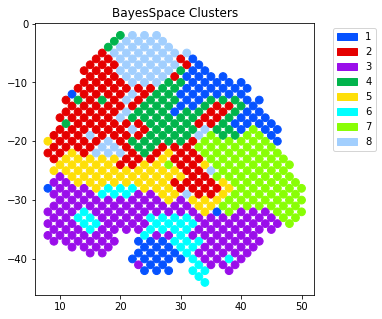

In [23]:
llrtp.plot_slide(
    adata.obs, 
    adata.obs['BayesSpace_11'], 
    cmap='categorical', 
    title="BayesSpace Clusters",
    dsize=60
)
sc.tl.rank_genes_groups(adata, 'BayesSpace_11', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=True, save=True)

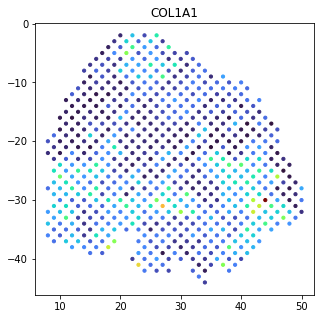

In [24]:
plot_gene('COL1A1', adata, cmap='turbo')

## Compute TSK-scores

In [19]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_zs = scaler.fit_transform(adata.X)
adata_zs = AnnData(
    X=X_zs,
    obs=adata.obs,
    var=adata.var
)

In [20]:
tsk_genes = [
    'MMP10',
    'PTHLH',
    'FEZ1',
    'IL24',
    'KCNMA1',
    'INHBA',
    'MAGEA4',
    'NT5E',
    'LAMC2',
    'SLITRK6',
    'MMP1',
    'SERPINE1',
    'SERPINE2',
    'IGFBP6',
    'TNC',
    'ITGA5',
    'ECM1',
    'SPINK6',
    'TMSB10',
    'KRT18',
    'FST',
    'ODC1',
    'LAMB3',
    'ITGA6',
    'ACTB',
    'ITGB1',
    'SORL1',
    'PFN1',
    'EMP3',
    'S100A10',
    'EREG',
    'LAMA3',
    'PRKCDBP',
    'OCIAD2',
    'CTSV',
    'ANXA3',
    'S100A2',
    'MET',
    'CD99',
    'TMSB4X',
    'TIMP3',
    'TPM4',
    'NEFM',
    'SCG5',
    'SH3BGRL3',
    'PLAU',
    'PKM',
    'CD63',
    'LGALS1',
    'BMP1',
    'TNFRSF12A',
    'ATP1B1',
    'CFL1',
    'MBOAT2',
    'F3',
    'TNFRSF21',
    'CLIC1',
    'CAP1',
    'PDPN',
    'SERINC2',
    'ANXA1',
    'BSG',
    'DSG2',
    'RHOC',
    'KRT17',
    'PDLIM7',
    'PHLDA1',
    'GLO1',
    'LTBP1',
    'TAGLN2',
    'CD151',
    'CAPN2',
    'COL5A2',
    'IGFBP2',
    'P4HA2',
    'COL17A1',
    'PLEK2',
    'AREG',
    'ARPC1B',
    'GLIPR1',
    'S100A6',
    'PLOD3',
    'YWHAZ',
    'CAV1',
    'ADIRF',
    'TGFBI',
    'RBP1',
    'FSTL3',
    'C16orf74',
    'UPP1',
    'TNNT1',
    'ANXA5',
    'SDC1',
    'PRDX5',
    'MYL12A',
    'GJB6',
    'SLC7A8',
    'RAB32',
    'FXYD5',
    'FSCN1'   
]

tsk_zs = []
for gene in tsk_genes:
    try:
        tsk_zs.append(adata_zs.obs_vector(gene))
    except KeyError:
        print(f'{gene} not in data...')
tsk_zs = np.array(tsk_zs)
tsk_zs

MAGEA4 not in data...


array([[-0.21864347,  0.2998108 ,  0.04788583, ..., -0.3099206 ,
        -0.30444402, -0.13649403],
       [-0.5241988 ,  0.35730934, -0.61019963, ..., -0.6121541 ,
         0.7736314 , -0.08051284],
       [-1.0399609 ,  0.07164502, -0.07271934, ..., -0.3037024 ,
         0.6924119 ,  2.0927465 ],
       ...,
       [-0.38073114,  0.65071577, -0.66513747, ..., -0.6120483 ,
         1.3598354 , -0.6082562 ],
       [-0.9083666 , -0.7286947 , -0.22349943, ..., -0.32390437,
        -0.7339791 , -1.0277956 ],
       [-0.3696804 ,  1.2164276 ,  0.5893862 , ..., -0.9702866 ,
        -1.0057096 , -0.5700587 ]], dtype=float32)

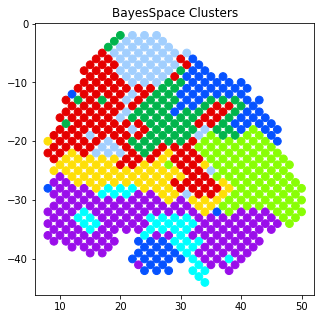

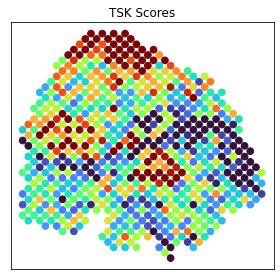

AttributeError: module 'spatialcorr' has no attribute 'PALETTE_MANY'

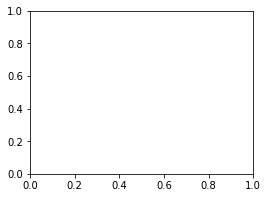

In [24]:
spatialcorr.plot_slide(
    adata.obs, 
    adata.obs['BayesSpace_11'], 
    cmap='categorical', 
    title="BayesSpace Clusters",
    dsize=60
)

tsk_scores = np.sum(tsk_zs, axis=0)
adata_zs.obs['TSK Score'] = tsk_scores

fig, ax = plt.subplots(1,1, figsize=(4, 4)) 
spatialcorr.plot_slide(
    adata.obs, 
    tsk_scores, 
    cmap='turbo',
    colorbar=False,
    title="TSK Scores",
    dsize=45,
    vmin=np.quantile(tsk_scores, 0.1),
    vmax=np.quantile(tsk_scores, 0.9),
    ax=ax,
    figure=fig,
    ticks=False
)
plt.tight_layout()
fig.savefig('./figures_V2/Patient_2_TSK_Scores_heatmap.pdf', format='pdf')
plt.show()

fig, ax = plt.subplots(1,1, figsize=(4, 3))
sc.pl.violin(adata_zs, keys='TSK Score', groupby='BayesSpace_11', log=False, palette=spatialcorr.PALETTE_MANY, ax=ax, show=False)
ax.set_xlabel('Cluster')
plt.tight_layout()
fig.savefig('./figures_V2/Patient_2_TSK_Scores_violin.pdf', bbox_layout='tight', format='pdf')
#plt.show()



#sc.pl.violin(adata_zs, keys='TSK Score', groupby='BayesSpace_11', log=False)
#plt.show()

# Dig into results from running on GO terms

In [28]:
def generate_gene_set_plots(
    genes_in_gs, 
    adata, 
    condition='BayesSpace_11', 
    sigma=5,
    corr_magnitude=False,
    estimate_type='local',
    plot_conf=True,
    pairwise_pvals=None,
    pairwise_pvals_2=None,
    dsize=7,
    fig_path=None
):
    # Select all genes that are in the data
    genes_in_gs = [
        gene for gene in genes_in_gs
        if gene in adata.var.index
    ]
    
    fig, axarr = plt.subplots(
        len(genes_in_gs),
        len(genes_in_gs),
        figsize=(2*len(genes_in_gs),2*len(genes_in_gs))
    )  
    
    
    if pairwise_pvals is not None:
        gene_pair_to_pval = {
            frozenset(k.split(',')): v
            for k,v in pairwise_pvals.items()
        }
    if pairwise_pvals_2 is not None:
        pairwise_pvals_2 = {
            frozenset(k.split(',')): v
            for k,v in pairwise_pvals_2.items()
        }
    
    # Compute kept indices
    corrs, keep_inds = spatialcorr.utils.compute_local_correlation(
        adata, 
        genes_in_gs[0], genes_in_gs[1],
        kernel_matrix=None, 
        row_key='row', 
        col_key='col', 
        condition=condition, 
        sigma=5,
        contrib_thresh=10
    )
    
    # Get range of expression values for colormap
    # of expression
    all_expr = []
    for gene in genes_in_gs:
        expr = adata[keep_inds,:].obs_vector(gene)
        all_expr += list(expr)
    min_expr = min(all_expr)
    max_expr = max(all_expr)
    
    for row, ax_row in enumerate(axarr):
        for col, ax in enumerate(ax_row):
            gene_1 = genes_in_gs[row]
            gene_2 = genes_in_gs[col]

            if row == 0:
                title = gene_2
            else: 
                title = None
                
            if corr_magnitude:
                cmap = 'turbo'
            else:
                cmap = 'RdBu_r'
            
            if col == row:
                llrtp.plot_slide(
                    adata[keep_inds,:].obs, 
                    adata[keep_inds,:].obs_vector(gene_1), 
                    cmap='turbo', 
                    title=title,
                    dsize=dsize,
                    ax=ax,
                    figure=fig,
                    ticks=False,
                    vmin=min_expr,
                    vmax=max_expr
                )
                ax.set_ylabel(gene_1, fontsize=13)
            elif col > row:
                #if col == row+1:
                #    ax.set_ylabel(gene_1, fontsize=13)
                if plot_conf:
                    plot_corr_confs(
                        gene_1, 
                        gene_2, 
                        adata, 
                        bc_to_neighs, 
                        bc_is_border, 
                        ax=ax, 
                        figure=None, 
                        dsize=0.5, 
                        dsize2=10,
                        title=title
                    )
                else:
                    corrs, kept_inds, _ = spatialcorr.plot_correlation(
                        adata[keep_inds,:],
                        gene_1, gene_2,
                        sigma=sigma,
                        contrib_thresh=10,
                        kernel_matrix=None,
                        row_key='row',
                        col_key='col',
                        condition=condition,
                        corr_magnitude=corr_magnitude,
                        cmap=cmap,
                        colorbar=False,
                        ticks=False,
                        ax=ax,
                        figure=None,
                        estimate=estimate_type,
                        dsize=dsize,
                        title=title
                    )
                #if pairwise_pvals is not None:
                #    if gene_pair_to_pval[frozenset({gene_1, gene_2})] < 0.005:
                #        ax.scatter([115, 105], [5, 5], marker='*', s=20, color='black')
                #    elif gene_pair_to_pval[frozenset({gene_1, gene_2})] < 0.05:
                #        ax.scatter([115], [5], marker='*', s=20, color='black')
                #if pairwise_pvals_2 is not None:
                #    if pairwise_pvals_2[frozenset({gene_1, gene_2})] < 0.005:
                #        ax.scatter([115, 105], [15, 15], marker='o', s=20, color='black')
                #    elif pairwise_pvals_2[frozenset({gene_1, gene_2})] < 0.05:
                #        ax.scatter([115], [15], marker='o', s=20, color='black')
                
            else:
                ax.set_visible(False)

    if fig_path:
        plt.tight_layout()
        fig.savefig(
            fig_path, 
            format='pdf'
        )
        plt.show()

    
def barplot():
    # Create barplots
    fig, ax = plt.subplots(
        1,
        1,
        figsize=(3,4)
    )
    pairs = [x[0] for x in targ_gs_to_pair_w_pval[targ_gs]]
    pvals = [x[1] for x in targ_gs_to_pair_w_pval[targ_gs]]
    r = multipletests(
        pvals, 
        alpha=0.05, 
        method='fdr_bh'
    )
    pvals_adj = list(-1 * np.log10(r[1]))
    sns.barplot(
        x=['All'] + [f"{x.split(',')[0]}, {x.split(',')[1]}" for x in pairs], 
        y=[-1 * np.log10(targ_res['gene_set_to_pval'][targ_gs])] + list(pvals_adj), 
        ax=ax, 
        palette=['#1c59ff'] +  ['#1cff95' for x in pairs]
    )
    ax.set_xticklabels(
        ['All'] + [f"{x.split(',')[0]}, {x.split(',')[1]}" for x in pairs], 
        rotation = 90
    )
    ax.axhline(-1 * np.log10(0.05), color='grey', ls='--')
    ax.set_xlabel('Gene Set')
    ax.set_ylabel(r'-$log_{10}$ p-value')
    ax.set_title('Compare joint p-value to\npairwise adjusted p-values')
    plt.tight_layout()
    #fig.savefig(
    #    f'../results/compare_joint_vs_pairwise.{gs}.barplot.pdf', 
    #    format='pdf'
    #)

In [29]:
from matplotlib import pyplot as plt
from scipy.cluster.hierarchy import dendrogram, set_link_color_palette
from sklearn.datasets import load_iris
from sklearn.cluster import AgglomerativeClustering

def compute_pairwise_corrs(gene_pairs):
    gps = []
    all_corrs = []
    for gp in gene_pairs:
        g1, g2 = gp.split(',')
        gps.append(gp)
        all_corrs.append(corrs)    
    return gps, all_corrs

def cluster_corrs(gsp, all_corrs, color_thresh=19):
    pal = list(sns.color_palette("Set2").as_hex())
    print(pal)

    def plot_dendrogram(model, **kwargs):
        # Create linkage matrix and then plot the dendrogram

        # create the counts of samples under each node
        counts = np.zeros(model.children_.shape[0])
        n_samples = len(model.labels_)
        for i, merge in enumerate(model.children_):
            current_count = 0
            for child_idx in merge:
                if child_idx < n_samples:
                    current_count += 1  # leaf node
                else:
                    current_count += counts[child_idx - n_samples]
            counts[i] = current_count

        linkage_matrix = np.column_stack([model.children_, model.distances_,
                                          counts]).astype(float)

        # Plot the corresponding dendrogram
        dendrogram(linkage_matrix, **kwargs)


    fig, ax = plt.subplots(
        1,
        1,
        figsize=(8,6)
    )
    # setting distance_threshold=0 ensures we compute the full tree.
    model = AgglomerativeClustering(distance_threshold=0, n_clusters=None)

    model = model.fit(np.array(all_corrs).squeeze())
    plt.title('Hierarchical Clustering Dendrogram')
    # plot the top three levels of the dendrogram

    set_link_color_palette(pal)

    plot_dendrogram(
        model, 
        truncate_mode='level', 
        p=6, 
        labels=gps, 
        color_threshold=color_thresh, 
        leaf_rotation=90, 
        ax=ax, 
        above_threshold_color='grey'
    )
    plt.show()

In [42]:
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_hypoxia_related.sequential_mc.between_layers.json', 'r') as f:
    j_hypoxia_between = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_interferon_related_related.sequential_mc.between_layers.json', 'r') as f:
    j_interferon_between = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_interleukin_related.sequential_mc.between_layers.json', 'r') as f:
    j_interleukin_between = json.load(f)
#with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_dna_repair_related.sequential_mc.between_layers.json', 'r') as f:
#    j_dna_repair_between = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_apoptosis_related.sequential_mc.between_layers.json', 'r') as f:
    j_apoptosis_between = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_epidermis_development_related.sequential_mc.between_layers.json', 'r') as f:
    j_epidermis_dev_between = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_keratinocyte_related.sequential_mc.between_layers.json', 'r') as f:
    j_keratinocyte_between = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_b_cell_related_related.sequential_mc.between_layers.json', 'r') as f:
    j_b_cell_between = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_t_cell_related.sequential_mc.between_layers.json', 'r') as f:
    j_t_cell_between = json.load(f) 
#with open('../GSM4565826_P6_rep2_GO_experiment/results_clust_11/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_cell_cell_adhesion_related.sequential_mc.between_layers.json', 'r') as f:
#    j_cell_cell_adhesion_between = json.load(f) 
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_dna_replication_related.sequential_mc.between_layers.json', 'r') as f:
    j_dna_replication_between = json.load(f) 
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_cell_cell_adhesion_related.sequential_mc.between_layers.json', 'r') as f:
    j_cell_cell_adhesion_between = json.load(f)
    
between_results = list(j_b_cell_between['gene_set_to_pval'].items()) \
    + list(j_hypoxia_between['gene_set_to_pval'].items()) \
    + list(j_epidermis_dev_between['gene_set_to_pval'].items()) \
    + list(j_interferon_between['gene_set_to_pval'].items()) \
    + list(j_dna_replication_between['gene_set_to_pval'].items()) \
    + list(j_interleukin_between['gene_set_to_pval'].items()) \
    + list(j_apoptosis_between['gene_set_to_pval'].items()) \
    + list(j_t_cell_between['gene_set_to_pval'].items()) \
    + list(j_keratinocyte_between['gene_set_to_pval'].items()) \
    + list(j_cell_cell_adhesion_between['gene_set_to_pval'].items()) \
#    + list(j_dna_repair_between['gene_set_to_pval'].items()) \
#    


In [43]:
#with open('../GSM4565826_P6_rep2_GO_experiment/results_clust_11/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_hypoxia_related.sequential_mc.json', 'r') as f:
#    j_hypoxia_within = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_dna_repair_related.sequential_mc.json', 'r') as f:
    j_dna_repair_within = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_b_cell_related_related.sequential_mc.json', 'r') as f:
    j_b_cell_within = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_interferon_related_related.sequential_mc.json', 'r') as f:
    j_interferon_within = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_interleukin_related.sequential_mc.json', 'r') as f:
    j_interleukin_within = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_apoptosis_related.sequential_mc.json', 'r') as f:
    j_apoptosis_within = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_epidermis_development_related.sequential_mc.json', 'r') as f:
    j_epidermis_dev_within = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_keratinocyte_related.sequential_mc.json', 'r') as f:
    j_keratinocyte_within = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_t_cell_related.sequential_mc.json', 'r') as f:
    j_t_cell_within = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_cell_cell_adhesion_related.sequential_mc.json', 'r') as f:
    j_cell_cell_adhesion_within = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_dna_replication_related.sequential_mc.json', 'r') as f:
    j_dna_replication_within = json.load(f)

within_results = list(j_b_cell_within['gene_set_to_pval'].items()) \
    + list(j_interferon_within['gene_set_to_pval'].items()) \
    + list(j_dna_replication_within['gene_set_to_pval'].items()) \
    + list(j_interleukin_within['gene_set_to_pval'].items()) \
    + list(j_epidermis_dev_within['gene_set_to_pval'].items()) \
    + list(j_apoptosis_within['gene_set_to_pval'].items()) \
    + list(j_t_cell_within['gene_set_to_pval'].items()) \
    + list(j_cell_cell_adhesion_within['gene_set_to_pval'].items()) \
    + list(j_dna_repair_within['gene_set_to_pval'].items()) \
    + list(j_keratinocyte_within['gene_set_to_pval'].items()) \
#    + list(j_hypoxia_within['gene_set_to_pval'].items()) \
#    
#    


BHR-Test
('GO_B_CELL_MEDIATED_IMMUNITY', 0.0001)
('GO_B_CELL_ACTIVATION', 0.0001)
('GO_REGULATION_OF_B_CELL_ACTIVATION', 0.0001)
('GO_POSITIVE_REGULATION_OF_B_CELL_ACTIVATION', 0.0001)
('GO_B_CELL_RECEPTOR_SIGNALING_PATHWAY', 0.0001)
('GO_REGULATION_OF_EPIDERMIS_DEVELOPMENT', 0.0001)
('GO_EPIDERMIS_DEVELOPMENT', 0.0001)
('GO_APOPTOTIC_SIGNALING_PATHWAY', 0.0001)
('GO_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY', 0.0001)
('GO_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY_BY_P53_CLASS_MEDIATOR', 0.0001)
('GO_POSITIVE_REGULATION_OF_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY', 0.0001)
('GO_REGULATION_OF_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY', 0.0001)
('GO_POSITIVE_REGULATION_OF_APOPTOTIC_SIGNALING_PATHWAY', 0.0001)
('GO_REGULATION_OF_APOPTOTIC_SIGNALING_PATHWAY', 0.0001)
('GO_POSITIVE_REGULATION_OF_T_CELL_PROLIFERATION', 0.0001)
('GO_KERATINOCYTE_DIFFERENTIATION', 0.0001)
('GO_CELL_CELL_ADHESION', 0.0001)
('GO_LEUKOCYTE_CELL_CELL_ADHESION', 0.0001)
('GO_HOMOTYPIC_CELL_CELL_ADHESION', 0.0001)
('GO_KERATINOCYT

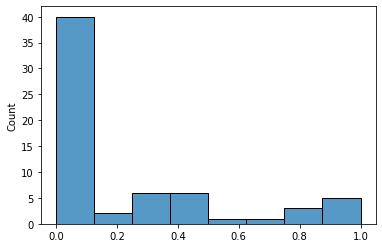

In [44]:
print("BHR-Test")
gs_between_p_vals = [x[1] for x in between_results]
gs_between_p_vals_fdr, _, _, _ = multipletests(
    gs_between_p_vals, 
    method='fdr_bh',
    alpha=0.25
)
print('\n'.join(map(str, sorted(between_results, key=lambda x: x[1])[:50])))
print(Counter(gs_between_p_vals_fdr))
sns.histplot(gs_between_p_vals)
plt.show()

WHR-Test
('GO_REGULATION_OF_EPIDERMIS_DEVELOPMENT', 0.0001)
('GO_EPIDERMIS_DEVELOPMENT', 0.0001)
('GO_APOPTOTIC_SIGNALING_PATHWAY', 0.0001)
('GO_CELL_CELL_ADHESION', 0.0001)
('GO_KERATINOCYTE_DIFFERENTIATION', 0.0001)
('GO_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY', 0.0004)
('GO_REGULATION_OF_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY', 0.0004)
('GO_REGULATION_OF_APOPTOTIC_SIGNALING_PATHWAY', 0.0007)
('GO_LEUKOCYTE_CELL_CELL_ADHESION', 0.0012)
('GO_REGULATION_OF_T_CELL_ACTIVATION', 0.006607201850016518)
('GO_POSITIVE_REGULATION_OF_APOPTOTIC_SIGNALING_PATHWAY', 0.011344299489506523)
('GO_T_CELL_ACTIVATION', 0.013123359580052493)
('GO_NEGATIVE_REGULATION_OF_LEUKOCYTE_CELL_CELL_ADHESION', 0.01448225923244026)
('GO_T_CELL_RECEPTOR_SIGNALING_PATHWAY', 0.017421602787456445)
('GO_T_CELL_PROLIFERATION', 0.020222446916076844)
('GO_POSITIVE_REGULATION_OF_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY', 0.024721878862793572)
('GO_RESPONSE_TO_INTERFERON_GAMMA', 0.05025125628140704)
('GO_CELL_CELL_ADHESION_VIA_PLASM

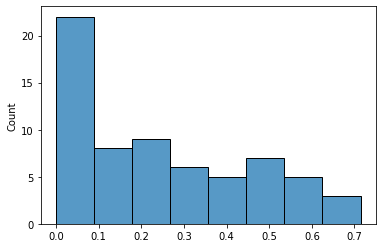

In [45]:
print("WHR-Test")
gs_within_p_vals = [x[1] for x in within_results]
gs_within_p_vals_fdr, p_vals_fdr, _, _ = multipletests(
    gs_within_p_vals, 
    method='fdr_bh',
    alpha=0.25
)
print('\n'.join(map(str, sorted(within_results, key=lambda x: x[1])[:50])))
print(Counter(gs_within_p_vals_fdr))
sns.histplot(gs_within_p_vals)
plt.show()

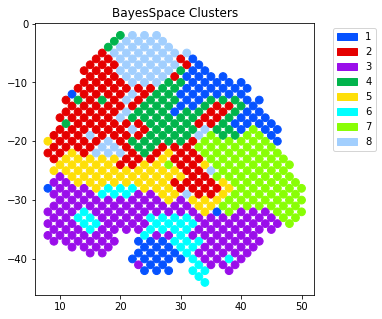

In [30]:
llrtp.plot_slide(
    adata.obs, 
    adata.obs['BayesSpace_11'], 
    cmap='categorical', 
    title="BayesSpace Clusters",
    dsize=60
)

In [31]:
def plot_gene_set_result(data_res, gs, est_type, corr_magnitude=False, data_res_2=None, plot_pairwise_bar=False, plot_conf=True):
    if gs in data_res['gene_set_to_pairwise_pvals'].keys():
        if data_res_2 is not None:
            assert frozenset(data_res['gene_set_to_genes'].keys()) == frozenset(data_res_2['gene_set_to_genes'].keys())
            generate_gene_set_plots(
                data_res['gene_set_to_genes'][gs], 
                adata,
                condition='BayesSpace_11',
                estimate_type=est_type,
                sigma=7,
                pairwise_pvals=data_res['gene_set_to_pairwise_pvals'][gs],
                pairwise_pvals_2=data_res_2['gene_set_to_pairwise_pvals'][gs],
                corr_magnitude=corr_magnitude,
                plot_conf=plot_conf
            )
        else:
            generate_gene_set_plots(
                data_res['gene_set_to_genes'][gs], 
                adata,
                condition='BayesSpace_11',
                estimate_type=est_type,
                sigma=7,
                pairwise_pvals=data_res['gene_set_to_pairwise_pvals'][gs],
                corr_magnitude=corr_magnitude,
                plot_conf=plot_conf
            )
        plt.show()
        if plot_pairwise_bar:
            sns.histplot(list(data_res['gene_set_to_pairwise_pvals'][gs].values()))
            plt.show()
            p_vals_fdr, _, _, _ = multipletests(
                list(data_res['gene_set_to_pairwise_pvals'][gs].values()), 
                method='fdr_bh',
                alpha=0.05
            )
            print(Counter(p_vals_fdr))
    else:
        generate_gene_set_plots(
            data_res['gene_set_to_genes'][gs], 
            adata,
            condition='BayesSpace_11',
            estimate_type=est_type,
            sigma=7,
            corr_magnitude=corr_magnitude,
            plot_conf=plot_conf
        )

## GO Leukocyte Cell Cell Adhesion

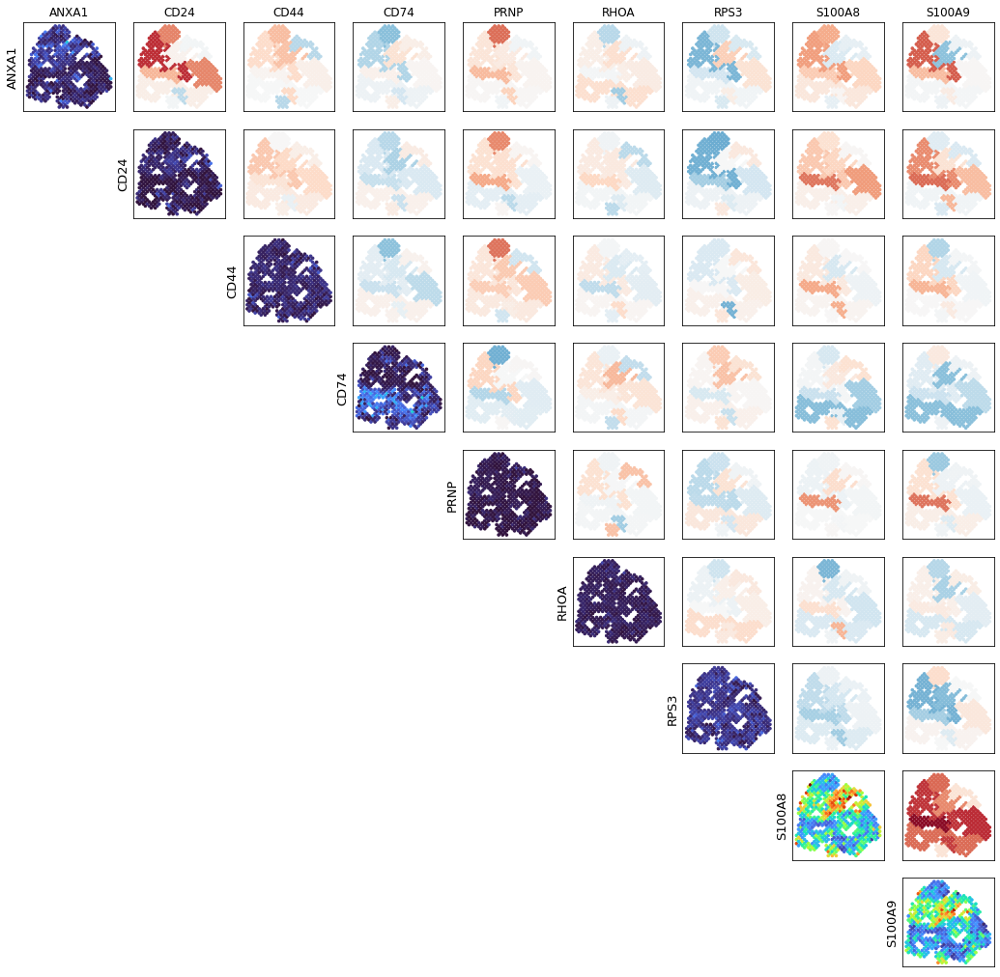

In [46]:
plot_gene_set_result(
    j_cell_cell_adhesion_between, 
    'GO_LEUKOCYTE_CELL_CELL_ADHESION', 
    est_type='regional',
    data_res_2=j_cell_cell_adhesion_within,
    plot_conf=False
)

## GO Response to Interleukin 4

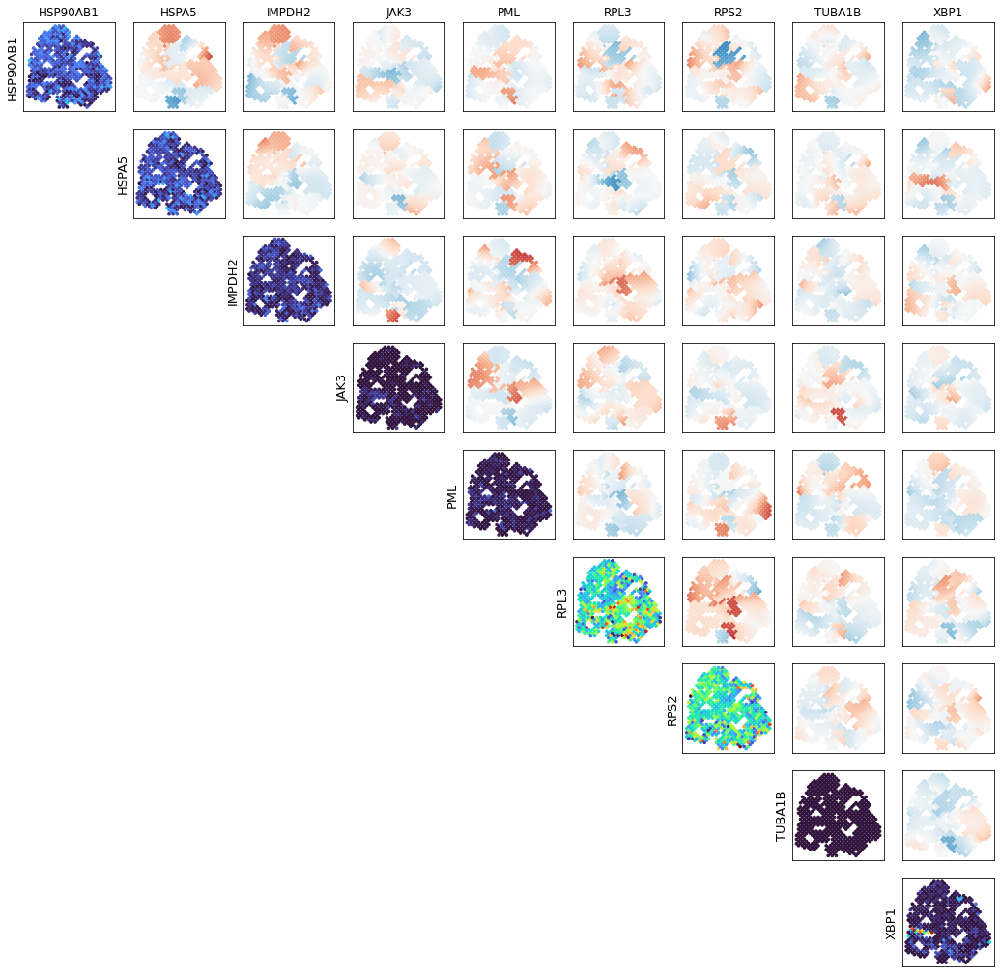

In [47]:
plot_gene_set_result(
    j_interleukin_between, 
    'GO_RESPONSE_TO_INTERLEUKIN_4', 
    est_type='local',
    data_res_2=j_interleukin_within,
    plot_conf=False
)

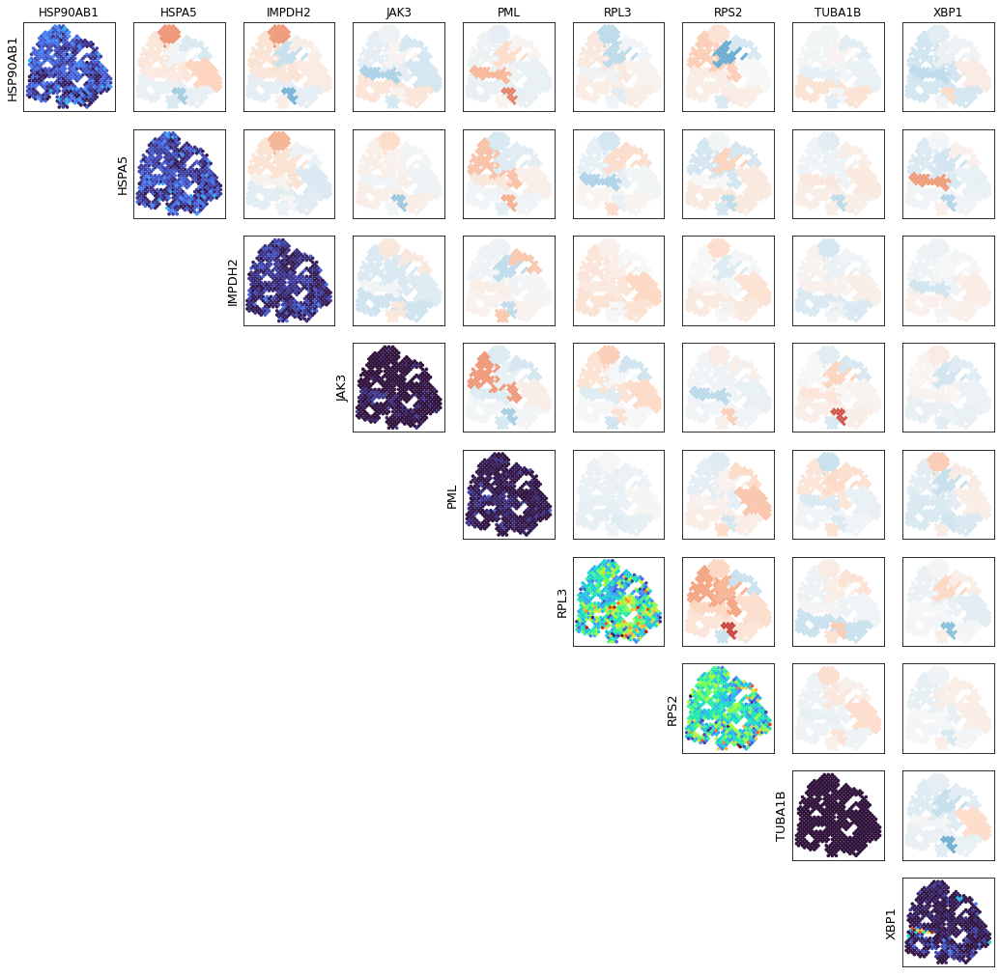

In [48]:
plot_gene_set_result(
    j_interleukin_between, 
    'GO_RESPONSE_TO_INTERLEUKIN_4', 
    est_type='regional',
    data_res_2=j_interleukin_within,
    plot_conf=False
)

# GO Cell Cell Adhesion

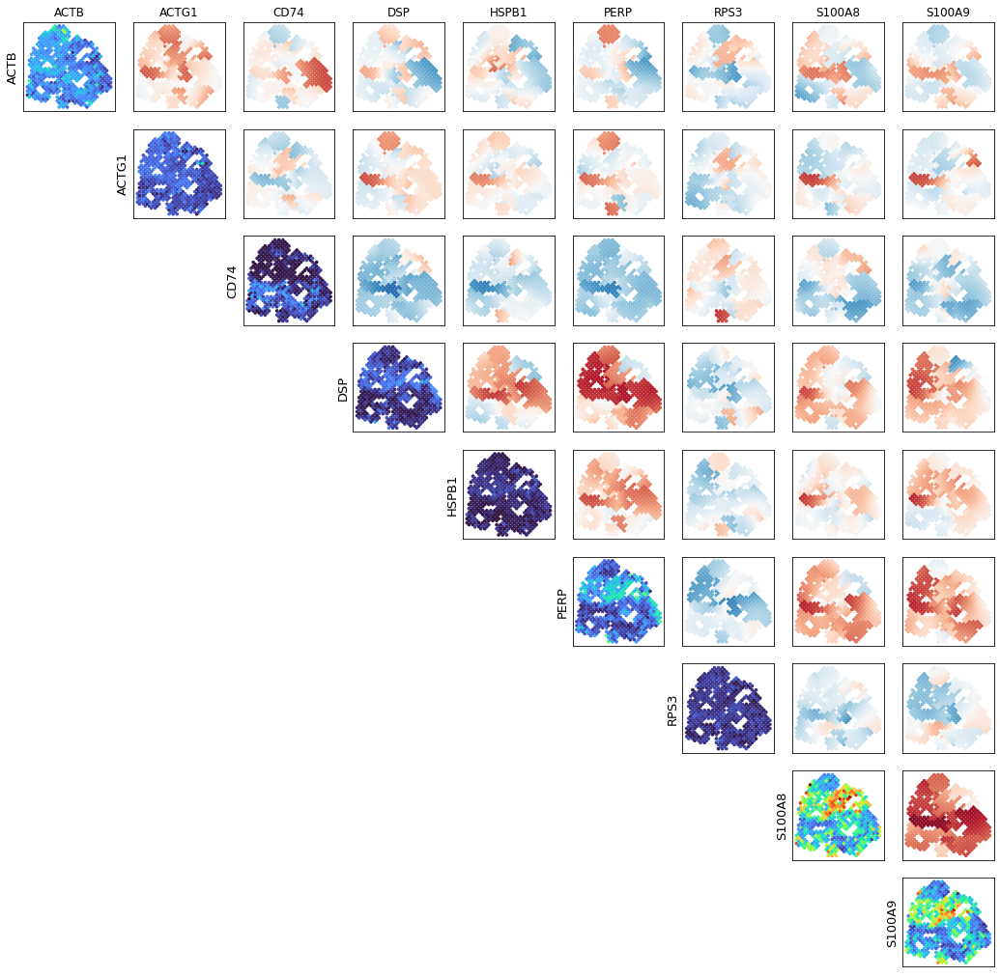

In [49]:
plot_gene_set_result(
    j_cell_cell_adhesion_between, 
    'GO_CELL_CELL_ADHESION', 
    est_type='local',
    data_res_2=j_cell_cell_adhesion_within,
    plot_conf=False
)

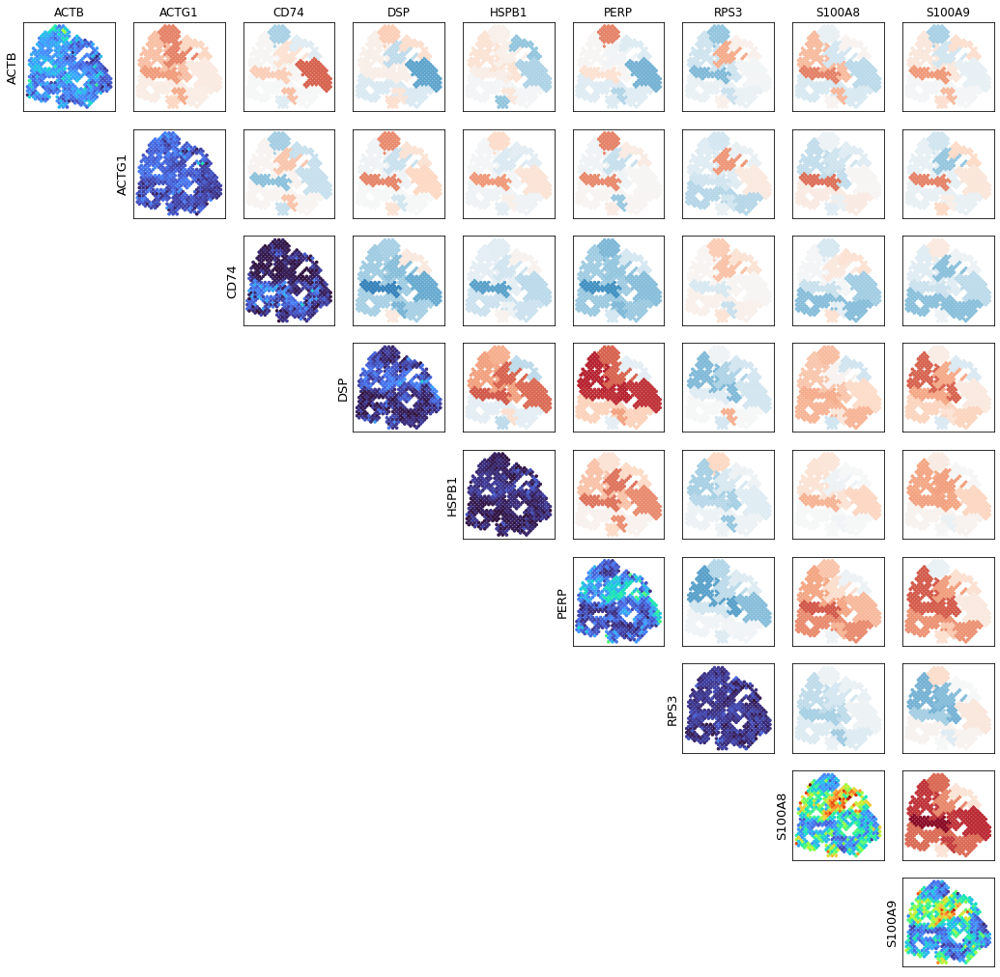

In [50]:
plot_gene_set_result(
    j_cell_cell_adhesion_between, 
    'GO_CELL_CELL_ADHESION', 
    est_type='regional',
    data_res_2=j_cell_cell_adhesion_within,
    plot_conf=False
)

# GO Keratinocyte Differentiation

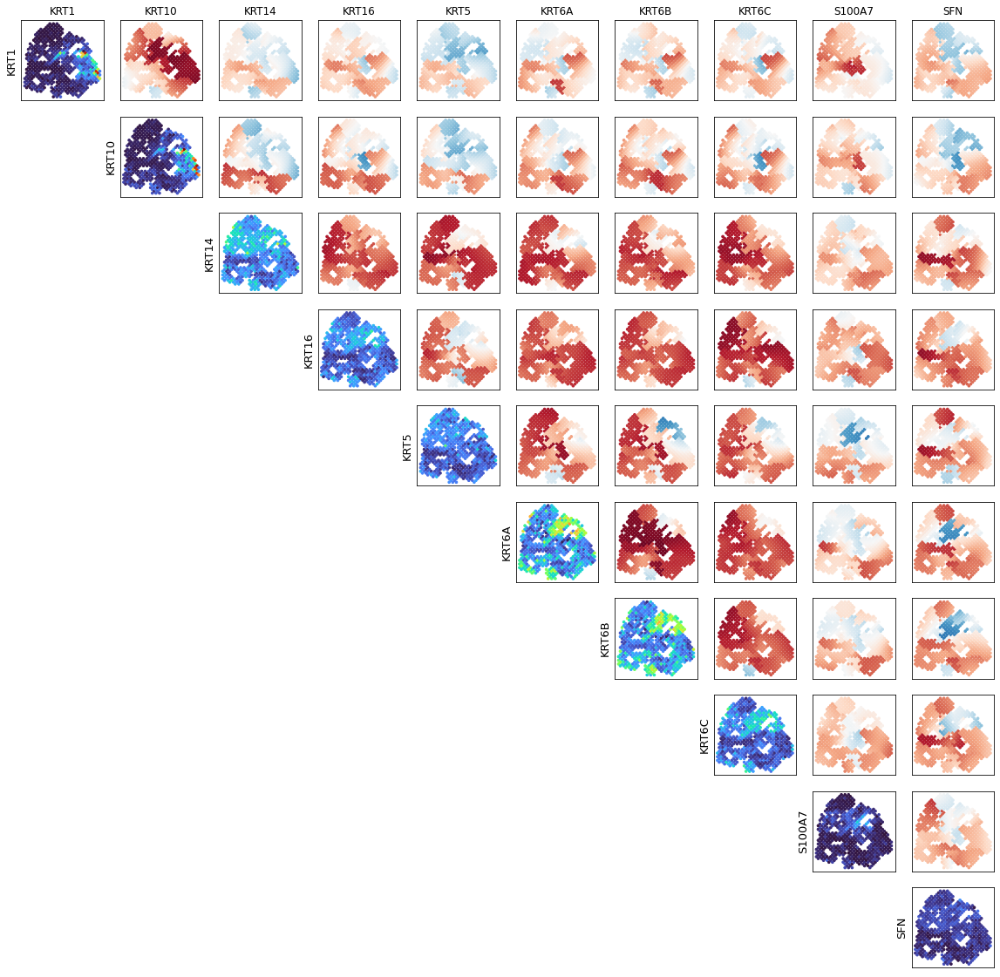

In [51]:
plot_gene_set_result(
    j_keratinocyte_between, 
    'GO_KERATINOCYTE_DIFFERENTIATION', 
    est_type='local',
    data_res_2=j_keratinocyte_within,
    plot_conf=False
)

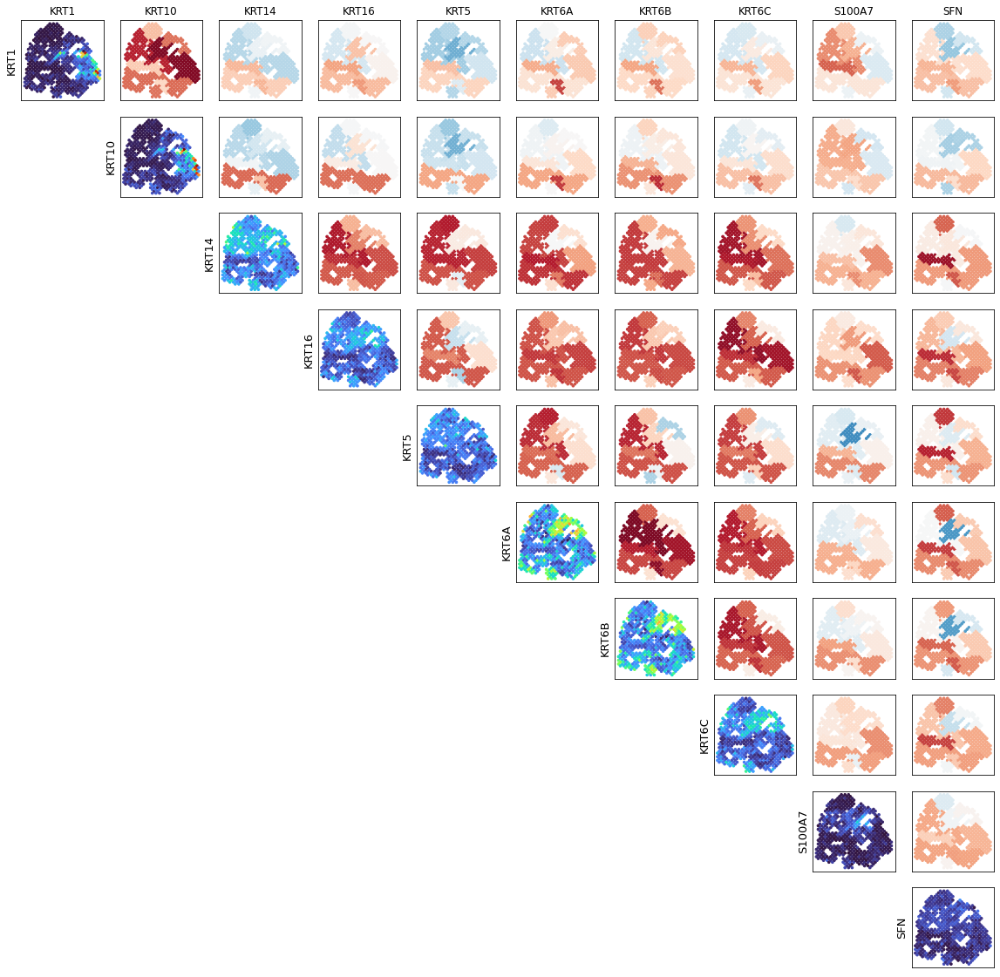

In [52]:
plot_gene_set_result(
    j_keratinocyte_between, 
    'GO_KERATINOCYTE_DIFFERENTIATION', 
    est_type='regional',
    data_res_2=j_keratinocyte_within,
    plot_conf=False
)

In [85]:
gps, all_corrs = compute_pairwise_corrs(j_keratinocyte_within['gene_set_to_pairwise_pvals']['GO_KERATINOCYTE_DIFFERENTIATION'])

['#66c2a5', '#fc8d62', '#8da0cb', '#e78ac3', '#a6d854', '#ffd92f', '#e5c494', '#b3b3b3']


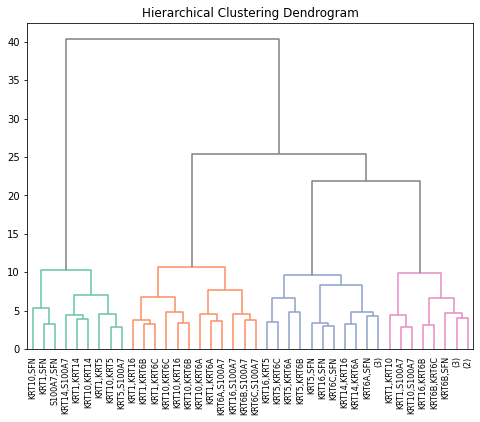

In [86]:
cluster_corrs(gps, all_corrs)

## Gene pair: KRT6B, KRT16

Kept 468/620 spots.
P-value: 0.098
Kept 468/620 spots.
P-value: 0.002


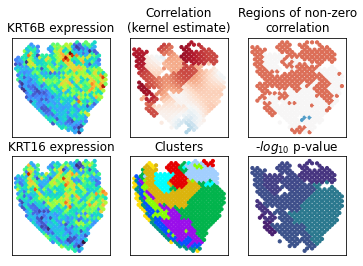

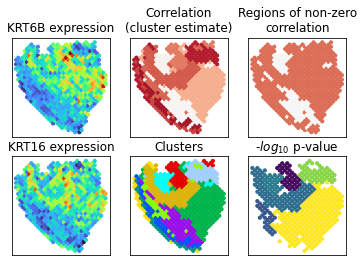

In [75]:
full_analysis_pair_2(
    'KRT6B', 'KRT16',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond,
    spot_to_neighbors_clust=bc_to_neighs_full_clust
)
full_analysis_pair_2(
    'KRT6B', 'KRT16', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust,
    spot_to_neighbors_clust=bc_to_neighs_full_clust
)

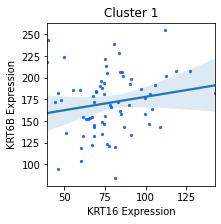

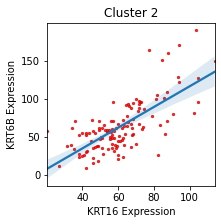

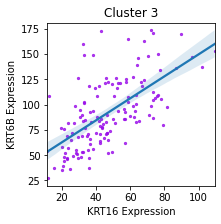

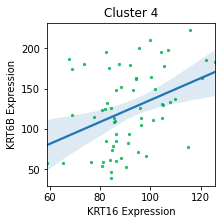

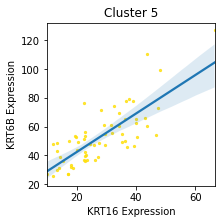

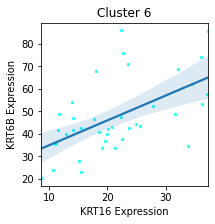

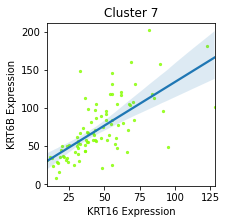

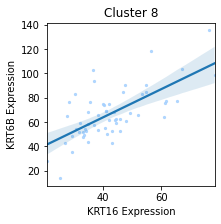

In [38]:
for c_i, i in enumerate([0, 1, 2, 3, 4, 5, 6, 7]):
    clust = i+1
    plot_cluster_scatter('KRT16', 'KRT6B', clust, color=spatialcorr.plot.PALETTE_MANY[c_i])#, xlim=(0, 50), ylim=(0,50))
    plt.title(f'Cluster {clust}')
    plt.show()

In [59]:
df_plot = pairwise_clust_between('KRT16', 'KRT6B')

Kept 468/620 spots.
For cluster pair (2, 1), kept 70/85 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 66. P-value = 0.30303030303030304
For cluster pair (3, 1), kept 153/166 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 50. P-value = 0.4
For cluster pair (3, 2), kept 223/227 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 255. P-value = 0.0784313725490196
For cluster pair (5, 1), kept 27/39 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 26. P-value = 0.7692307692307693
For cluster pair (5, 2), kept 97/100 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 21. P-value = 0.9523809523809523
For cluster pair (5, 3), kept 180/181 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 20. P-value = 1.0
For cluster pair (6, 1), kept 5/28 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used:

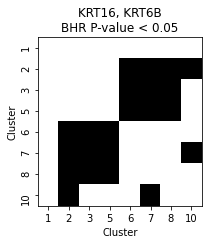

In [61]:
fig, ax = plt.subplots(1,1, figsize=(3, 3.5))
res = sns.heatmap(df_plot, cmap='Greys', cbar=False, ax=ax)
for _, spine in res.spines.items():
    spine.set_visible(True)
ax.set_title('KRT16, KRT6B\nBHR P-value < 0.05')
ax.set_ylabel('Cluster')
ax.set_xlabel('Cluster')
plt.tight_layout()
fig.savefig('./figures/Patient10_KRT16_KRT6B_pairwise_BHR_pvals.pdf', format='pdf')

## Gene pair: KRT10, KRT5

Kept 468/620 spots.
P-value: 0.044
Kept 468/620 spots.
P-value: 0.002


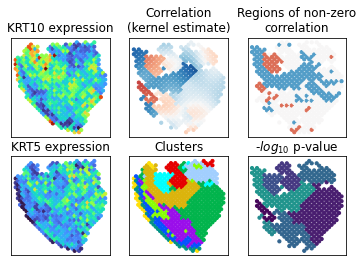

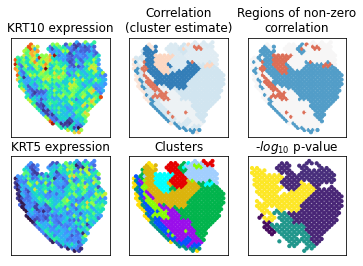

In [82]:
full_analysis_pair_2(
    'KRT10', 'KRT5',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond,
    spot_to_neighbors_clust=bc_to_neighs_full_clust
)
full_analysis_pair_2(
    'KRT10', 'KRT5', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust,
    spot_to_neighbors_clust=bc_to_neighs_full_clust
)

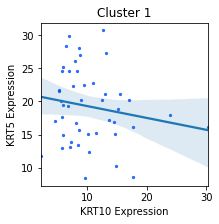

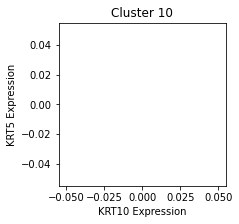

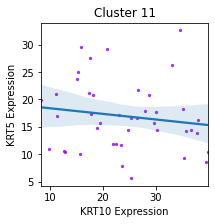

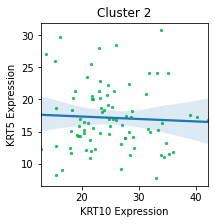

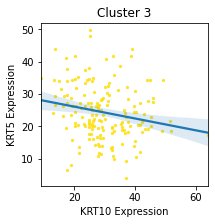

...

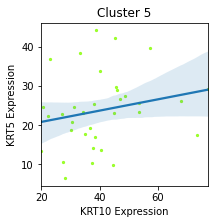

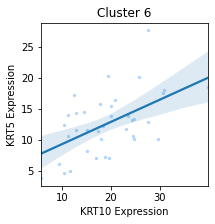

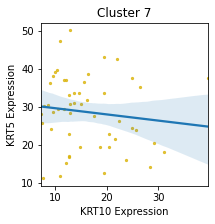

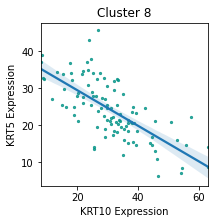

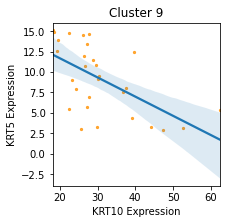

In [84]:
for c_i, i in enumerate([0, 9, 10, 1, 2, 3, 4, 5, 6, 7, 8]):
    clust = str(i+1)
    plot_cluster_scatter('KRT10', 'KRT5', clust, color=spatialcorr.plot.PALETTE_MANY[c_i])#, xlim=(0, 20), ylim=(0,20))
    plt.title(f'Cluster {clust}')
    plt.show()

In [56]:
df_plot = pairwise_clust_between('KRT10', 'KRT5')

Kept 468/620 spots.
For cluster pair (2, 1), kept 70/85 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 150. P-value = 0.13333333333333333
For cluster pair (3, 1), kept 153/166 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 112. P-value = 0.17857142857142858
For cluster pair (3, 2), kept 223/227 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 162. P-value = 0.12345679012345678
For cluster pair (5, 1), kept 27/39 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 96. P-value = 0.20833333333333334
For cluster pair (5, 2), kept 97/100 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 215. P-value = 0.09302325581395349
For cluster pair (5, 3), kept 180/181 spots.
Hit maximum permutations threshold of 20. P-value = 0.012
For cluster pair (6, 1), kept 5/28 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 201. P-va

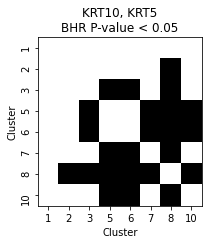

In [58]:
fig, ax = plt.subplots(1,1, figsize=(3, 3.5))
res = sns.heatmap(df_plot, cmap='Greys', cbar=False, ax=ax)
for _, spine in res.spines.items():
    spine.set_visible(True)
ax.set_title('KRT10, KRT5\nBHR P-value < 0.05')
ax.set_ylabel('Cluster')
ax.set_xlabel('Cluster')
plt.tight_layout()
fig.savefig('./figures/Patient10_KRT10_KRT5_pairwise_BHR_pvals.pdf', format='pdf')

In [47]:
df_plot = pairwise_clust_between('KRT14', 'KRT5')

Kept 468/620 spots.
For cluster pair (2, 1), kept 70/85 spots.
Hit maximum permutations threshold of 20. P-value = 0.002
For cluster pair (3, 1), kept 153/166 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 303. P-value = 0.066006600660066
For cluster pair (3, 2), kept 223/227 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 20. P-value = 1.0
For cluster pair (5, 1), kept 27/39 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 273. P-value = 0.07326007326007326
For cluster pair (5, 2), kept 97/100 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 35. P-value = 0.5714285714285714
For cluster pair (5, 3), kept 180/181 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 37. P-value = 0.5405405405405406
For cluster pair (6, 1), kept 5/28 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 20. P-value = 1.0
For cluster p

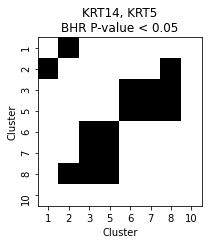

In [55]:
fig, ax = plt.subplots(1,1, figsize=(3, 3.5))
res = sns.heatmap(df_plot, cmap='Greys', cbar=False, ax=ax)
for _, spine in res.spines.items():
    spine.set_visible(True)
ax.set_title('KRT14, KRT5\nBHR P-value < 0.05')
ax.set_ylabel('Cluster')
ax.set_xlabel('Cluster')
plt.tight_layout()
fig.savefig('./figures/Patient2_KRT14_KRT5_pairwise_BHR_pvals.pdf', format='pdf')

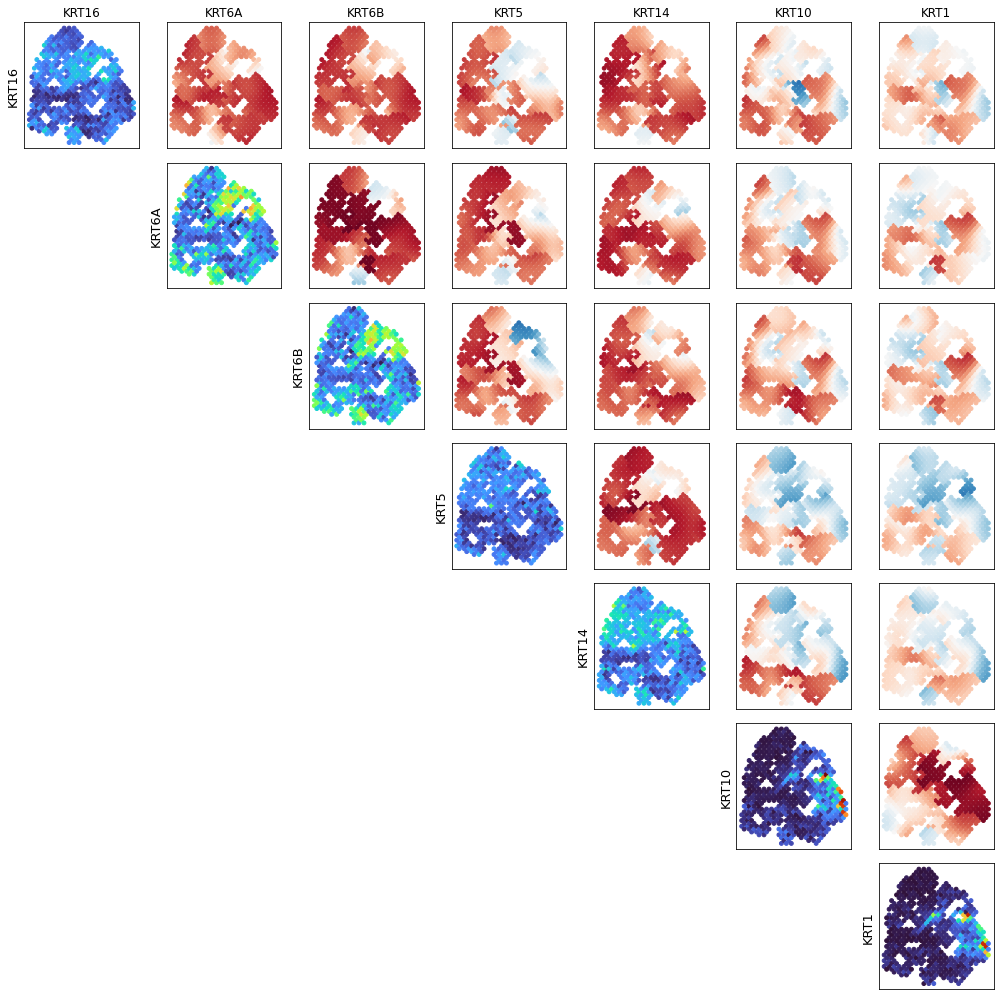

In [74]:
generate_gene_set_plots(
    ['KRT16', 'KRT6A', 'KRT6B', 'KRT5', 'KRT14', 'KRT10', 'KRT1'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=5,
    #pairwise_pvals=data_res['gene_set_to_pairwise_pvals'][gs],
    #pairwise_pvals_2=data_res_2['gene_set_to_pairwise_pvals'][gs],
    corr_magnitude=False,
    plot_conf=False,
    dsize=15,
    fig_path='./figures/P2_keratin_pairwise.pdf'
)

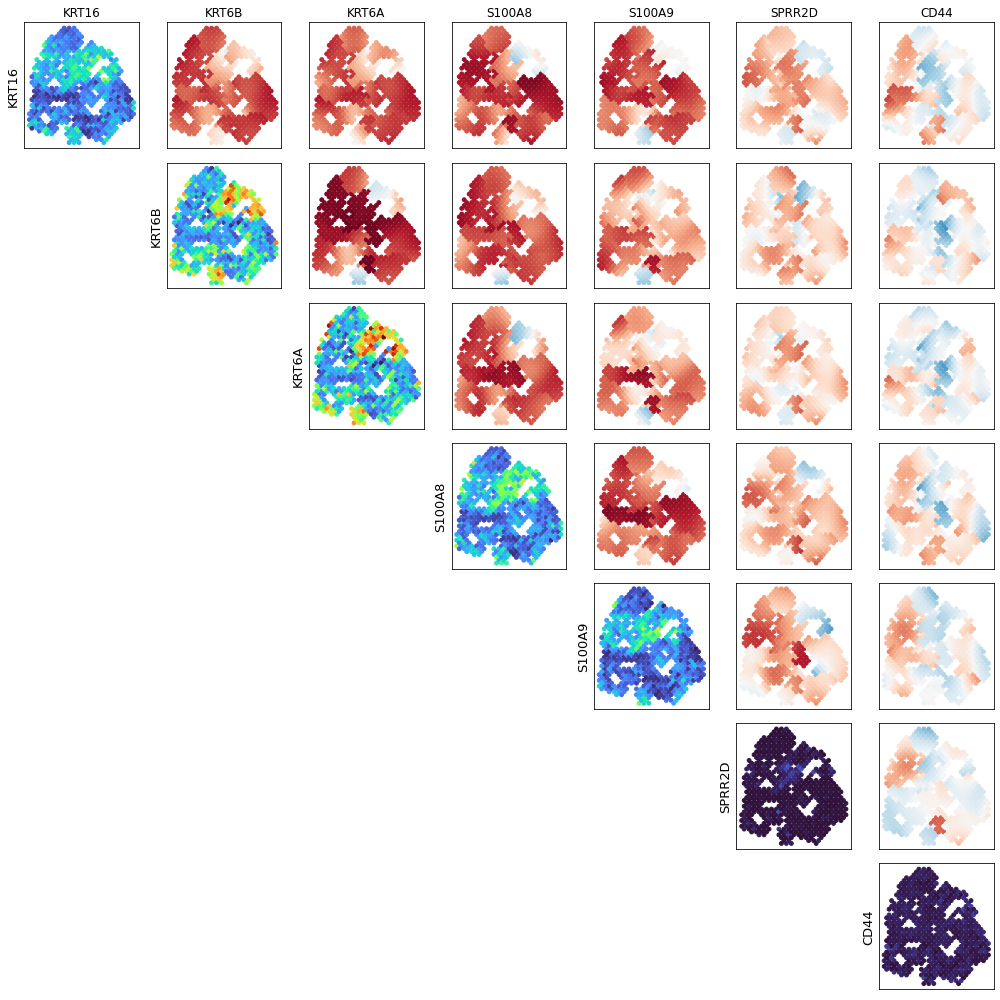

In [53]:

generate_gene_set_plots(
    ['KRT16', 'KRT6B', 'KRT6A', 'S100A8', 'S100A9', 'DEFB3', 'SPRR2D', 'STFA1', 'CD44', 'SERPINB3C'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=5,
    #pairwise_pvals=data_res['gene_set_to_pairwise_pvals'][gs],
    #pairwise_pvals_2=data_res_2['gene_set_to_pairwise_pvals'][gs],
    corr_magnitude=False,
    plot_conf=False,
    dsize=15,
    fig_path='./figures/P2_keratin_pairwise.pdf'
)

Trying to set attribute `.obs` of view, copying.
/Users/matthewbernstein/Development/python3_dev/lib/python3.7/site-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "bbox_layout" which is no longer supported as of 3.3 and will become an error two minor releases later


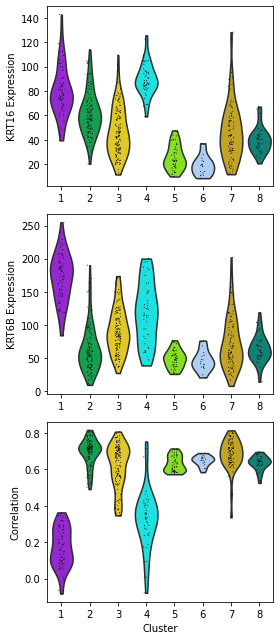

In [32]:


adata_keep = adata.copy()
corrs, keep_inds = spatialcorr.utils.compute_local_correlation(
    adata, 
    'KRT16', 'KRT6B',
    kernel_matrix=None, 
    row_key='row', 
    col_key='col', 
    condition='BayesSpace_11', 
    sigma=5,
    contrib_thresh=10
)
adata_keep = adata_keep[keep_inds,:]
adata_keep.obs['Correlation KRT16 & KRT6B'] = corrs

fig, axarr = plt.subplots(3,1, figsize=(4, 9))
cust_pal = np.array(spatialcorr.plot.PALETTE_MANY)[
    [2, 3, 4, 5, 6, 7, 8, 9, 10]
]
sc.pl.violin(
    adata_keep, 
    'KRT16', 
    groupby='BayesSpace_11', 
    palette=cust_pal, 
    ax=axarr[0], 
    show=False
)
sc.pl.violin(
    adata_keep, 
    'KRT6B', 
    groupby='BayesSpace_11', 
    palette=cust_pal, 
    ax=axarr[1], 
    show=False
)
sc.pl.violin(
    adata_keep, 
    'Correlation KRT16 & KRT6B', 
    groupby='BayesSpace_11', 
    palette=cust_pal, 
    ax=axarr[2], 
    show=False
)

axarr[0].set_xlabel('')
axarr[1].set_xlabel('')
axarr[2].set_xlabel('Cluster')
axarr[0].set_ylabel('KRT16 Expression')
axarr[1].set_ylabel('KRT6B Expression')
axarr[2].set_ylabel('Correlation')
#plt.show()

plt.tight_layout()
fig.savefig('./figures/P2_KRT16_KRT6B_expression_corr_distr_violin.pdf', bbox_layout='tight', format='pdf')

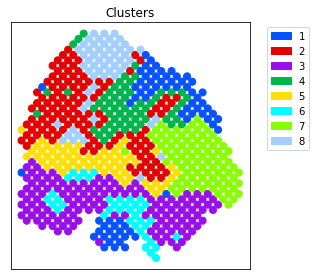

In [39]:
fig, ax = plt.subplots(1,1, figsize=(4.5, 4))
llrtp.plot_slide(
    adata.obs, 
    adata.obs['BayesSpace_11'], 
    cmap='categorical', 
    title="Clusters",
    dsize=50,
    ticks=False,
    figure=fig,
    ax=ax
)

plt.tight_layout()
fig.savefig('./figures/P2_clusters.pdf', format='pdf')


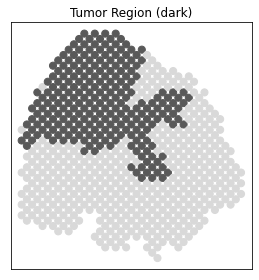

In [41]:
fig, ax = plt.subplots(1,1, figsize=(3.7, 4))
spatialcorr.plot_slide(
    adata.obs, 
    [x in set([2, 4, 8]) for x in adata.obs['BayesSpace_11']], 
    cmap='categorical', 
    title="Tumor Region (dark)",
    dsize=50,
    ticks=False,
    figure=fig,
    ax=ax,
    cat_palette=['#d9d9d9', '#595959']
)

plt.tight_layout()
fig.savefig('./figures/P10_tumor_region.pdf', format='pdf')



## Gene pair: KRT14, KRT5

Kept 468/620 spots.
P-value: 0.014
Kept 468/620 spots.
P-value: 0.002


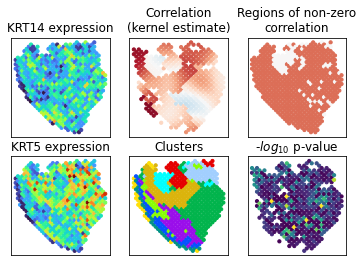

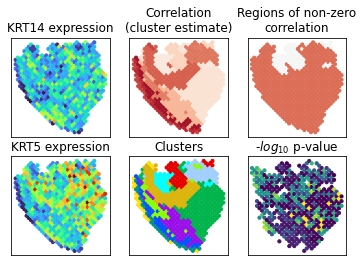

In [87]:
full_analysis_pair_2(
    'KRT14', 'KRT5',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_full_clust
)
full_analysis_pair_2(
    'KRT14', 'KRT5', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust
)

Kept 468/620 spots.
P-value: 0.164
Kept 468/620 spots.
P-value: 0.162


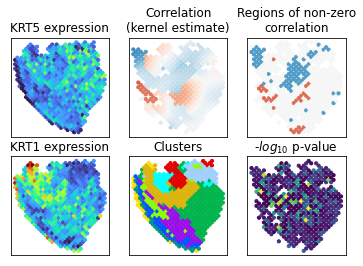

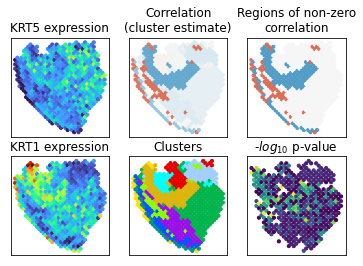

In [88]:
full_analysis_pair_2(
    'KRT5', 'KRT1',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond
)
full_analysis_pair_2(
    'KRT5', 'KRT1', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust
)

plot_gene_set_result(
    j_b_cell_between, 
    'GO_B_CELL_MEDIATED_IMMUNITY', 
    est_type='local',
    data_res_2=j_b_cell_within
)

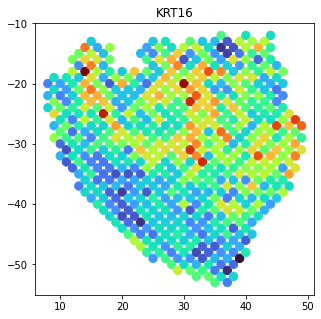

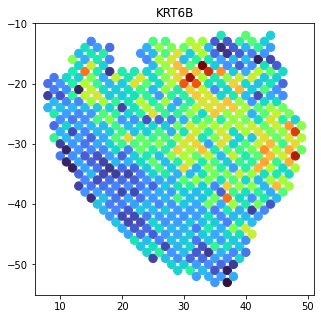

In [120]:
plot_gene('KRT16', adata, cmap='turbo', dsize=70)
plot_gene('KRT6B', adata, cmap='turbo', dsize=70)

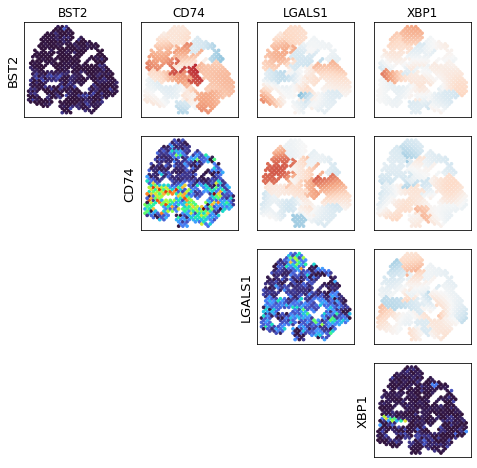

In [68]:
plot_gene_set_result(
    j_b_cell_between, 
    'GO_B_CELL_ACTIVATION', 
    est_type='local',
    data_res_2=j_b_cell_within,
    plot_conf=False
)

In [18]:
def compare_to_permutation(g1, g2, sigma=5):

    ct_to_indices = defaultdict(lambda: [])
    for i, ct in enumerate(adata.obs['BayesSpace_11']):
        ct_to_indices[ct].append(i)

    print("REAL:")
    expr = adata.obs_vector(g1)
    llrtp.plot_slide(
        adata.obs, 
        expr, 
        cmap='turbo', 
        title=g2,
        dsize=10
    )
    plt.title(g1)
    plt.show()


    expr = adata.obs_vector(g2)
    llrtp.plot_slide(
        adata.obs, 
        expr, 
        cmap='turbo', 
        title=g2,
        dsize=10
    )
    plt.title(g2)
    plt.show()
    corrs, kept_inds, _ = spatialcorr.plot_correlation(
        adata,
        g1, g2,
        sigma=sigma,
        contrib_thresh=10,
        kernel_matrix=None,
        row_key='row',
        col_key='col',
        condition='BayesSpace_11',
        cmap='RdBu_r',
        colorbar=True,
        ticks=True,
        estimate='local',
        dsize=13
    )
    plt.show()
    print("PERMUTED:")
    for i in range(5):
        adata_perm = adata.copy()
        perm_coords = spatialcorr.permute_coords(np.arange(adata.obs.shape[0]), ct_to_indices)
        adata_perm.obs = adata.obs.iloc[perm_coords]

        expr = adata_perm.obs_vector(g1)
        llrtp.plot_slide(
            adata_perm.obs, 
            expr, 
            cmap='turbo', 
            title=g1,
            dsize=10
        )
        plt.title(g1)
        plt.show()


        expr = adata_perm.obs_vector(g2)
        llrtp.plot_slide(
            adata_perm.obs, 
            expr, 
            cmap='turbo', 
            title=g2,
            dsize=10
        )
        plt.title(g2)
        plt.show()

        corrs, kept_inds, _ = spatialcorr.plot_correlation(
            adata_perm,
            g1, g2,
            sigma=sigma,
            contrib_thresh=10,
            kernel_matrix=None,
            row_key='row',
            col_key='col',
            condition='BayesSpace_11',
            cmap='RdBu_r',
            colorbar=True,
            ticks=True,
            estimate='local',
            dsize=13
        )
        plt.show()
        
        p_val, t_obs, t_nulls, kept_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
            adata_perm,
            [g1, g2],
            sigma,
            cond_key='BayesSpace_11',
            contrib_thresh=10,
            row_key='row',
            col_key='col',
            verbose=1,
            n_procs=5,
            test_between_conds=False,
            compute_spotwise_pvals=True,
            max_perms=500,
            mc_pvals=False
        )
        print("P-value: ", p_val)

#compare_to_permutation('CD74', 'IGHG3')  # Sig
#compare_to_permutation('CD74', 'IGHG4')   # Not sig



#compare_to_permutation('IGHG3', 'IGLC2')

#compare_to_permutation('IGKC', 'IGHG3') # Not sig

In [ ]:
p_val, t_obs, t_nulls, kept_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals_1 = spatialcorr.run_test(
    adata,
    ['IGKC', 'IGHG3'],
    5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=False,
    compute_spotwise_pvals=True,
    max_perms=500,
    mc_pvals=False
)
p_val, t_obs, t_nulls, kept_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals_2 = spatialcorr.run_test(
    adata,
    ['CD74', 'IGHG3'],
    5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=False,
    compute_spotwise_pvals=True,
    max_perms=500,
    mc_pvals=False
)

sns.kdeplot(spot_p_vals_1, color='red')
sns.kdeplot(spot_p_vals_2, color='blue')
plt.show()

sns.histplot(spot_p_vals_1, color='red', alpha=0.2, bins=30)
sns.histplot(spot_p_vals_2, color='blue', alpha=0.2, bins=30)
plt.show()

sns.histplot(-1 * np.log10(spot_p_vals_1), color='red', alpha=0.2)
sns.histplot(-1 * np.log10(spot_p_vals_2), color='blue', alpha=0.2)
plt.show()

sns.kdeplot(-1 * np.log10(spot_p_vals_1), color='red')
sns.kdeplot(-1 * np.log10(spot_p_vals_2), color='blue')
plt.show()

In [ ]:
corrs, kept_inds = plot_within('CD74', 'IGHG3', sigma=7)
spatialcorr.plot_local_scatter(
    adata[kept_inds,:],
    'CD74', 'IGHG3',
    62,
    60,
    corrs,
    color_spots=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    cmap='RdBu_r',
    neighb_color='red'
)

#### Why did the WHR-Test not reject on the pair IGHG4, IGLC2?

It looks like this is due to an outlier

In [ ]:
corrs, kept_inds = plot_within('IGHG4', 'IGLC2', sigma=7)
spatialcorr.plot_local_scatter(
    adata[kept_inds,:],
    'IGHG4', 'IGLC2',
    11,
    39,
    corrs,
    color_spots=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    cmap='RdBu_r',
    neighb_color='red'
)

# GO Interferon Gamma Mediated Signaling Pathway

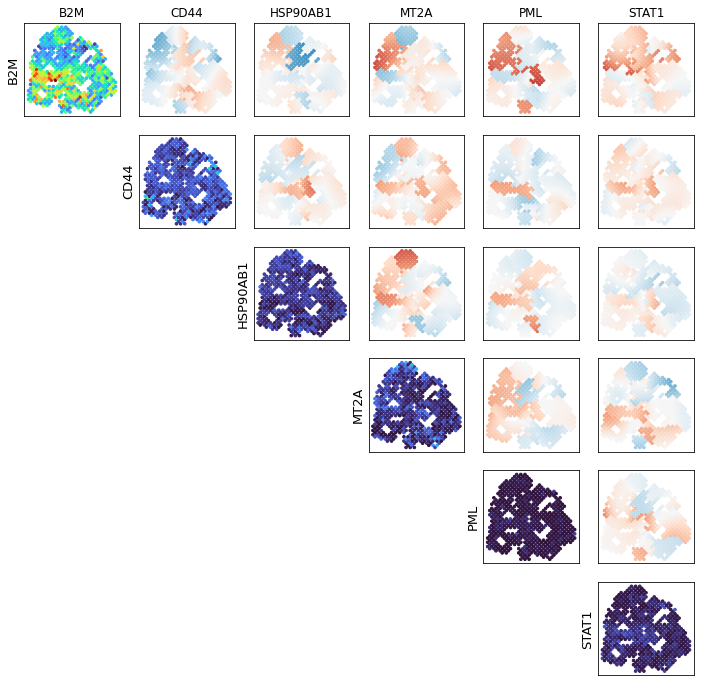

In [69]:
plot_gene_set_result(
    j_interferon_between, 
    'GO_INTERFERON_GAMMA_MEDIATED_SIGNALING_PATHWAY', 
    est_type='local',
    data_res_2=j_interferon_within,
    plot_conf=False
)

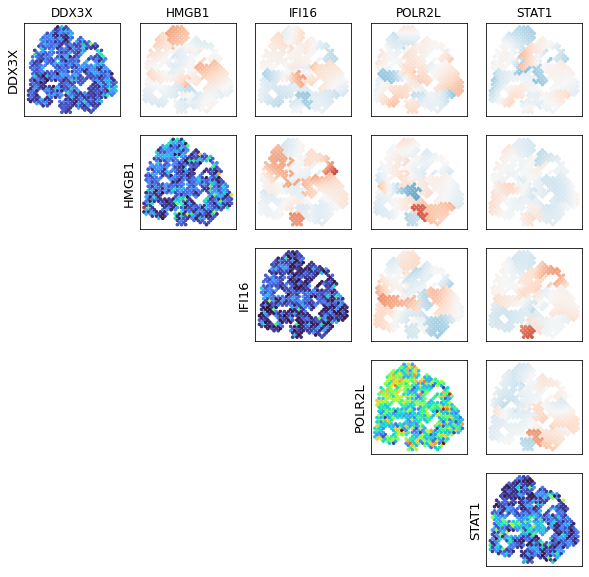

In [70]:
plot_gene_set_result(
    j_interferon_between, 
    'GO_POSITIVE_REGULATION_OF_TYPE_I_INTERFERON_PRODUCTION', 
    est_type='local',
    data_res_2=j_interferon_within,
    plot_conf=False,
)

# GO Epidermis Development

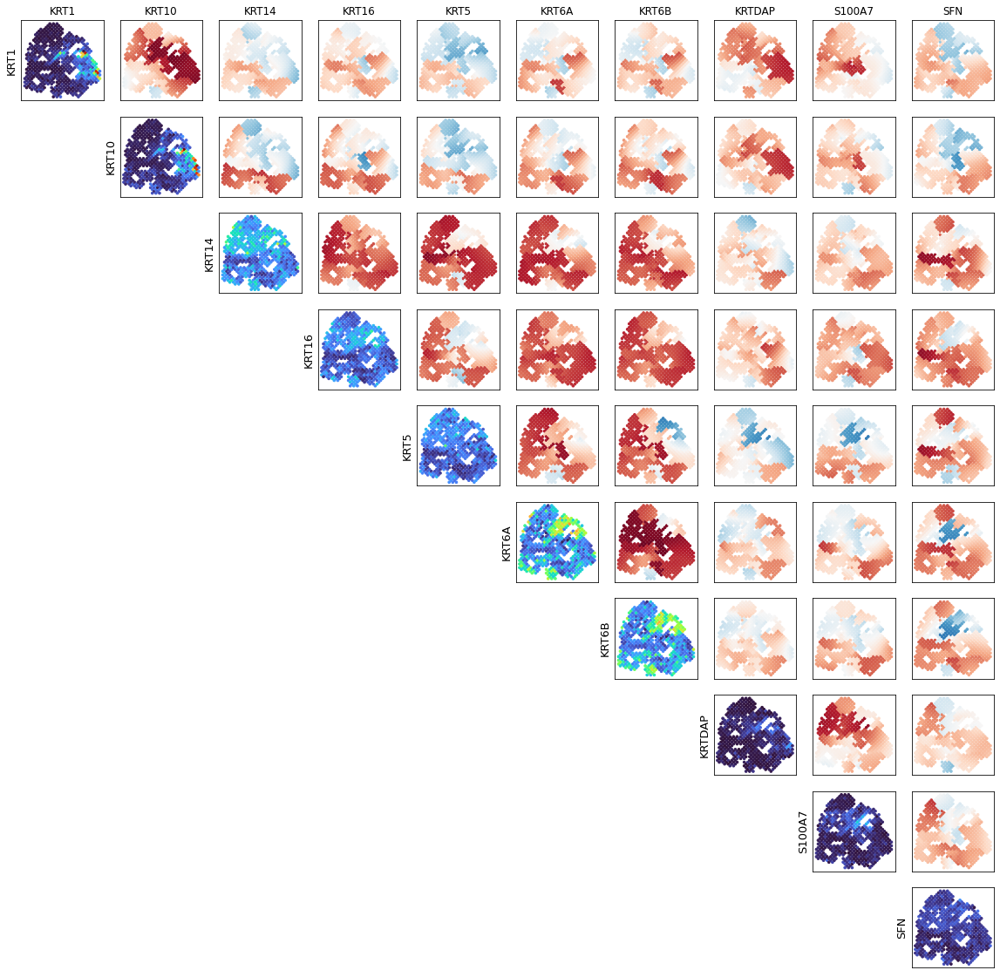

In [71]:
plot_gene_set_result(
    j_epidermis_dev_between, 
    'GO_EPIDERMIS_DEVELOPMENT', 
    est_type='local',
    data_res_2=j_epidermis_dev_within,
    plot_conf=False  
)

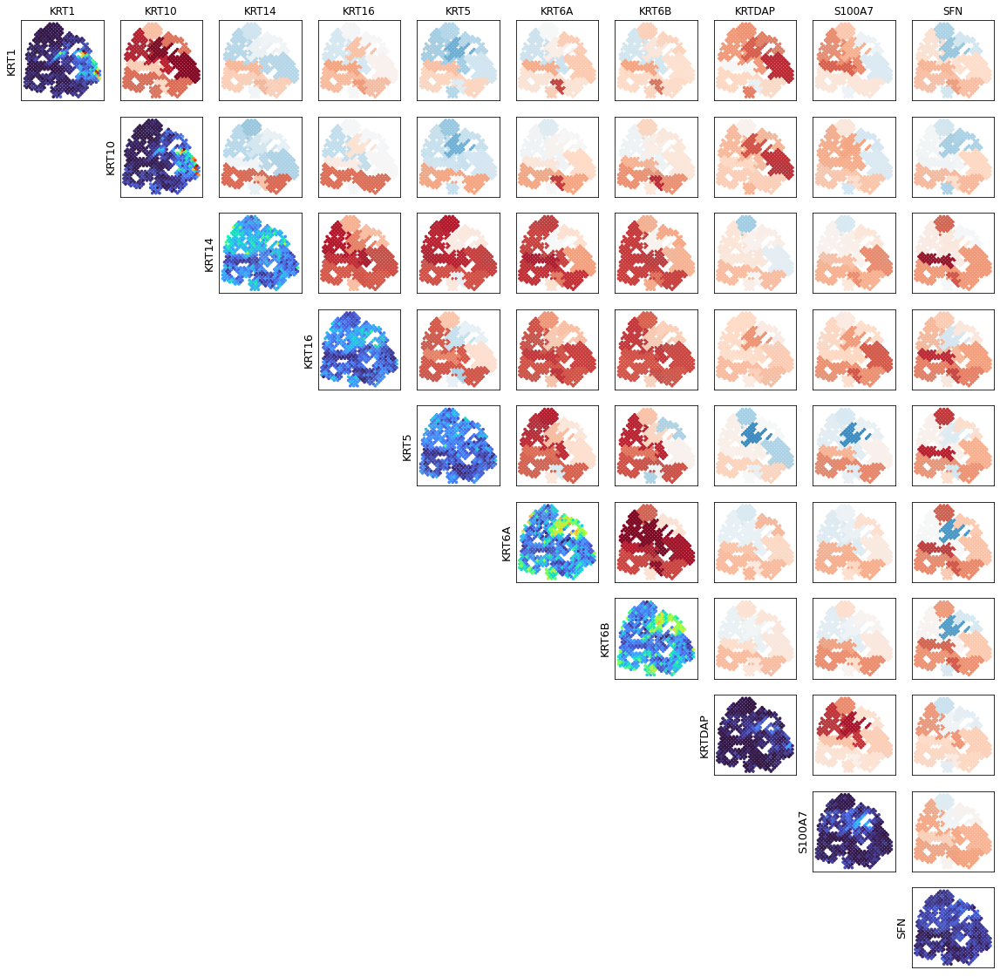

In [72]:
plot_gene_set_result(
    j_epidermis_dev_between, 
    'GO_EPIDERMIS_DEVELOPMENT', 
    est_type='regional',
    data_res_2=j_epidermis_dev_within,
    plot_conf=False  
)

## Gene pair of interest:  S100A7 and KRT5

Kept 3424/3820 spots.
Shape of neighborhood nulls matrix:  (3424, 100)
P-value: 0.002
Kept 3424/3820 spots.
Shape of neighborhood nulls matrix:  (3424, 100)
P-value: 0.002


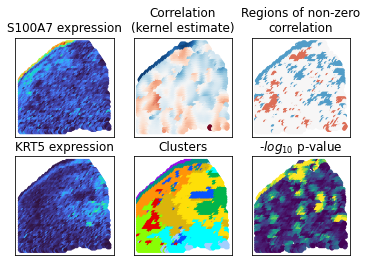

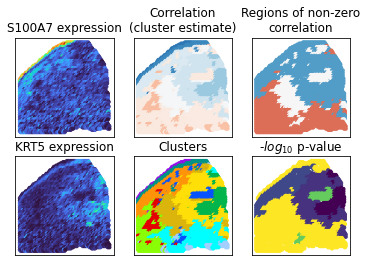

In [122]:
full_analysis_pair_2(
    'S100A7', 'KRT5',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond
)
full_analysis_pair_2(
    'S100A7', 'KRT5', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust
)

In [ ]:
##

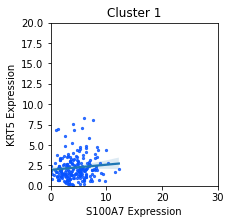

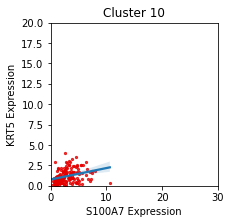

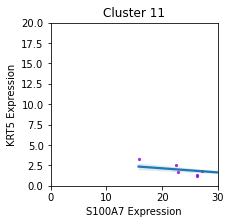

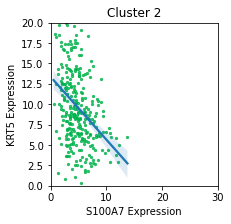

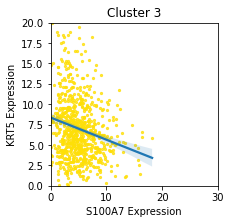

...

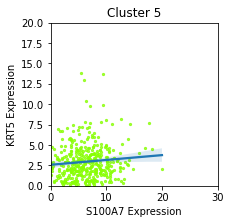

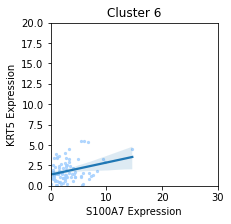

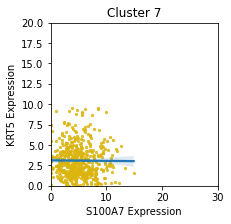

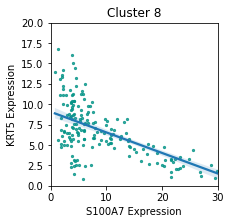

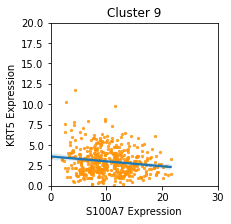

In [83]:
import matplotlib as mpl
for c_i, i in enumerate([0, 9, 10, 1, 2, 3, 4, 5, 6, 7, 8]):
    clust = str(i+1)
    plot_cluster_scatter('S100A7', 'KRT5', clust, color=spatialcorr.plot.PALETTE_MANY[c_i], xlim=(0, 30), ylim=(0,20))
    #plot_cluster_mvn('S100A7', 'KRT5', clust, xlim=(0, 30), ylim=(0,20))
    plt.title(f'Cluster {clust}')
    plt.show()

## Gene pair of interest KRT16 and S100A8

Kept 3424/3820 spots.
Shape of neighborhood nulls matrix:  (3424, 100)


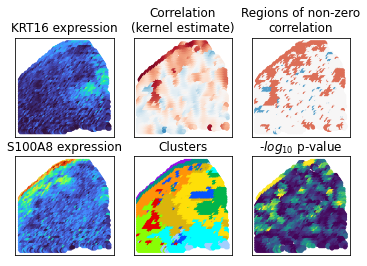

In [56]:
full_analysis_pair_2(
    'KRT16', 'S100A8', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond
)

# GO Regulation of Epidermis Development

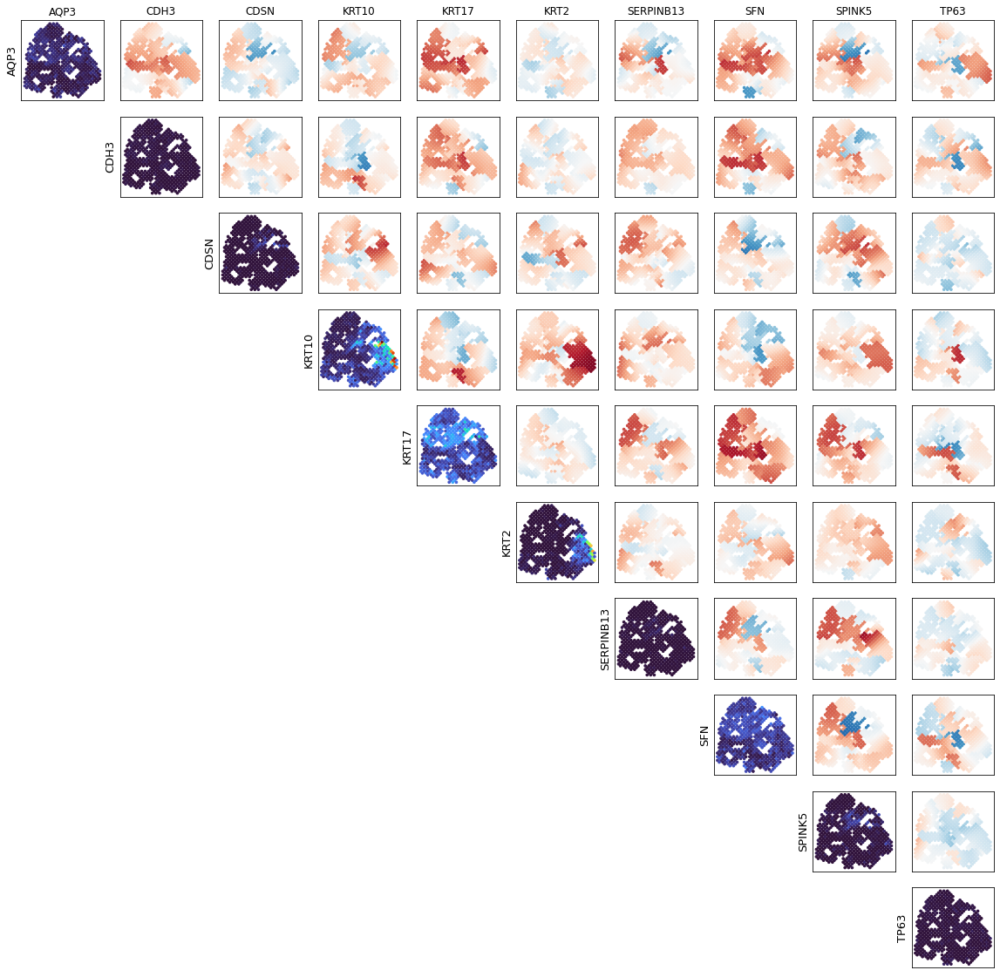

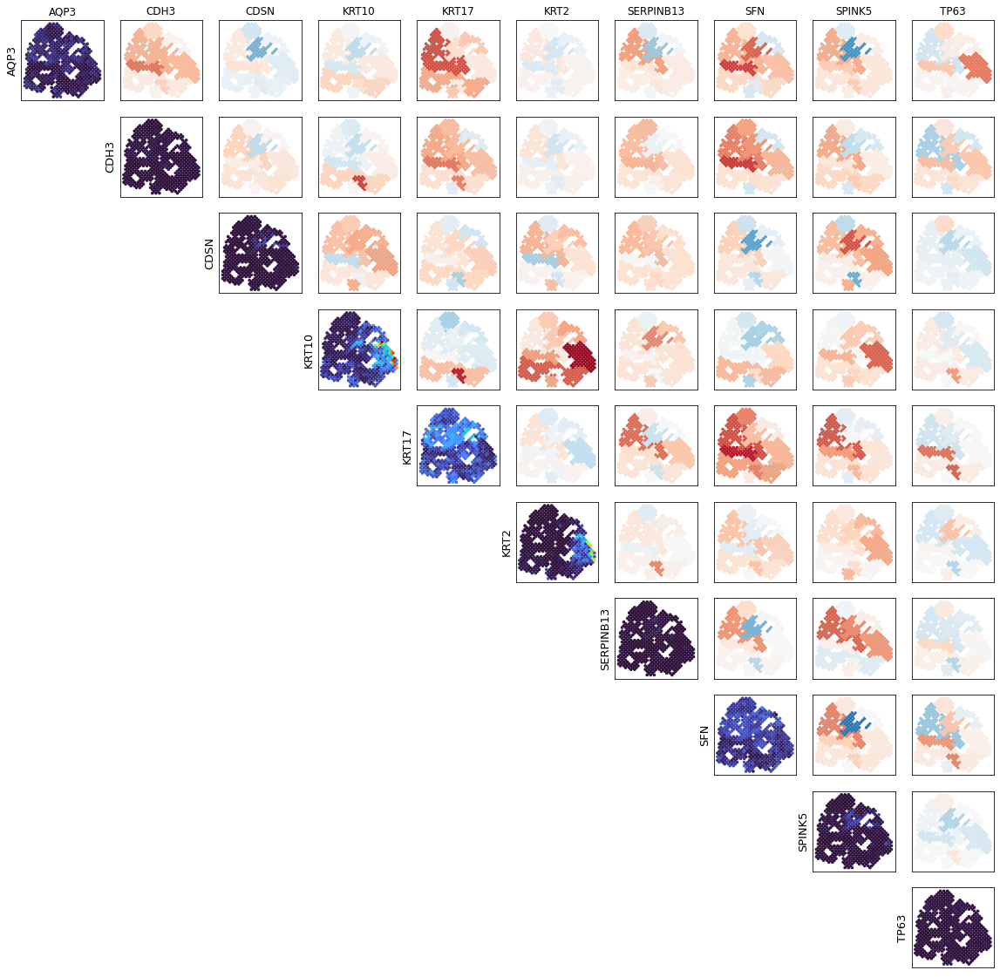

In [56]:
plot_gene_set_result(
    j_epidermis_dev_between, 
    'GO_REGULATION_OF_EPIDERMIS_DEVELOPMENT', 
    est_type='local',
    data_res_2=j_epidermis_dev_within,
    plot_conf=False 
)
plot_gene_set_result(
    j_epidermis_dev_between, 
    'GO_REGULATION_OF_EPIDERMIS_DEVELOPMENT', 
    est_type='regional',
    data_res_2=j_epidermis_dev_within,
    plot_conf=False 
)

Kept 3424/3820 spots.
P-value: 0.002
Kept 3424/3820 spots.
P-value: 0.132


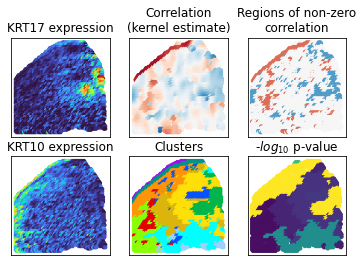

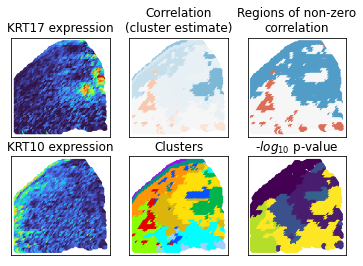

In [60]:
full_analysis_pair_2(
    'KRT17', 'KRT10',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond,
    spot_to_neighbors_clust=bc_to_neighs_full_clust
)
full_analysis_pair_2(
    'KRT17', 'KRT10', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust,
    spot_to_neighbors_clust=bc_to_neighs_full_clust
)

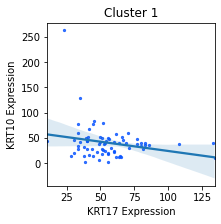

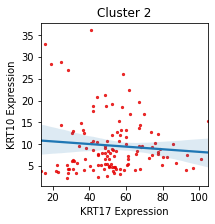

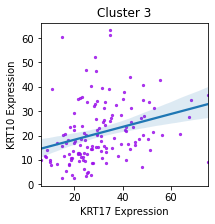

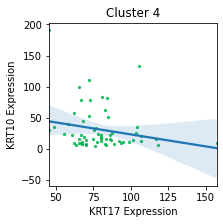

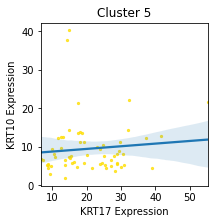

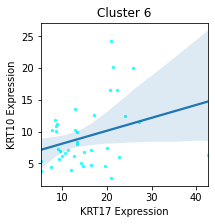

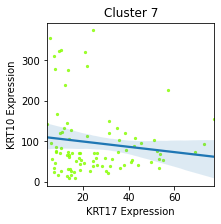

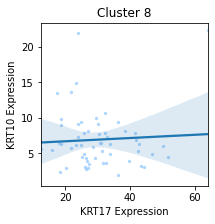

In [58]:
import matplotlib as mpl
for c_i, i in enumerate([0, 1, 2, 3, 4, 5, 6, 7]):
    clust = i+1
    plot_cluster_scatter('KRT17', 'KRT10', clust, color=spatialcorr.plot.PALETTE_MANY[c_i])
    #plot_cluster_mvn('S100A7', 'KRT5', clust, xlim=(0, 30), ylim=(0,20))
    plt.title(f'Cluster {clust}')
    plt.show()

# GO Apoptotic signalling pathway

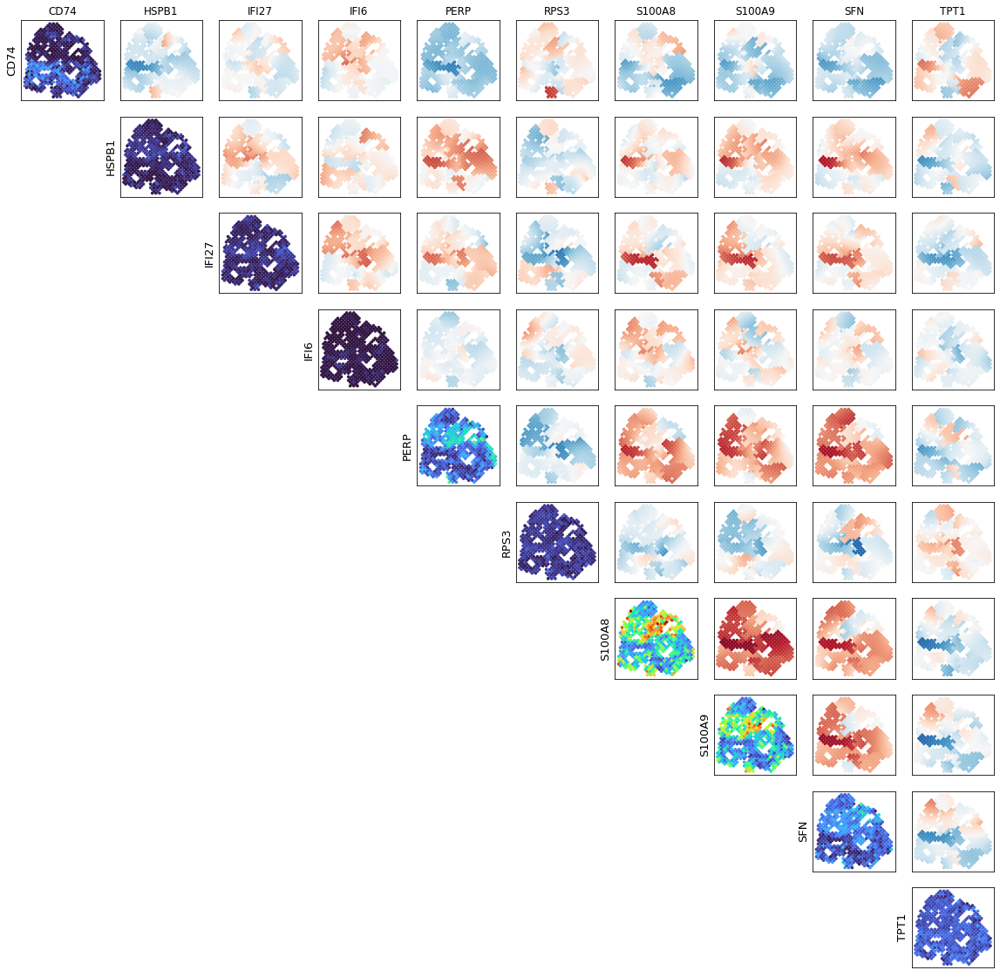

In [59]:
plot_gene_set_result(
    j_apoptosis_between, 
    'GO_APOPTOTIC_SIGNALING_PATHWAY', 
    est_type='local',
    data_res_2=j_apoptosis_within,
    plot_conf=False
)

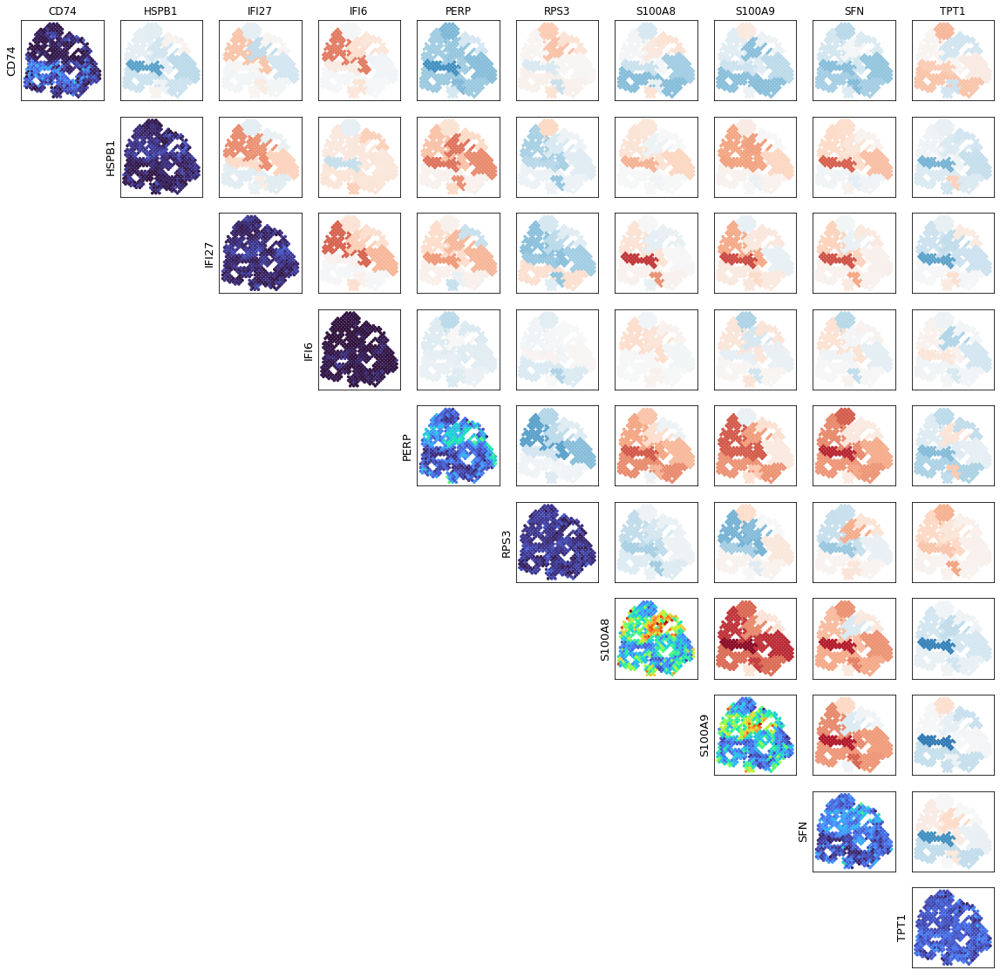

In [60]:
plot_gene_set_result(
    j_apoptosis_between, 
    'GO_APOPTOTIC_SIGNALING_PATHWAY', 
    est_type='regional',
    data_res_2=j_apoptosis_within,
    plot_conf=False
)

## GO Positive Regulation of Apoptotic Signaling Pathway

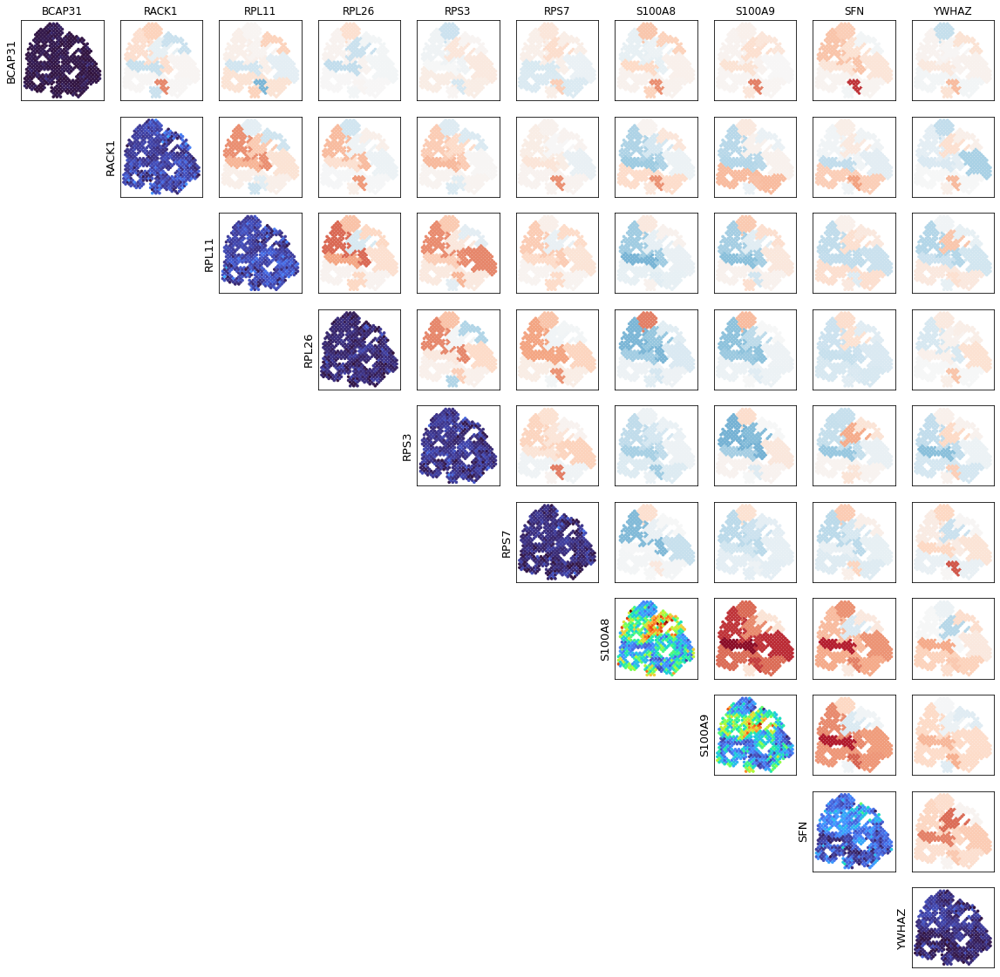

In [61]:
plot_gene_set_result(
    j_apoptosis_between, 
    'GO_POSITIVE_REGULATION_OF_APOPTOTIC_SIGNALING_PATHWAY', 
    est_type='regional',
    data_res_2=j_apoptosis_within,
    plot_conf=False
)

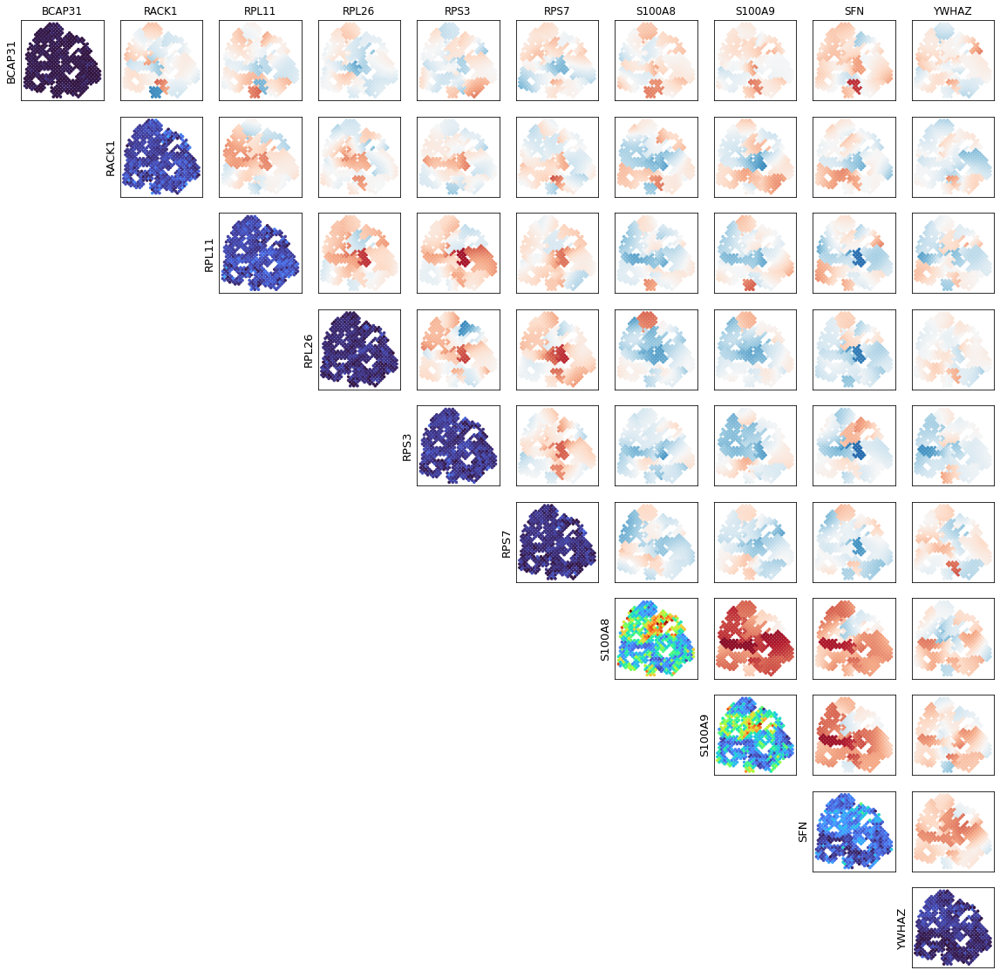

In [62]:
plot_gene_set_result(
    j_apoptosis_between, 
    'GO_POSITIVE_REGULATION_OF_APOPTOTIC_SIGNALING_PATHWAY', 
    est_type='local',
    data_res_2=j_apoptosis_within,
    plot_conf=False
)

# GO Intrinsic Apoptotic Signaling Pathway in Response to DNA Damage by P53 Class Mediator

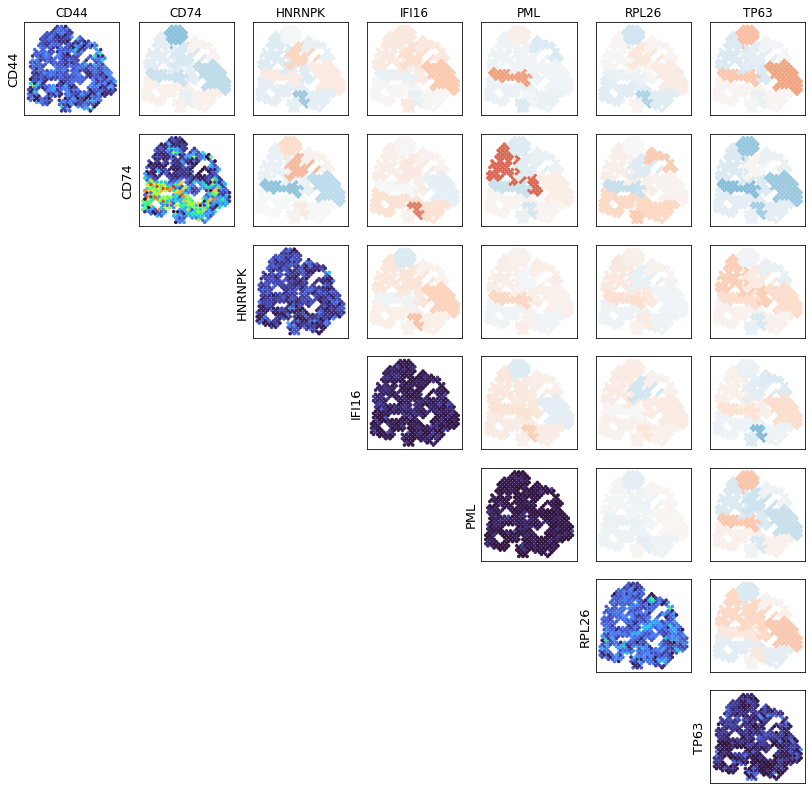

In [63]:
plot_gene_set_result(
    j_apoptosis_between, 
    'GO_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY_IN_RESPONSE_TO_DNA_DAMAGE_BY_P53_CLASS_MEDIATOR', 
    est_type='regional',
    data_res_2=j_apoptosis_within,
    plot_conf=False
)


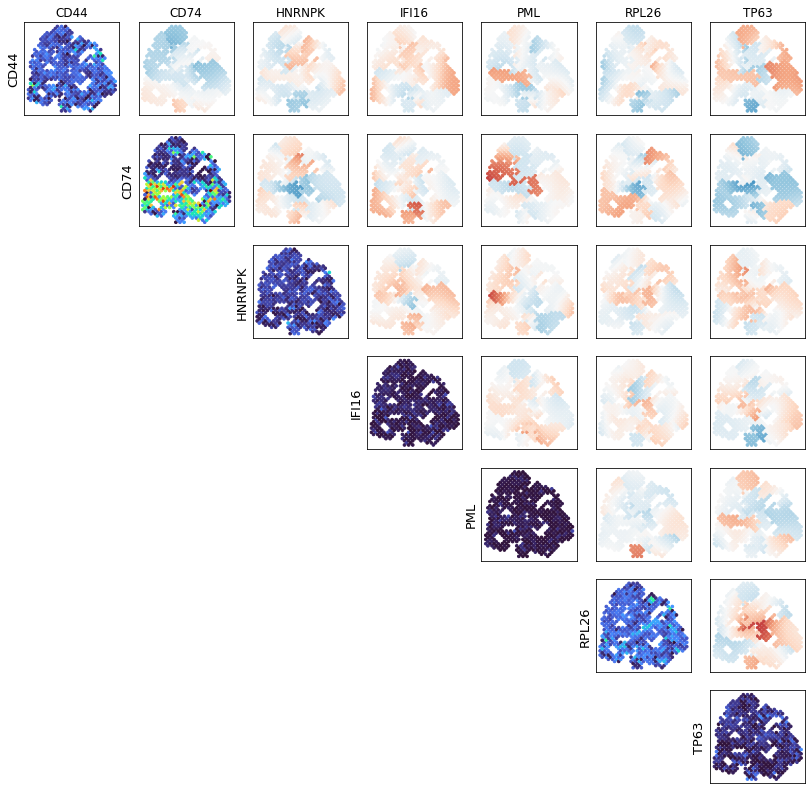

In [64]:
plot_gene_set_result(
    j_apoptosis_between, 
    'GO_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY_IN_RESPONSE_TO_DNA_DAMAGE_BY_P53_CLASS_MEDIATOR', 
    est_type='local',
    data_res_2=j_apoptosis_within,
    plot_conf=False
)



## Gene pair of interest: RPL26, TP63

Kept 553/645 spots.
P-value: 0.262


TypeError: loop of ufunc does not support argument 0 of type dict which has no callable log10 method

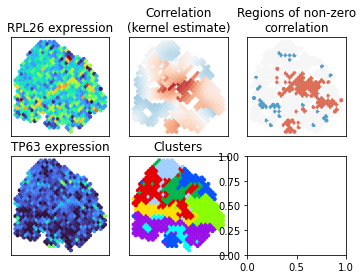

In [65]:
full_analysis_pair_2(
    'RPL26', 'TP63',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond
)
full_analysis_pair_2(
    'RPL26', 'TP63', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust
)

In [ ]:
for c_i, i in enumerate([0, 1, 2, 3, 4, 5, 6, 7]):
    clust = i+1
    plot_cluster_scatter('RPL26', 'TP63', clust, color=spatialcorr.plot.PALETTE_MANY[c_i], xlim=(0, 3), ylim=(0,3))
    plt.title(f'Cluster {clust}')
    plt.show()

Kept 3424/3820 spots.
Shape of neighborhood nulls matrix:  (3424, 100)
P-value: 0.354
Kept 3424/3820 spots.
Shape of neighborhood nulls matrix:  (3424, 100)
P-value: 0.006


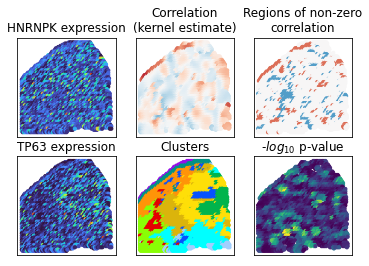

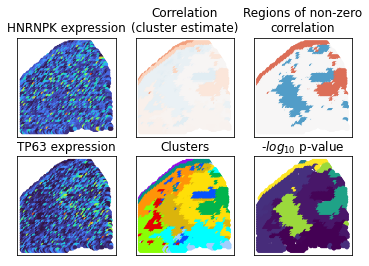

In [115]:
full_analysis_pair_2(
    'HNRNPK', 'TP63',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond
)
full_analysis_pair_2(
    'HNRNPK', 'TP63', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust
)

# GO Regulation of T Cell Activation

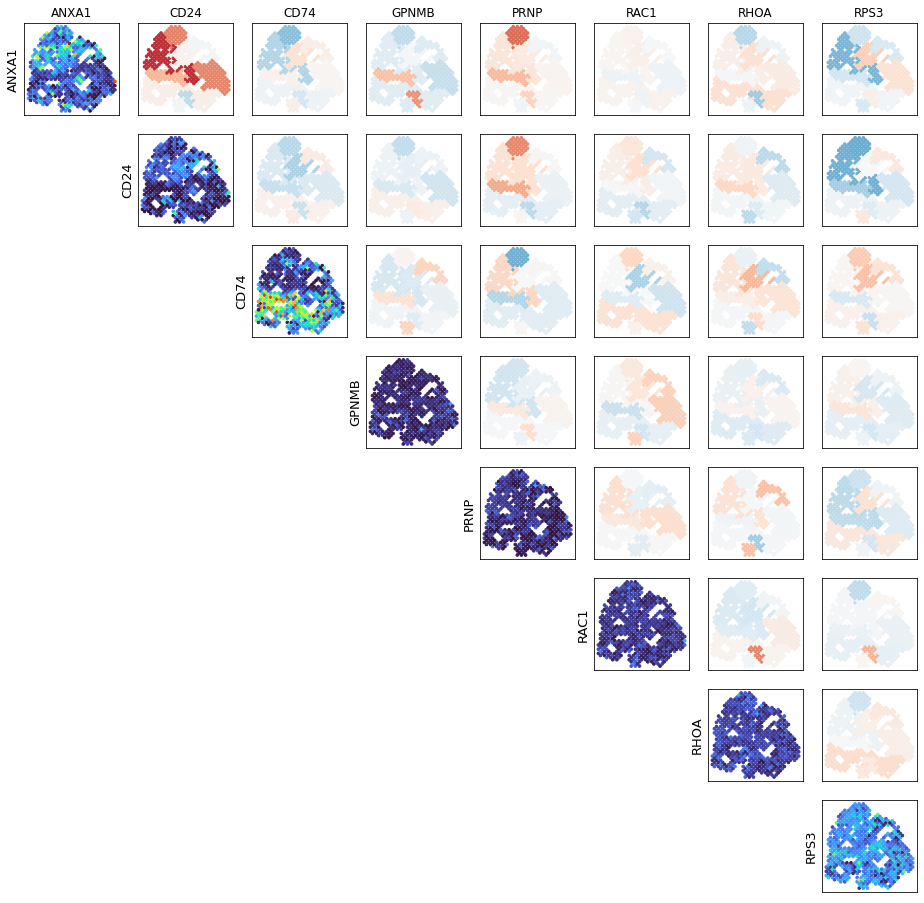

In [66]:
plot_gene_set_result(
    j_t_cell_between, 
    'GO_REGULATION_OF_T_CELL_ACTIVATION', 
    est_type='regional',
    data_res_2=j_t_cell_within,
    plot_conf=False
)

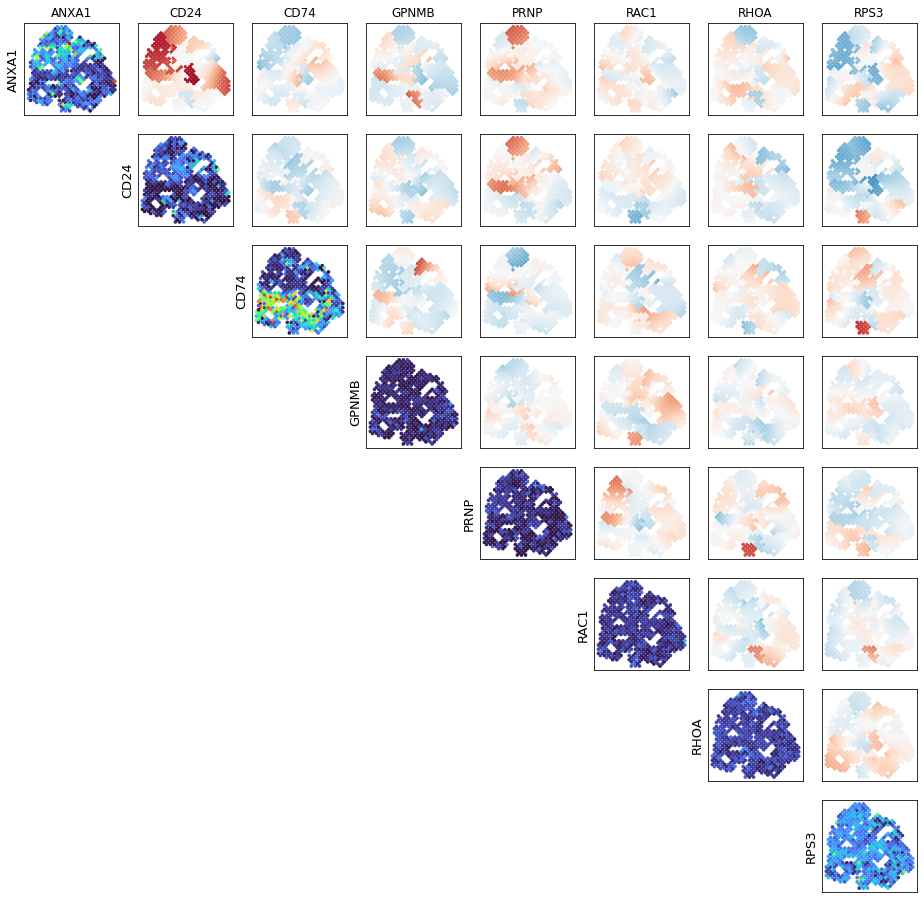

In [67]:
plot_gene_set_result(
    j_t_cell_between, 
    'GO_REGULATION_OF_T_CELL_ACTIVATION', 
    est_type='local',
    data_res_2=j_t_cell_within,
    plot_conf=False
)

In [138]:
gps, all_corrs = compute_pairwise_corrs(j_t_cell_within['gene_set_to_pairwise_pvals']['GO_REGULATION_OF_T_CELL_ACTIVATION'])

KeyError: 'Could not find key HLA-DPA1 in .var_names or .obs.columns.'

['#66c2a5', '#fc8d62', '#8da0cb', '#e78ac3', '#a6d854', '#ffd92f', '#e5c494', '#b3b3b3']


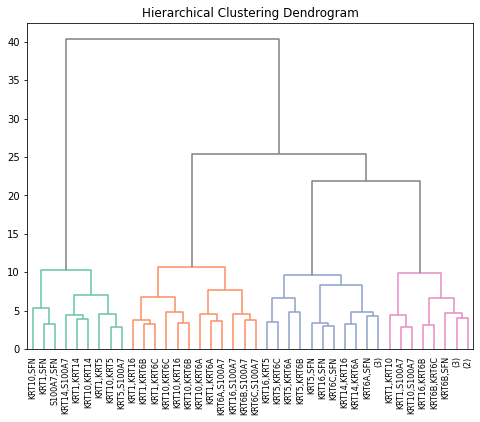

In [139]:
cluster_corrs(gps, all_corrs, color_thresh=12)

## Gene pair of interest: CD24, ANXA1

Kept 468/620 spots.
P-value: 0.834
Kept 468/620 spots.
P-value: 0.698


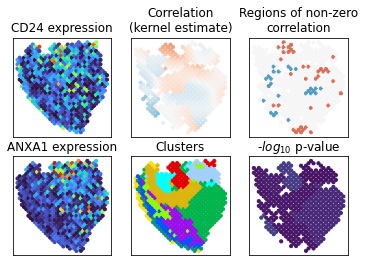

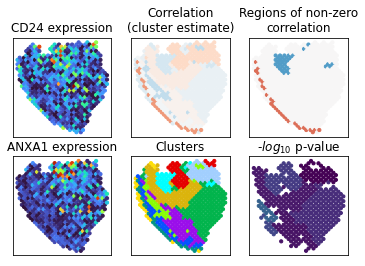

In [140]:
full_analysis_pair_2(
    'CD24', 'ANXA1',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond,
    spot_to_neighbors_clust=bc_to_neighs_full_clust
)
full_analysis_pair_2(
    'CD24', 'ANXA1', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust,
    spot_to_neighbors_clust=bc_to_neighs_full_clust
)

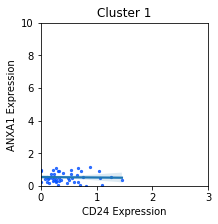

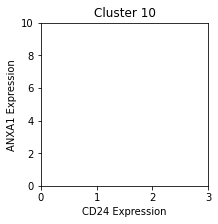

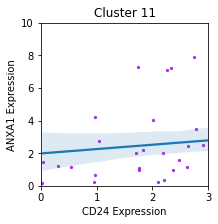

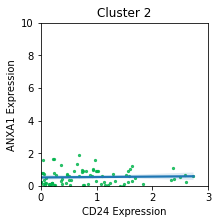

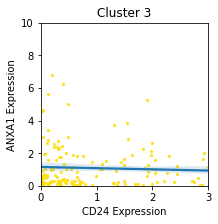

...

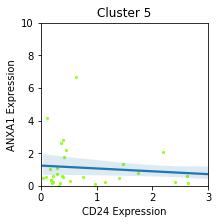

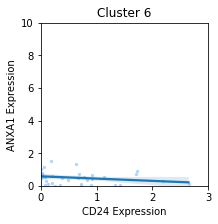

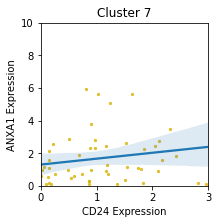

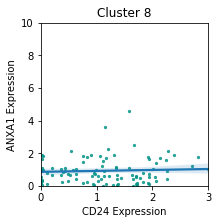

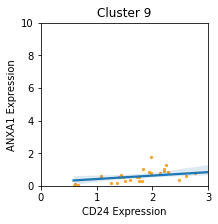

In [141]:
for c_i, i in enumerate([0, 9, 10, 1, 2, 3, 4, 5, 6, 7, 8]):
    clust = str(i+1)
    plot_cluster_scatter('CD24', 'ANXA1', clust, color=spatialcorr.plot.PALETTE_MANY[c_i], xlim=(0, 3), ylim=(0,10))
    plt.title(f'Cluster {clust}')
    plt.show()

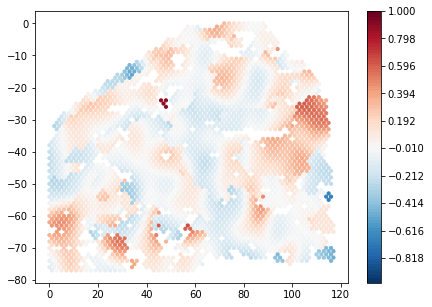

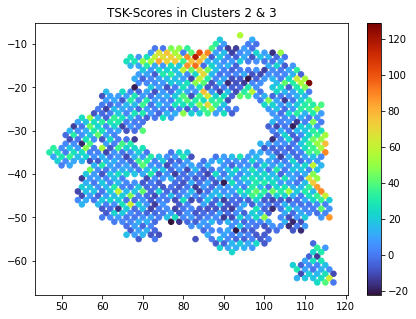

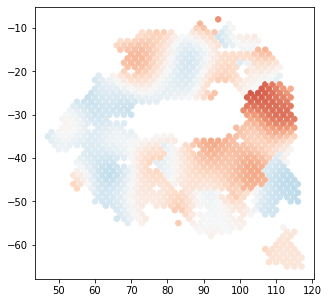

In [67]:
#corrs, keep_inds = corr_pos_neg('ANXA1', 'CD24', adata, bc_to_neighs=bc_to_neighs)
#corrs, keep_inds = plot_within('ANXA1', 'CD24', adata)
corrs, keep_inds, _ = spatialcorr.plot_correlation(
    adata,
    'ANXA1', 'CD24',
    sigma=5,
    contrib_thresh=10,
    kernel_matrix=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    cmap='RdBu_r',
    colorbar=True,
    ticks=True,
    estimate='local',
    dsize=10
)

plot_inds = sorted(set(clust_to_indices['3']+clust_to_indices['2']) & set(keep_inds))
corrs_restrict = [
    corr
    for corr, ind
    in zip(corrs, keep_inds)
    if ind in set(plot_inds)
]
inds_restrict = [
    ind
    for corr, ind
    in zip(corrs, keep_inds)
    if ind in set(plot_inds)
]
llrtp.plot_slide(
    adata.obs.iloc[plot_inds], 
    tsk_scores[plot_inds], 
    cmap='turbo',
    #vmin=-25,
    #vmax=100,
    colorbar=True,
    title='TSK-Scores in Clusters 2 & 3',
    dsize=30
)
plt.show()
llrtp.plot_slide(
    adata.obs.iloc[inds_restrict], 
    corrs_restrict, 
    cmap='RdBu_r',
    vmin=-1,
    vmax=1,
    dsize=30
)
plt.show()


JUNK?

In [ ]:
corrs, kept_inds, _ = spatialcorr.plot_correlation(
    adata,
    'IRF3', 'IRF7',
    sigma=7,
    contrib_thresh=10,
    kernel_matrix=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    corr_magnitude=False,
    cmap='RdBu_r',
    colorbar=False,
    ticks=False,
    ax=None,
    figure=None,
    estimate='local',
    dsize=3
)
plt.show()
spatialcorr.plot_local_scatter(
    adata[kept_inds,:],
    'IRF3', 'IRF7',
    47,
    21,
    corrs,
    color_spots=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    cmap='RdBu_r',
    neighb_color='red'
)

In [ ]:
plot_gene_set_result_between(j_interferon_between, 'GO_POSITIVE_REGULATION_OF_INTERFERON_GAMMA_BIOSYNTHETIC_PROCESS')

In [ ]:
sns.histplot(adata.obs_vector('KRT10'))
plt.show()

sns.histplot(adata.obs_vector('KRT17'))
plt.show()

sns.histplot(adata.obs_vector('SFN'))
plt.show()

In [ ]:
generate_gene_set_plots(
    ['HLA-E', 'IFI27', 'IFI6'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=7
)
generate_gene_set_plots(
    ['HLA-E', 'IFI27', 'IFI6'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='regional',
    sigma=7
)

In [ ]:
generate_gene_set_plots(
    ['RPL3', 'RPS2'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=7
)
generate_gene_set_plots(
    ['RPL3', 'RPS2'],
    adata,
    condition='BayesSpace_11',
    estimate_type='regional',
    sigma=7
)


In [ ]:
generate_gene_set_plots(
    ['CD74', 'HSPB1', 'IFI27', 'IFI6', 'PERP', 'RPS3', 'S100A8', 'S100A9', 'SFN', 'TPT1'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=7
)
generate_gene_set_plots(
    ['CD74', 'HSPB1', 'IFI27', 'IFI6', 'PERP', 'RPS3', 'S100A8', 'S100A9', 'SFN', 'TPT1'],
    adata,
    condition='BayesSpace_11',
    estimate_type='regional',
    sigma=7
)

In [ ]:
generate_gene_set_plots(
    [
        "CD74",
        "HSPB1",
        "IFI6",
        "RPS3",
        "S100A8",
        "S100A9",
        "SFN",
        "TPT1"
    ], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=7
)
generate_gene_set_plots(
    [
        "CD74",
        "HSPB1",
        "IFI6",
        "RPS3",
        "S100A8",
        "S100A9",
        "SFN",
        "TPT1"
    ], 
    adata,
    condition='BayesSpace_11',
    estimate_type='regional',
    sigma=7
)

In [ ]:
p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['KRT10', 'KRT17'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=True,
    compute_spotwise_pvals=True,
    max_perms=500,
    standardize_var=False
)
print("P-value: ", p_val)

p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['KRT10', 'KRT17'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=True,
    compute_spotwise_pvals=True,
    max_perms=500,
    standardize_var=True
)
print("P-value: ", p_val)

In [ ]:
p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['KRT14', 'KRT16'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=True,
    compute_spotwise_pvals=True,
    max_perms=500,
    standardize_var=False
)
print("P-value: ", p_val)

p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['KRT14', 'KRT16'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=False,
    compute_spotwise_pvals=True,
    max_perms=500,
    standardize_var=True
)
print("P-value: ", p_val)

In [ ]:
p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['S100A7', 'KRT1'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=True,
    compute_spotwise_pvals=True,
    max_perms=500,
    standardize_var=False
)
print("P-value: ", p_val)

p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['S100A7', 'KRT1'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=False,
    compute_spotwise_pvals=True,
    max_perms=500,
    standardize_var=True
)
print("P-value: ", p_val)

In [ ]:
p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['SFN', 'KRT1'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=True,
    compute_spotwise_pvals=False,
    max_perms=500,
    standardize_var=False
)
print("P-value: ", p_val)

p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['SFN', 'KRT1'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=False,
    compute_spotwise_pvals=False,
    max_perms=500,
    standardize_var=True
)
print("P-value: ", p_val)

In [ ]:
generate_gene_set_plots(
    ['KRT1', 'KRT14', 'KRT16', 'KRT6A', 'KRT6B', 'S100A7', 'SFN'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=7
)
generate_gene_set_plots(
    ['KRT1', 'KRT14', 'KRT16', 'KRT6A', 'KRT6B', 'S100A7', 'SFN'],
    adata,
    condition='BayesSpace_11',
    estimate_type='regional',
    sigma=7
)

In [ ]:
generate_gene_set_plots(
    ['CALML5', 'CSTA', 'DSP', 'FABP5', 'KRT1', 'KRT10', 'KRT14', 'KRT16', 'KRT17', 'KRT5', 'KRT6A', 'KRT6B', 'KRT6C', 'KRTDAP', 'PERP', 'PI3', 'S100A7', 'SFN', 'SPRR1B'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=7
)
generate_gene_set_plots(
    ['CALML5', 'CSTA', 'DSP', 'FABP5', 'KRT1', 'KRT10', 'KRT14', 'KRT16', 'KRT17', 'KRT5', 'KRT6A', 'KRT6B', 'KRT6C', 'KRTDAP', 'PERP', 'PI3', 'S100A7', 'SFN', 'SPRR1B'],
    adata,
    condition='BayesSpace_11',
    estimate_type='regional',
    sigma=7
)


In [ ]:

generate_gene_set_plots(
    ['FBXW7', 'MCL1', 'PARK7', 'SFPQ', 'SOD1'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='regional'
)
generate_gene_set_plots(
    ['FBXW7', 'MCL1', 'PARK7', 'SFPQ', 'SOD1'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=5
)

In [ ]:
# Apoptosis-related
generate_gene_set_plots(
    ['BNIP3', 'LAMP1', 'SRGN', 'UBE4B'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='regional'
)
generate_gene_set_plots(
    ['BNIP3', 'LAMP1', 'SRGN', 'UBE4B'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=5
)

In [ ]:
j_epidermis_dev_within

In [ ]:
plot_gene_set_result_between(j_epidermis_dev_within, 'GO_POSITIVE_REGULATION_OF_EPIDERMIS_DEVELOPMENT')

In [ ]:
generate_gene_set_plots(
    j_epidermis_dev_within['gene_set_to_genes']['GO_NEGATIVE_REGULATION_OF_EPIDERMIS_DEVELOPMENT'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='regional'
)

In [ ]:
generate_gene_set_plots(
    j_keratinocyte_within['gene_set_to_genes']['GO_POSITIVE_REGULATION_OF_KERATINOCYTE_PROLIFERATION'], 
    adata,
    condition='BayesSpace_11',
    sigma=10
)

In [ ]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
generate_gene_set_plots(
    j_keratinocyte_within['gene_set_to_genes']['GO_NEGATIVE_REGULATION_OF_KERATINOCYTE_PROLIFERATION'], 
    adata,
    sigma=10
)